In [1]:
import sys; sys.path.insert(0, '../')
%load_ext autoreload
%autoreload 2

import pyqg_subgrid_experiments as pse
import matplotlib.pyplot as plt
import torch
import xarray as xr
from models.cgan_model import CGANModel
from models.cnn_model import SimpleCNNModel
from models.mean_var_model import MeanVarModel

/home/pp2681/pyqg_experiments/pyqg_subgrid_experiments/__init__.py:19: UserWarning: Unable to load differentiable_parameterizations, install autograd if you want to use these
  warnings.warn("Unable to load differentiable_parameterizations, install autograd if you want to use these")


In [2]:
def get_stats(folder='/scratch/pp2681/pyqg_NN/CGAN_automatic/', exp='EXP1'):
    return xr.open_dataset(folder+exp+'/training_stats.nc')
def get_test(folder='/scratch/pp2681/pyqg_NN/CGAN_automatic/', exp='EXP1'):
    ds = xr.open_dataset(folder+exp+'/test.nc', decode_times=False)
    ds['time'] = ds.time/24
    ds['time'].attrs = {'long_name': 'days'}
    return ds
def get_transfer(folder='/scratch/pp2681/pyqg_NN/CGAN_automatic/', exp='EXP1'):
    ds = xr.open_dataset(folder+exp+'/transfer.nc', decode_times=False)
    ds['time'] = ds.time/24
    ds['time'].attrs = {'long_name': 'days'}
    return ds

In [27]:
def overview_experiment(exp, folder='/scratch/pp2681/pyqg_NN/CGAN_automatic/'):
    stats = get_stats(exp=exp, folder=folder)
    test = get_test(exp=exp, folder=folder)
    transfer = get_transfer(exp=exp, folder=folder)
    print('Experiment parameters:')
    print(stats.attrs, '\n')
    
    loss = lambda ds: ds.L2_opt+ds.L2_q_opt+ds.L2_dq_opt
    print('               [valid,test ,trans]:')
    print('L2:            [%.3f,%.3f,%.3f]' %
         (stats.L2_opt.values, test.L2_opt.values, transfer.L2_opt.values))
    print('   L2_q:       [%.3f,%.3f,%.3f]' %
         (stats.L2_q_opt.values, test.L2_q_opt.values, transfer.L2_q_opt.values))
    print('        L2_dq: [%.3f,%.3f,%.3f]' %
         (stats.L2_dq_opt.values, test.L2_dq_opt.values, transfer.L2_dq_opt.values))
    print('L2+L2_q+L2_dq: [%.3f,%.3f,%.3f]' %
         (loss(stats), loss(test), loss(transfer)))
    
    stats.L2.plot(label='L2 loss')
    stats.L2_q.plot(label='spectral')
    stats.L2_dq.plot(label='residual')
    stats.loss.plot(label='L2+spectral+residuals')
    plt.axhline(y=stats.loss_opt, ls='-.')
    plt.axvline(x=stats.Epoch_opt, ls='-.')
    plt.ylim([0,4])
    plt.title('L2 loss in various characteristics')
    plt.legend()
    plt.ylabel('L2 loss')
    
    # PDF of subgrid forcing
    plt.figure(constrained_layout=True, figsize=(12,4))
    plt.suptitle('PDF of subgrid forcing')
    plt.subplot(1,2,1)
    for key, label in [('PDF0', 'Truth'), ('PDF_gen0', 'generated forcing'), ('PDF_gen_mean0', 'conditional mean')]:
        test[key].plot(label=label, yscale='linear', lw=3)
    plt.legend()
    plt.title('Upper Layer')
    plt.subplot(1,2,2)
    for key, label in [('PDF1', 'Truth'), ('PDF_gen1', 'generated forcing'), ('PDF_gen_mean1', 'conditional mean')]:
        test[key].plot(label=label, yscale='linear', lw=3)
    plt.legend()
    plt.title('Lower Layer')
    
    # PDF of residuals
    plt.figure(constrained_layout=True, figsize=(12,4))
    plt.suptitle('PDF of residuals of subgrid forcing')
    plt.subplot(1,2,1)
    for key, label in [('PDF_res0', 'Truth'), ('PDF_gen_res0', 'generated residual forcing')]:
        test[key].plot(label=label, lw=3)
    plt.legend()
    plt.title('Upper Layer')
    plt.subplot(1,2,2)
    for key, label in [('PDF_res1', 'Truth'), ('PDF_gen_res1', 'generated residual forcing')]:
        test[key].plot(label=label, lw=3)
    plt.legend()
    plt.title('Lower Layer')
    
    plt.figure(constrained_layout=True, figsize=(12,4))
    plt.suptitle('Power spectral density of subgrid forcing')
    plt.subplot(1,2,1)
    for key, label, ls, color in [('PSD', 'Truth', '-', 'k'), 
                       ('PSD_gen', 'generated', '--', 'k'), 
                       ('PSD_gen_mean', 'generated mean', '-', 'g'),
                       ('PSD_res', 'Truth residual' , '-', 'r'),
                       ('PSD_gen_res', 'generated residual' , '--', 'r')]:
        test[key].isel(lev=0).plot(label=label, ls=ls, color=color)
    plt.legend()
    plt.title('Upper Layer')

    plt.subplot(1,2,2)
    for key, label, ls, color in [('PSD', 'Truth', '-', 'k'), 
                       ('PSD_gen', 'generated', '--', 'k'), 
                       ('PSD_gen_mean', 'generated mean', '-', 'g'),
                       ('PSD_res', 'Truth residual' , '-', 'r'),
                       ('PSD_gen_res', 'generated residual' , '--', 'r')]:
        test[key].isel(lev=1).plot(label=label, ls=ls, color=color)
    plt.legend()
    plt.title('Lower Layer')
    
    plt.figure(constrained_layout=True, figsize=(12,4))
    plt.suptitle('Power spectral density TRANSFER')
    plt.subplot(1,2,1)
    for key, label, ls, color in [('PSD', 'Truth', '-', 'k'), 
                       ('PSD_gen', 'generated', '--', 'k'), 
                       ('PSD_gen_mean', 'generated mean', '-', 'g'),
                       ('PSD_res', 'Truth residual' , '-', 'r'),
                       ('PSD_gen_res', 'generated residual' , '--', 'r')]:
        transfer[key].isel(lev=0).plot(label=label, ls=ls, color=color)
    plt.legend()
    plt.title('Upper Layer')

    plt.subplot(1,2,2)
    for key, label, ls, color in [('PSD', 'Truth', '-', 'k'), 
                       ('PSD_gen', 'generated', '--', 'k'), 
                       ('PSD_gen_mean', 'generated mean', '-', 'g'),
                       ('PSD_res', 'Truth residual' , '-', 'r'),
                       ('PSD_gen_res', 'generated residual' , '--', 'r')]:
        transfer[key].isel(lev=1).plot(label=label, ls=ls, color=color)
    plt.legend()
    plt.title('Lower Layer')
    
    # Enstrophy redistribution
    plt.figure(constrained_layout=True, figsize=(12,4))
    plt.suptitle('Enstrophy contribution spectrum')
    plt.subplot(1,2,1)
    for key, label, ls, color in [('Zflux', 'Truth', '-', 'k'), 
                       ('Zflux_gen', 'generated', '--', 'k'), 
                       ('Zflux_gen_mean', 'generated mean', '-', 'g'),
                       ('Zflux_res', 'Truth residual' , '-', 'r'),
                       ('Zflux_gen_res', 'generated residual' , '--', 'r')]:
        test[key].isel(lev=0).plot(label=label, ls=ls, color=color, xscale='log')
    plt.legend()
    plt.title('Upper Layer')

    plt.subplot(1,2,2)
    for key, label, ls, color in [('Zflux', 'Truth', '-', 'k'), 
                       ('Zflux_gen', 'generated', '--', 'k'), 
                       ('Zflux_gen_mean', 'generated mean', '-', 'g'),
                       ('Zflux_res', 'Truth residual' , '-', 'r'),
                       ('Zflux_gen_res', 'generated residual' , '--', 'r')]:
        test[key].isel(lev=1).plot(label=label, ls=ls, color=color, xscale='log')
    plt.legend()
    plt.title('Lower Layer')
    
    plt.figure(constrained_layout=True, figsize=(12,4))
    plt.suptitle('Enstrophy contribution spectrum TRANSFER')
    plt.subplot(1,2,1)
    for key, label, ls, color in [('Zflux', 'Truth', '-', 'k'), 
                       ('Zflux_gen', 'generated', '--', 'k'), 
                       ('Zflux_gen_mean', 'generated mean', '-', 'g'),
                       ('Zflux_res', 'Truth residual' , '-', 'r'),
                       ('Zflux_gen_res', 'generated residual' , '--', 'r')]:
        transfer[key].isel(lev=0).plot(label=label, ls=ls, color=color, xscale='log')
    plt.legend()
    plt.title('Upper Layer')

    plt.subplot(1,2,2)
    for key, label, ls, color in [('Zflux', 'Truth', '-', 'k'), 
                       ('Zflux_gen', 'generated', '--', 'k'), 
                       ('Zflux_gen_mean', 'generated mean', '-', 'g'),
                       ('Zflux_res', 'Truth residual' , '-', 'r'),
                       ('Zflux_gen_res', 'generated residual' , '--', 'r')]:
        transfer[key].isel(lev=1).plot(label=label, ls=ls, color=color, xscale='log')
    plt.legend()
    plt.title('Lower Layer')
    
    plt.figure(constrained_layout=True, figsize=(12,4))
    plt.suptitle('Crosspectrum between layers for residuals')
    plt.subplot(1,2,1)
    for key, label, ls, color in [('CSD_res', 'Truth residual' , '-', 'r'),
                         ('CSD_gen_res', 'generated residual' , '--', 'r')]:
        test[key].plot(label=label, ls=ls, color=color)
    plt.legend()
    plt.title('Eddy configuration')
    
    plt.subplot(1,2,2)
    for key, label, ls, color in [('CSD_res', 'Truth residual' , '-', 'r'),
                         ('CSD_gen_res', 'generated residual' , '--', 'r')]:
        transfer[key].plot(label=label, ls=ls, color=color)
    plt.legend()
    plt.title('TRANSFER: Jet configuration')
    
    GZ = get_test(folder='/scratch/pp2681/pyqg_NN/', exp='mean_var').isel(run=5,time=-1)
    GAN = test.isel(run=5,time=-1)
    with pse.figure_grid(2,2) as g:
        g.next('Snapshot std, GZ2021')
        pse.imshow(GZ.q_forcing_advection_std.isel(lev=0), vmin=0, vmax=2.5e-12)
        plt.ylabel('Upper Layer', fontsize=15)
        g.next('Snapshot std, WGAN')
        pse.imshow(GAN.q_forcing_advection_gen_std.isel(lev=0), vmin=0, vmax=2.5e-12)
        plt.ylabel('')
        g.next('Snapshot std, GZ2021')
        pse.imshow(GZ.q_forcing_advection_std.isel(lev=1))
        plt.ylabel('Lower Layer', fontsize=15)
        g.next('Snapshot std, WGAN')
        pse.imshow(GAN.q_forcing_advection_gen_std.isel(lev=1))
        plt.ylabel('')
        plt.suptitle('Spatial std in comparison to GZ')
    
    def imshow(arr):
        mean = float(arr.mean())
        plt.imshow(arr, vmin=0, vmax=1, cmap='inferno')
        plt.text(32,32,f'{round(mean,2)}', color='b', fontweight='bold',
                ha='center', va='center', fontsize=16)
        plt.colorbar()
        plt.xticks([])
        plt.yticks([])
    
    with pse.figure_grid(1,5) as g:
        plt.suptitle('Eddy configuration')
        g.next('Mean squared error for sampled mean / variance')
        test.temporal_mse_norm.isel(lev=0).plot(label='upper layer')
        test.temporal_mse_norm.isel(lev=1).plot(label='lower layer')
        plt.axhline(y=0.08,ls='-.', color='k', label='0.08')
        plt.axhline(y=0.13,ls='--', color='k', label='0.13')
        plt.ylim([0,1])
        plt.ylabel('Normalized MSE')
        plt.legend()
        for z, layer in [(0,'upper'),(1,'lower')]:
            g.next(f'Correlation {layer} layer')
            imshow(test.spatial_correlation.isel(lev=z))
            g.next(f'$R^2$ {layer} layer')
            imshow(1-test.spatial_mse_norm.isel(lev=z))
    
    with pse.figure_grid(1,5) as g:
        plt.suptitle('TRANSFER: Jet configuration')
        g.next('Mean squared error for sampled mean / variance')
        transfer.temporal_mse_norm.isel(lev=0).plot(label='upper layer')
        transfer.temporal_mse_norm.isel(lev=1).plot(label='lower layer')
        plt.axhline(y=0.08,ls='-.', color='k', label='0.08')
        plt.axhline(y=0.13,ls='--', color='k', label='0.13')
        plt.ylim([0,1])
        plt.ylabel('Normalized MSE')
        plt.legend()
        for z, layer in [(0,'upper'),(1,'lower')]:
            g.next(f'Correlation {layer} layer')
            imshow(transfer.spatial_correlation.isel(lev=z))
            g.next(f'$R^2$ {layer} layer')
            imshow(1-transfer.spatial_mse_norm.isel(lev=z))

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'BatchNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.415,0.407,1.047]
   L2_q:       [0.197,0.196,7.679]
        L2_dq: [0.532,0.575,2.387]
L2+L2_q+L2_dq: [1.144,1.178,11.113]


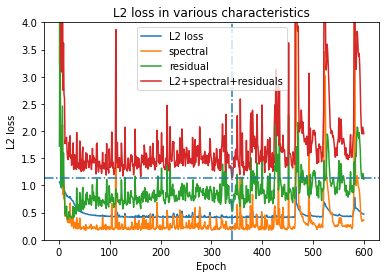

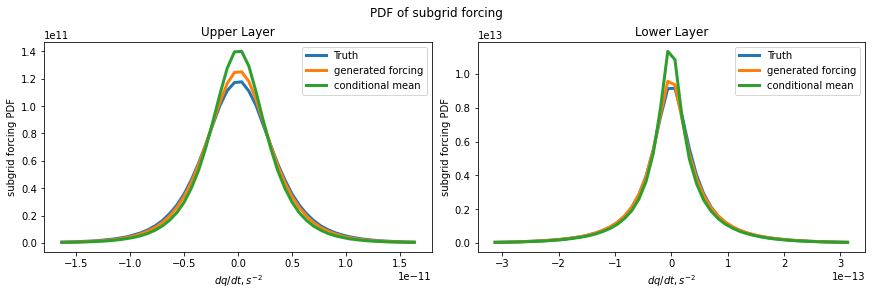

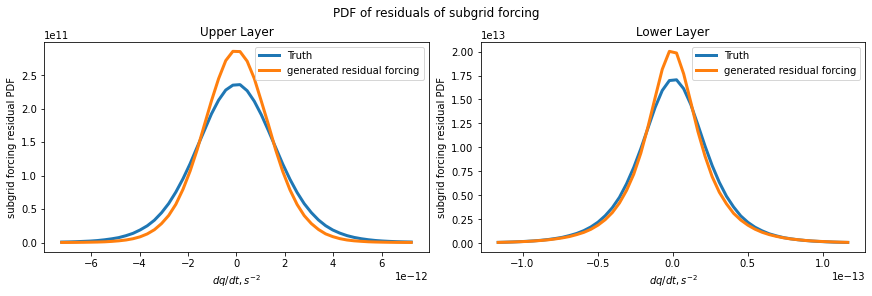

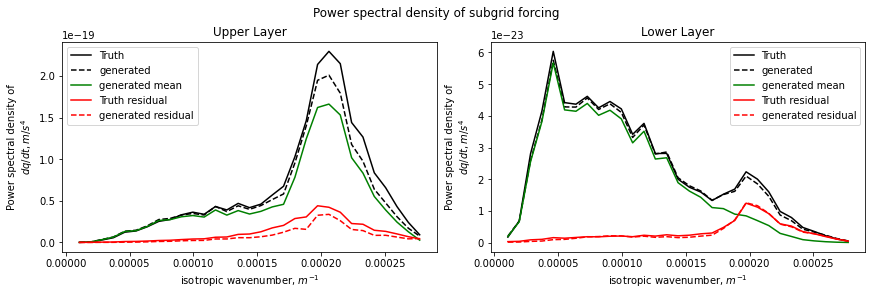

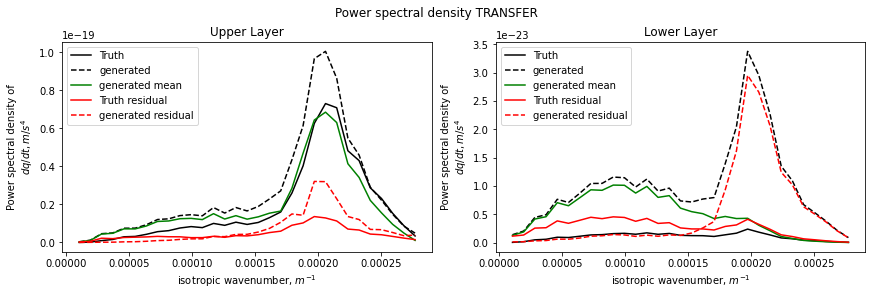

...

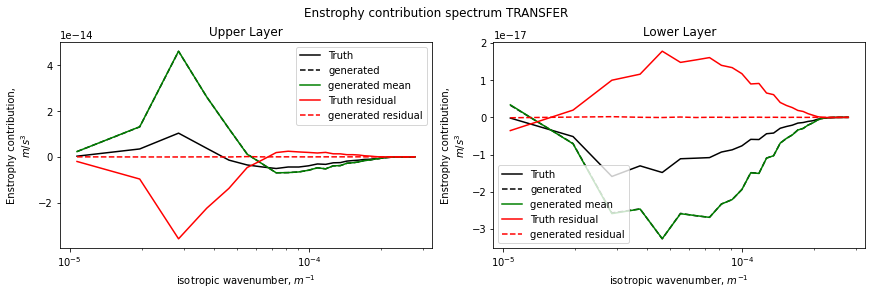

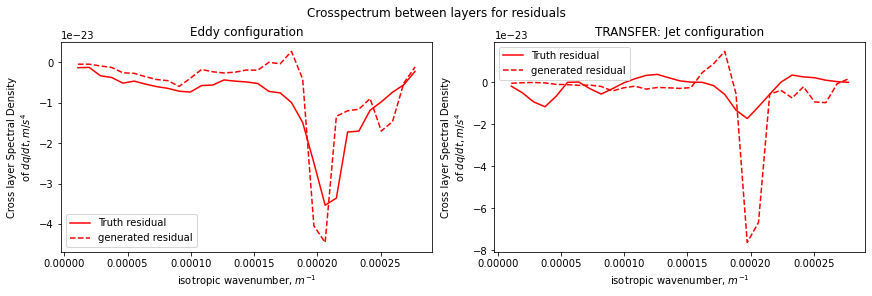

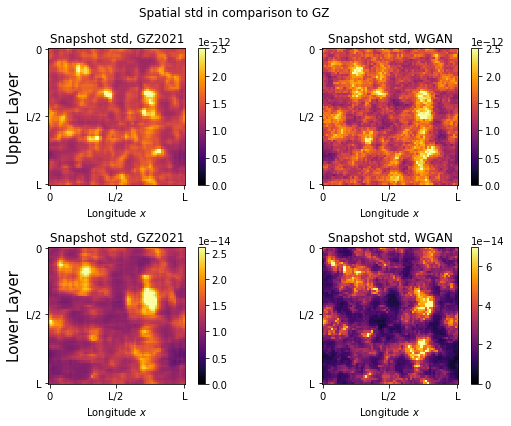

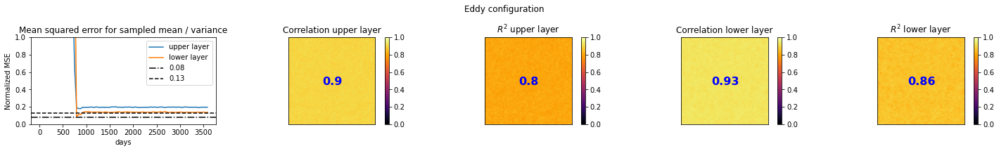

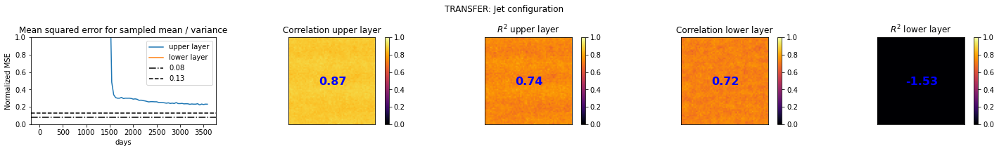

In [28]:
overview_experiment('EXP1')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'LayerNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.436,0.427,1.072]
   L2_q:       [0.147,0.145,11.790]
        L2_dq: [0.481,0.518,3.775]
L2+L2_q+L2_dq: [1.065,1.090,16.638]


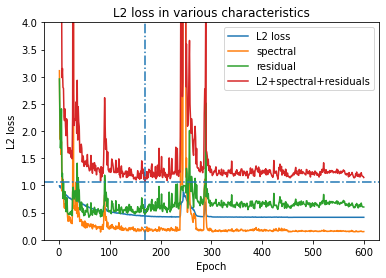

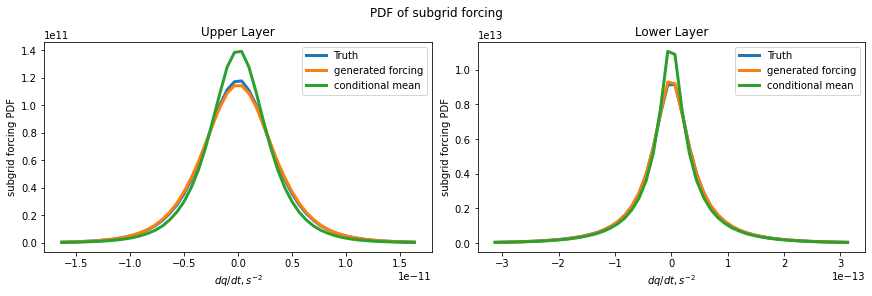

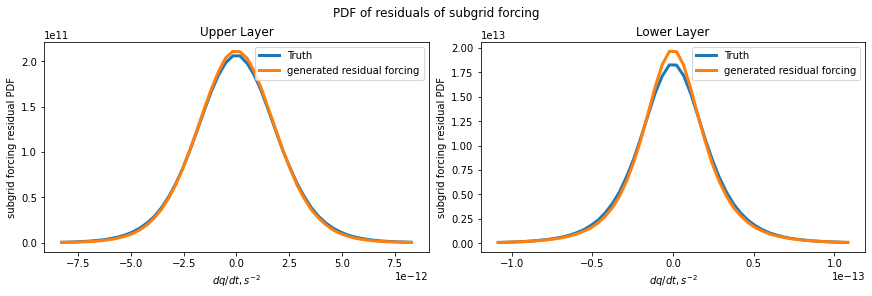

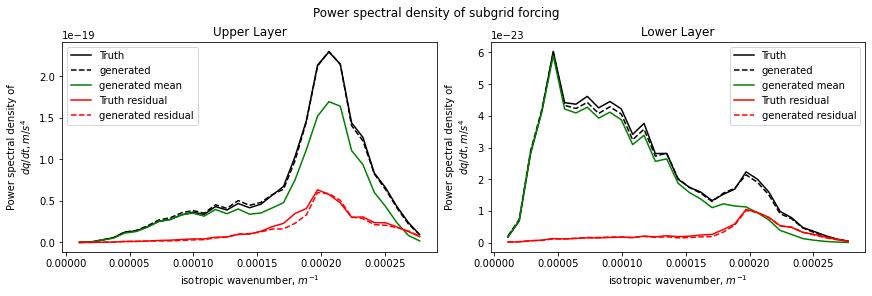

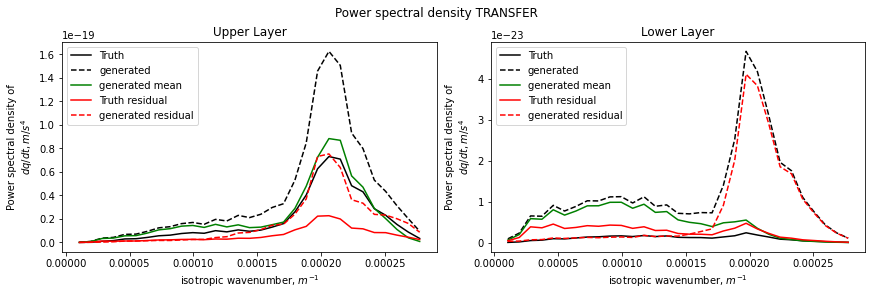

...

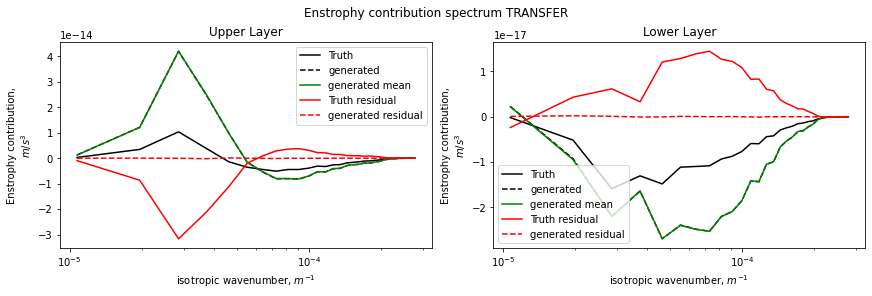

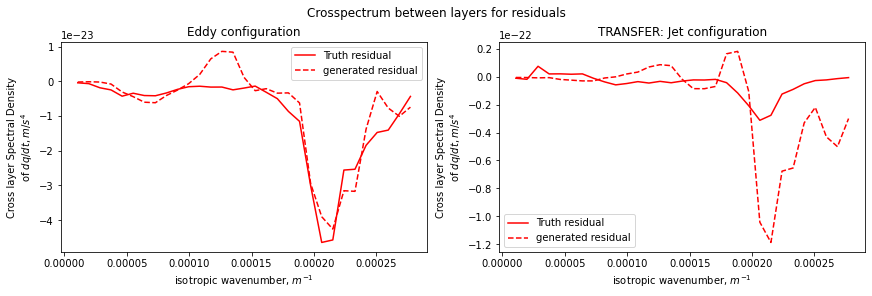

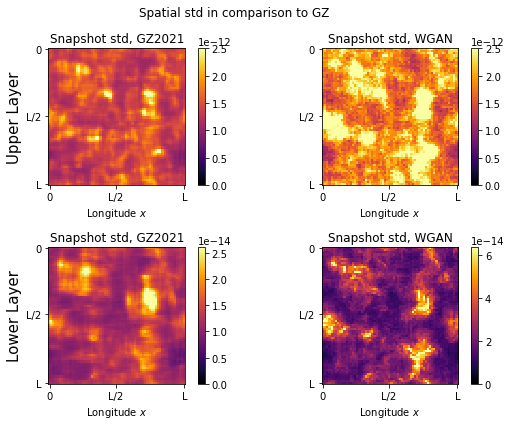

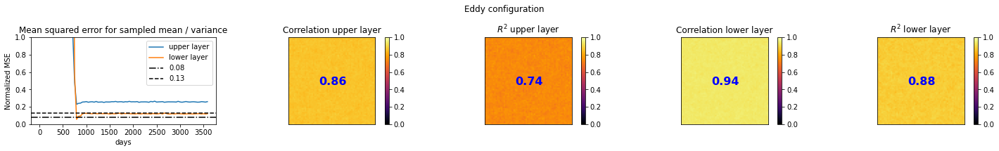

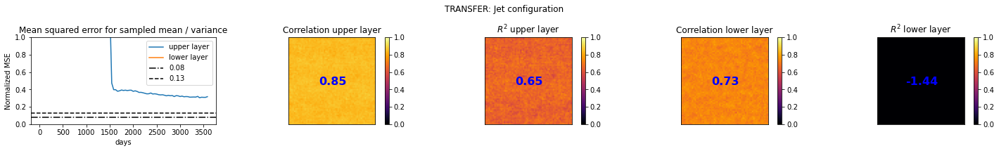

In [29]:
overview_experiment('EXP2')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'InstanceNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.517,0.506,1.321]
   L2_q:       [0.166,0.167,15.291]
        L2_dq: [0.452,0.483,2.056]
L2+L2_q+L2_dq: [1.136,1.156,18.667]


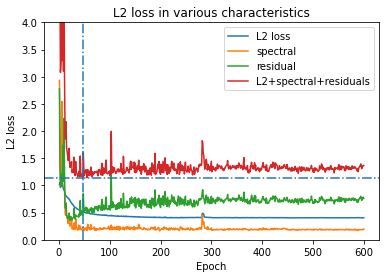

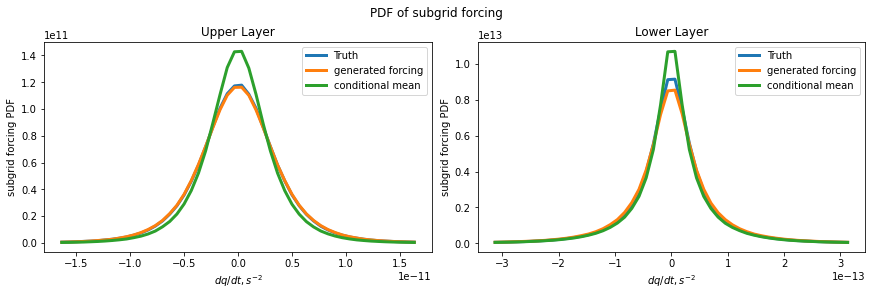

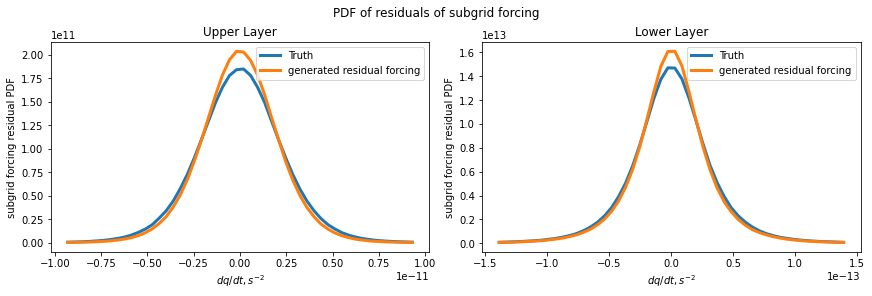

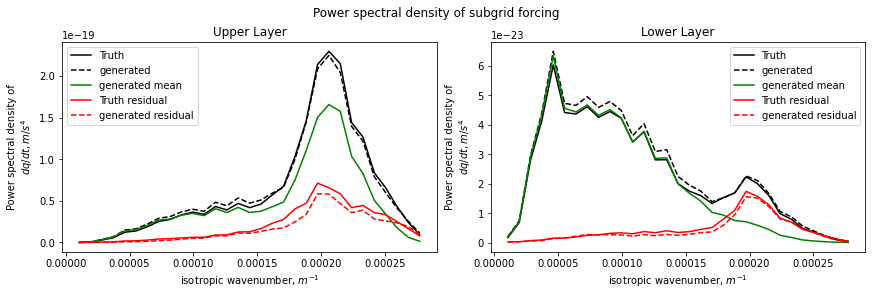

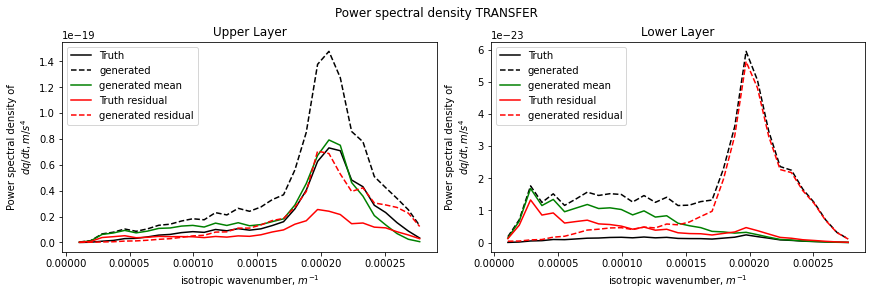

...

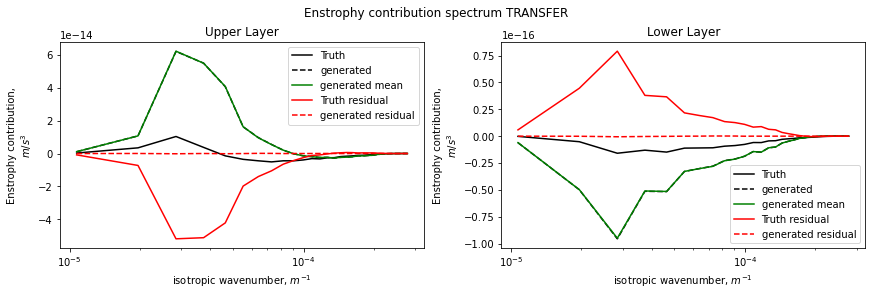

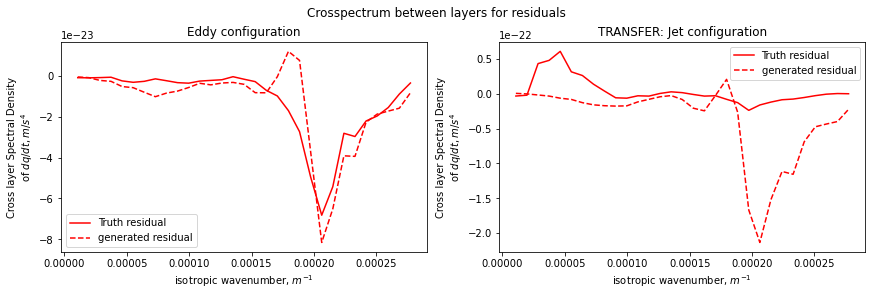

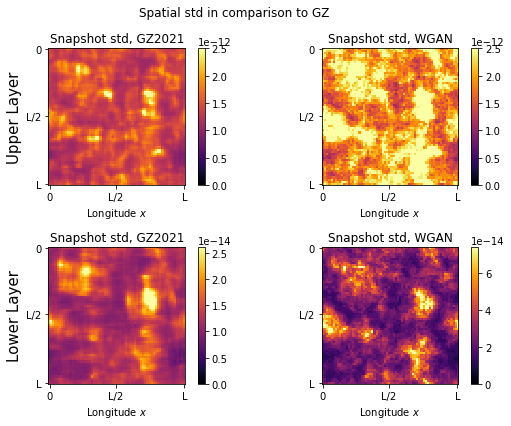

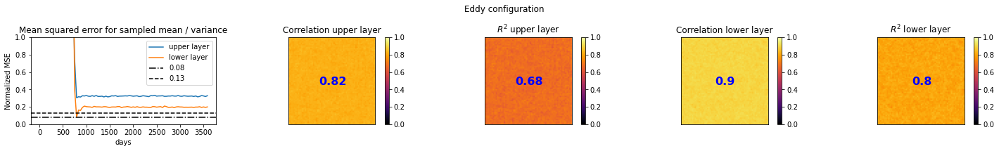

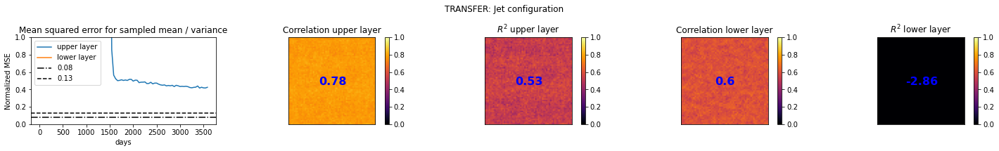

In [30]:
overview_experiment('EXP3')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.375,0.367,1.060]
   L2_q:       [0.147,0.149,6.494]
        L2_dq: [0.575,0.639,2.410]
L2+L2_q+L2_dq: [1.097,1.155,9.964]


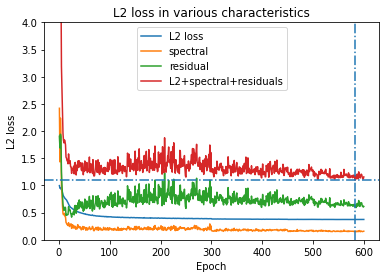

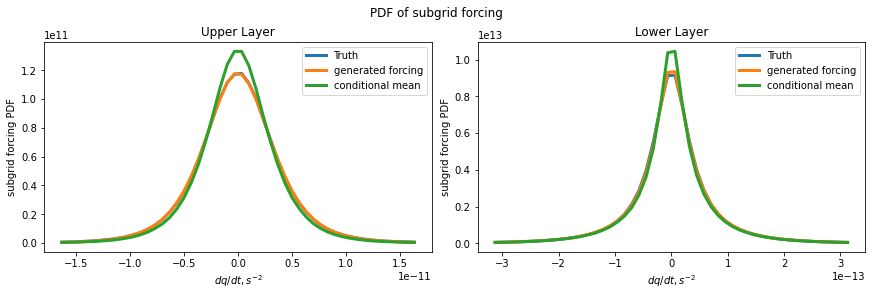

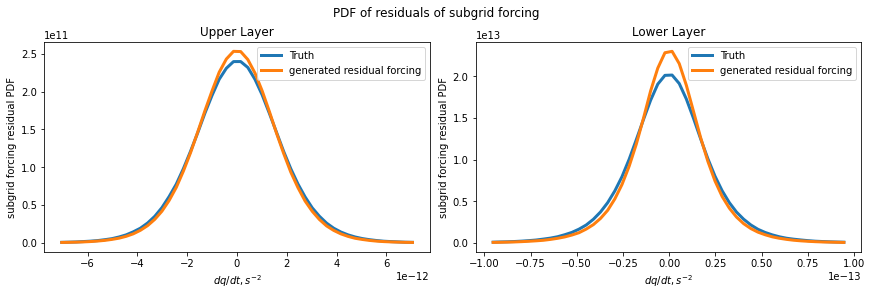

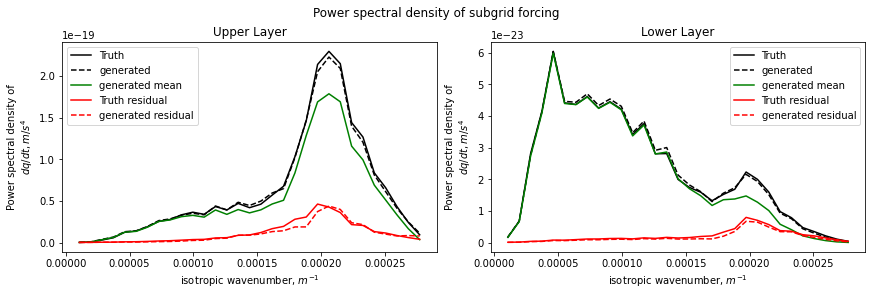

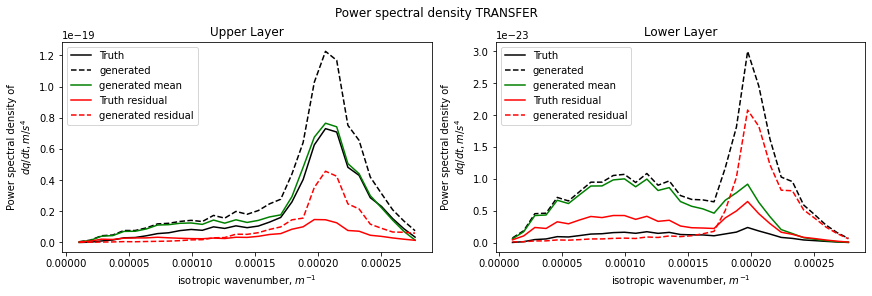

...

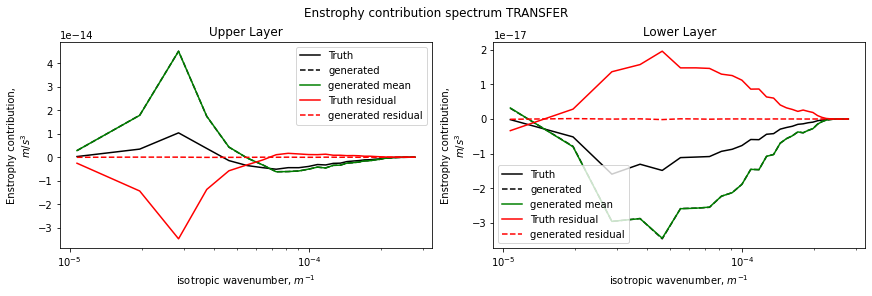

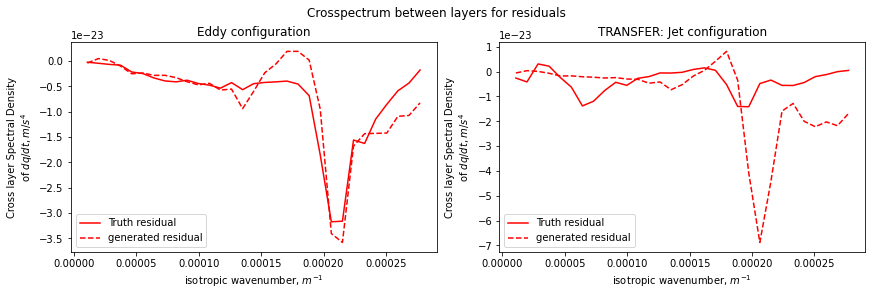

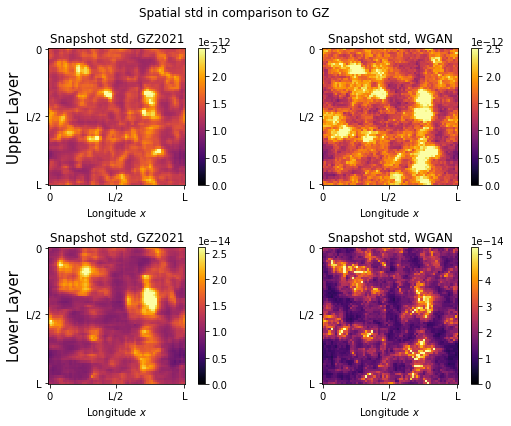

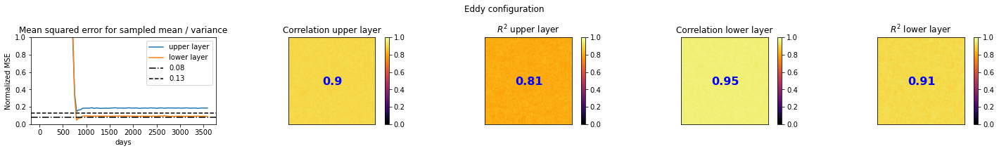

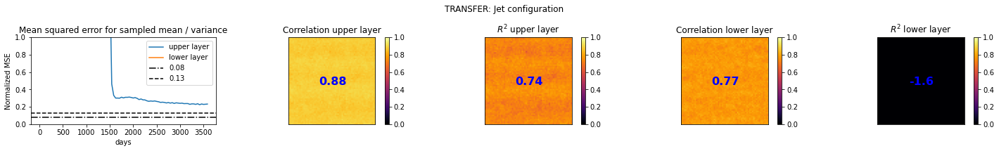

In [31]:
overview_experiment('EXP4')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'DeepInversion', 'discriminator': 'DCGAN', 'bn': 'BatchNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.338,0.330,0.977]
   L2_q:       [0.070,0.070,4.603]
        L2_dq: [0.481,0.501,0.717]
L2+L2_q+L2_dq: [0.888,0.901,6.297]


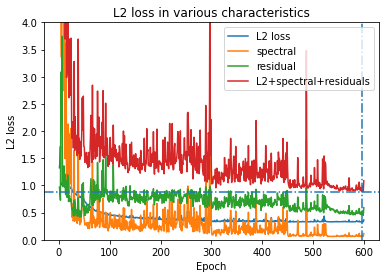

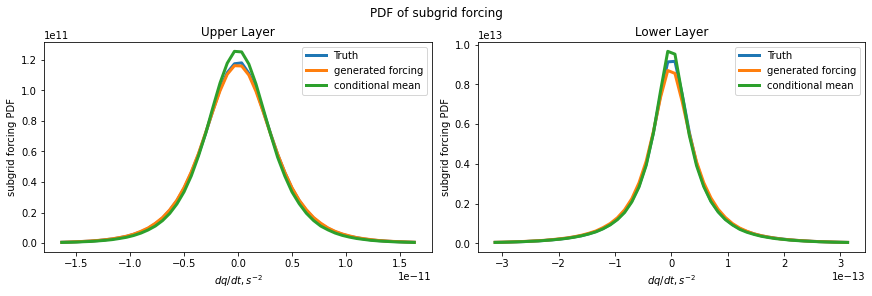

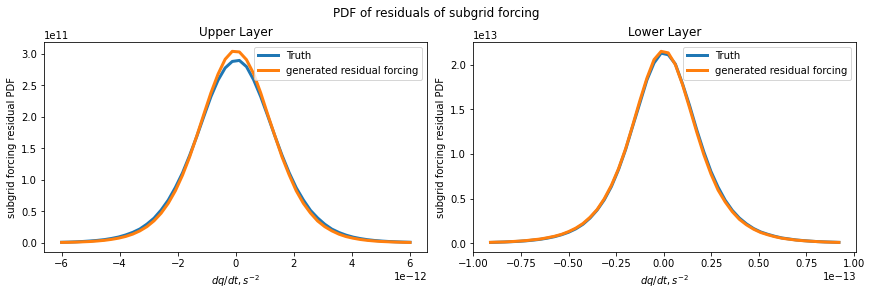

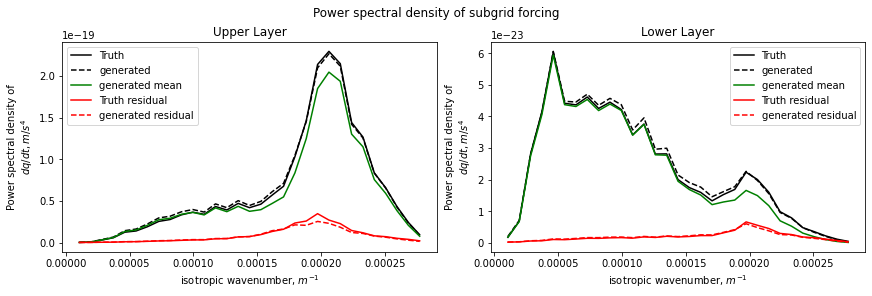

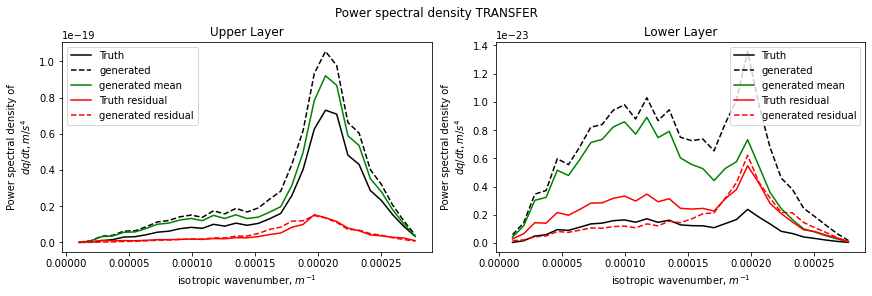

...

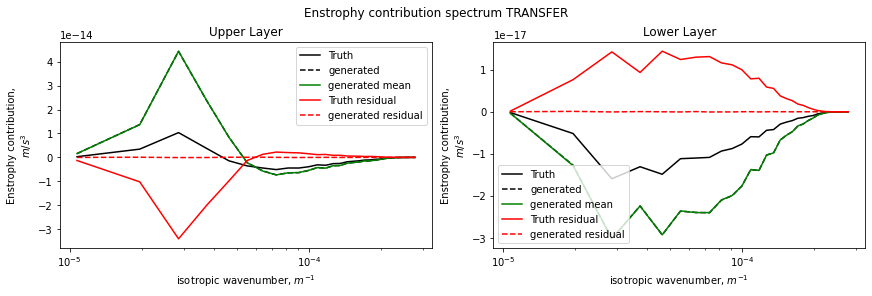

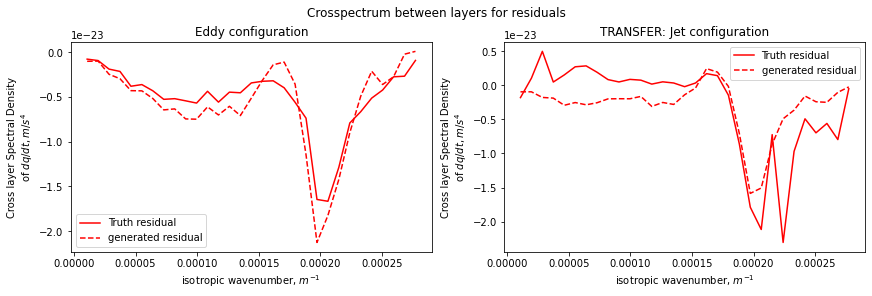

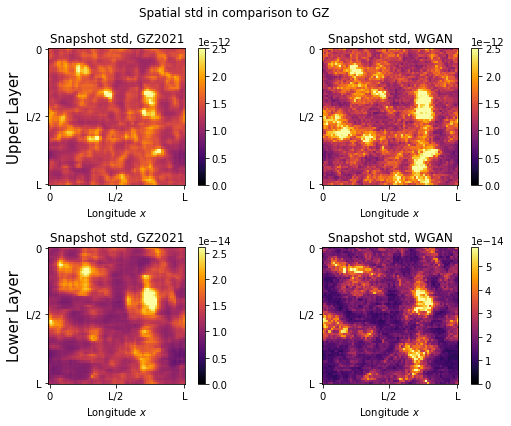

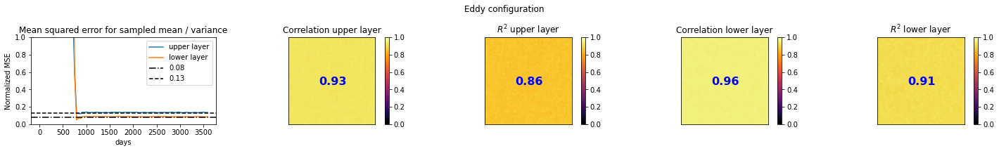

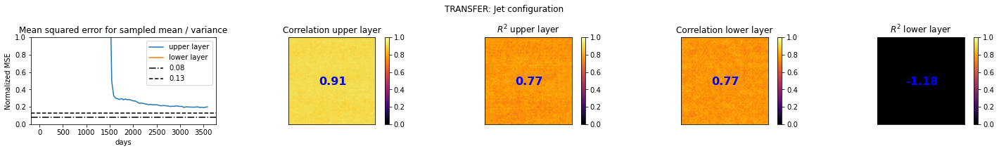

In [32]:
overview_experiment('EXP5')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'DeepInversion', 'discriminator': 'DCGAN', 'bn': 'LayerNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.454,0.444,1.424]
   L2_q:       [0.164,0.161,51.853]
        L2_dq: [0.550,0.595,1.066]
L2+L2_q+L2_dq: [1.167,1.201,54.344]


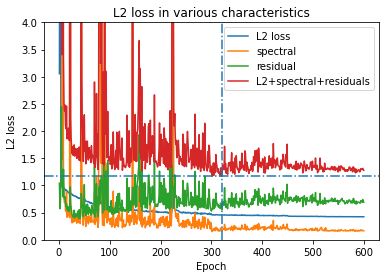

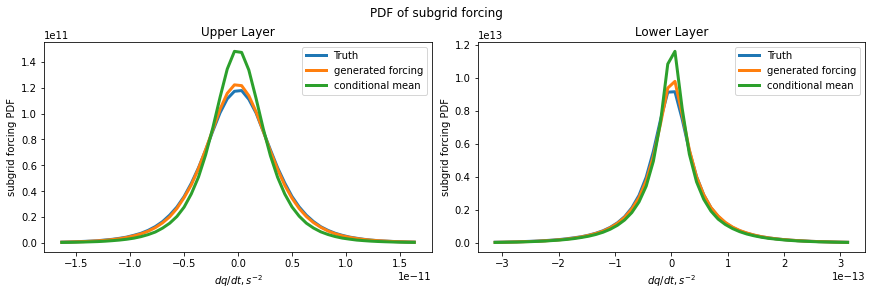

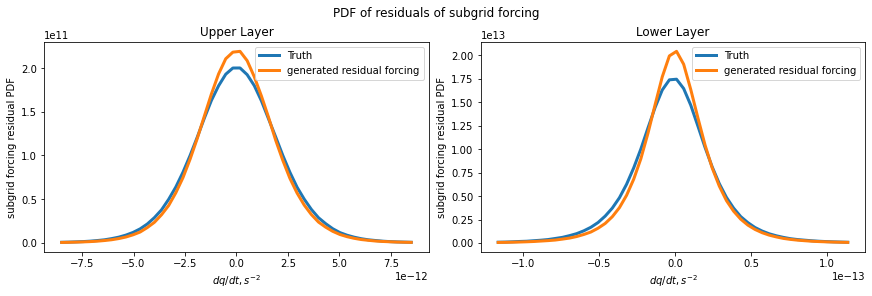

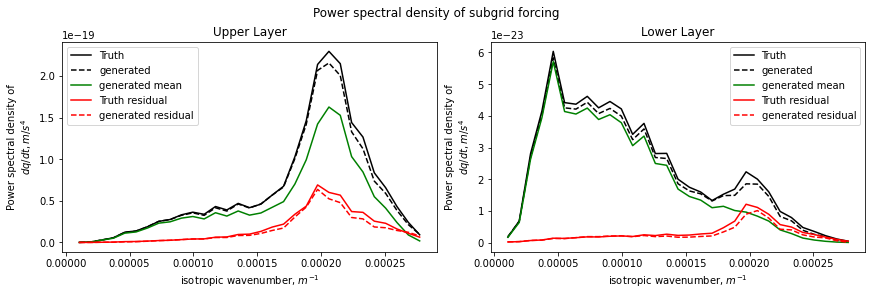

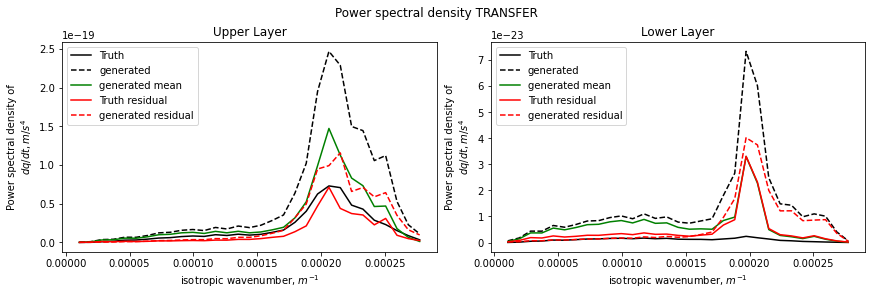

...

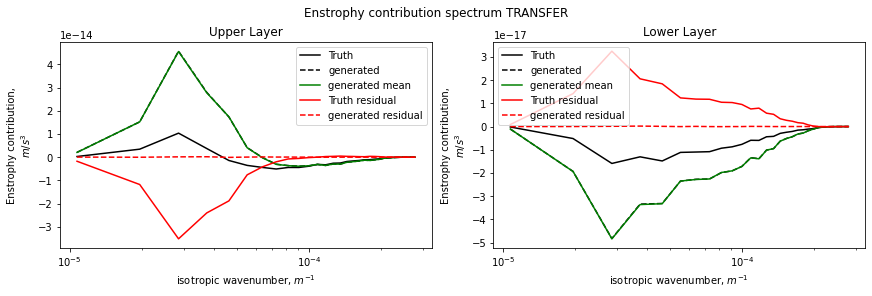

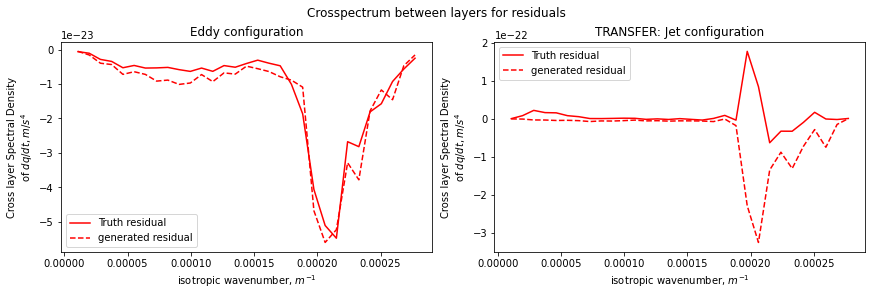

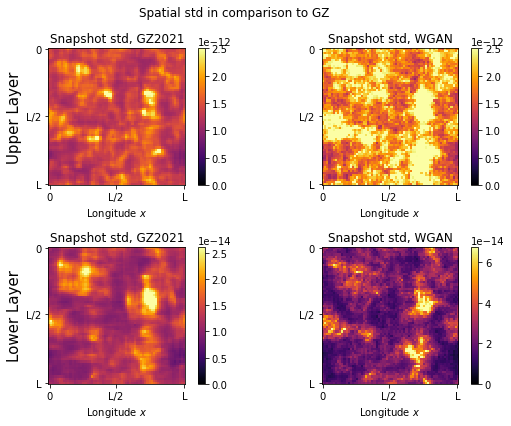

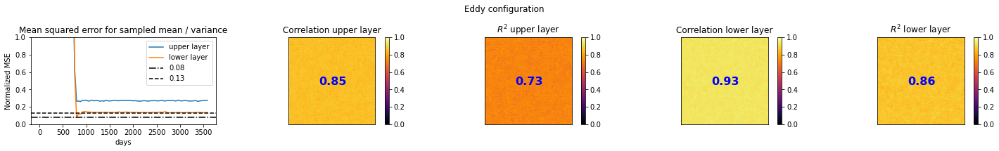

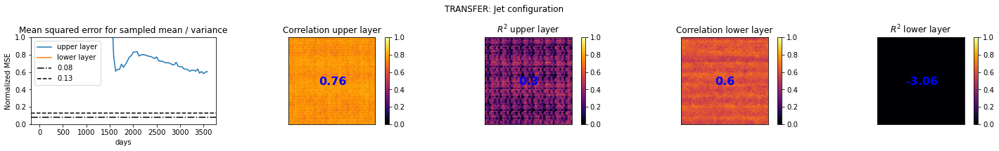

In [33]:
overview_experiment('EXP6')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'DeepInversion', 'discriminator': 'DCGAN', 'bn': 'InstanceNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.323,0.316,0.932]
   L2_q:       [0.173,0.174,4.863]
        L2_dq: [0.840,1.023,1.166]
L2+L2_q+L2_dq: [1.335,1.513,6.962]


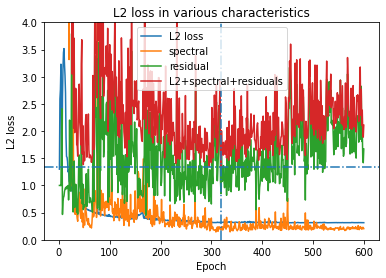

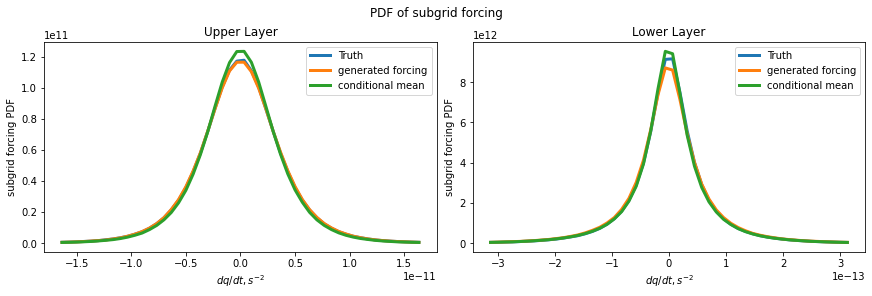

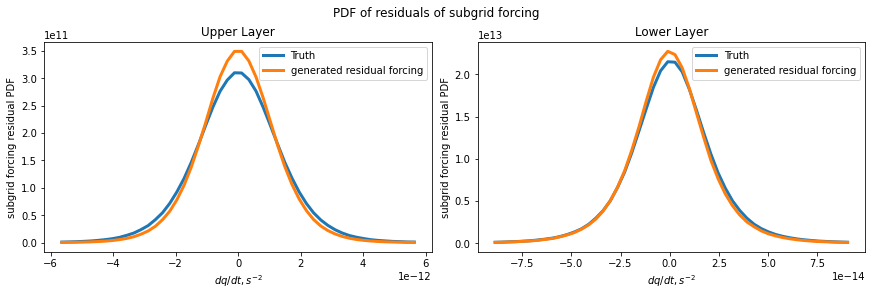

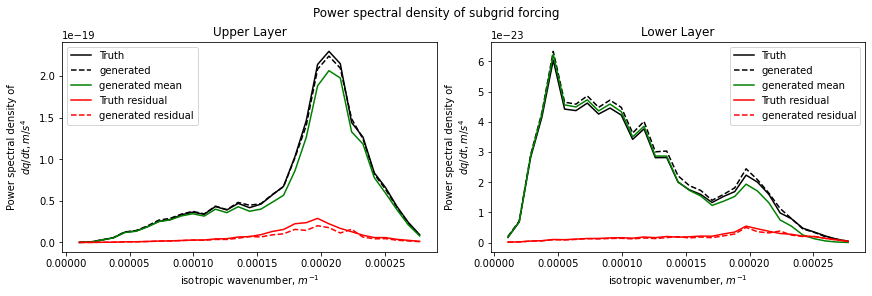

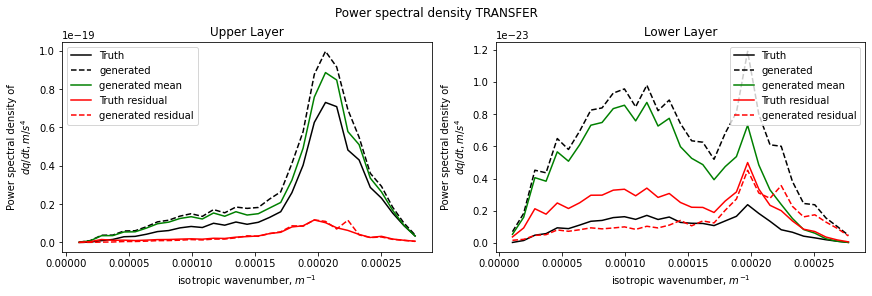

...

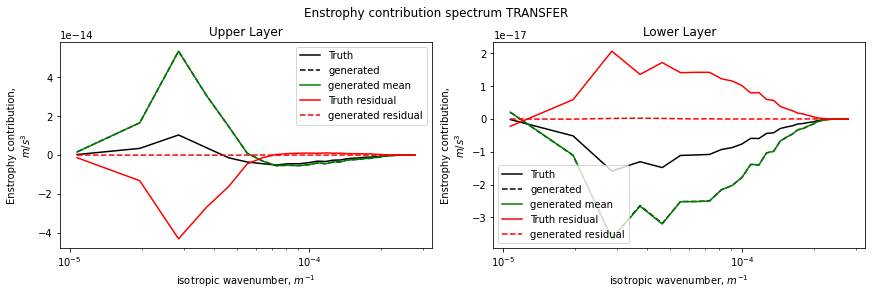

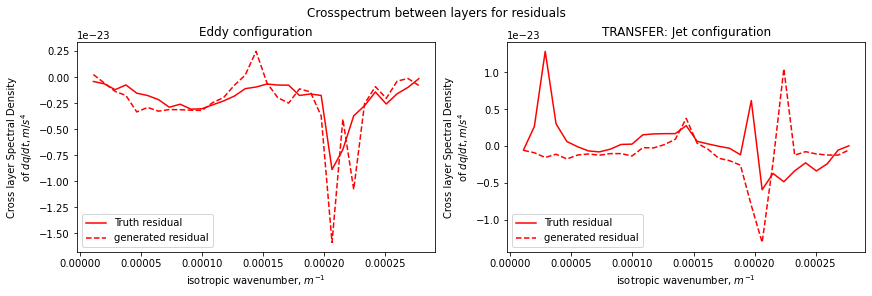

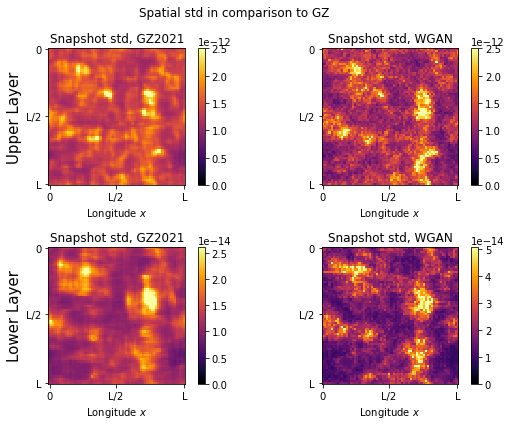

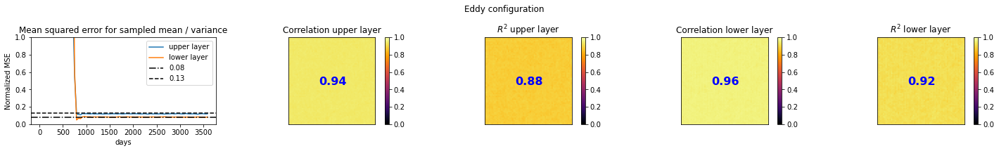

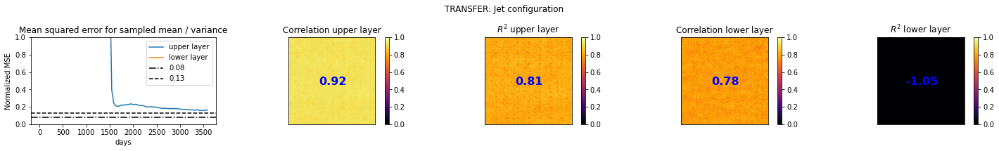

In [34]:
overview_experiment('EXP7')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'DeepInversion', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.327,0.320,0.959]
   L2_q:       [0.109,0.112,3.833]
        L2_dq: [0.709,0.759,0.719]
L2+L2_q+L2_dq: [1.145,1.191,5.511]


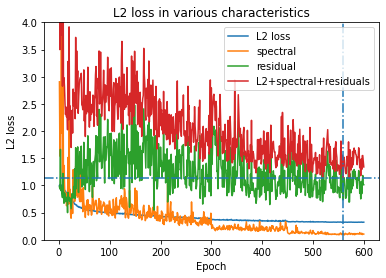

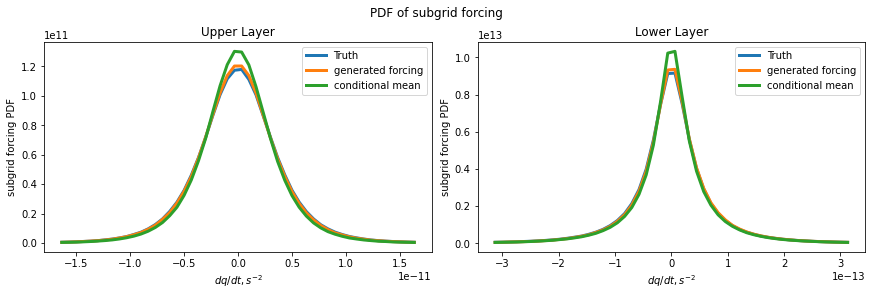

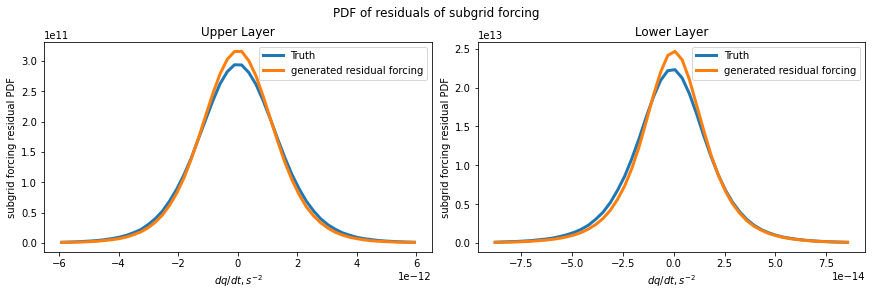

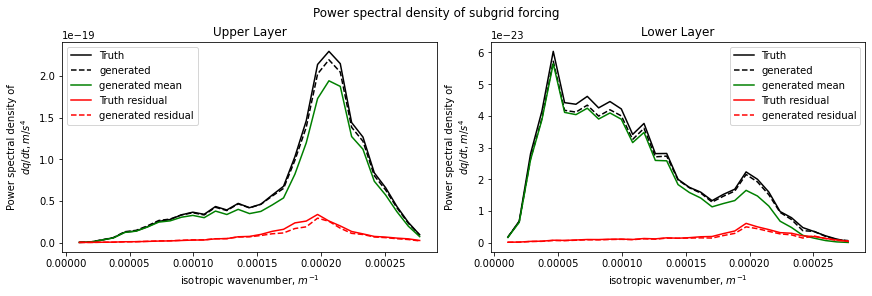

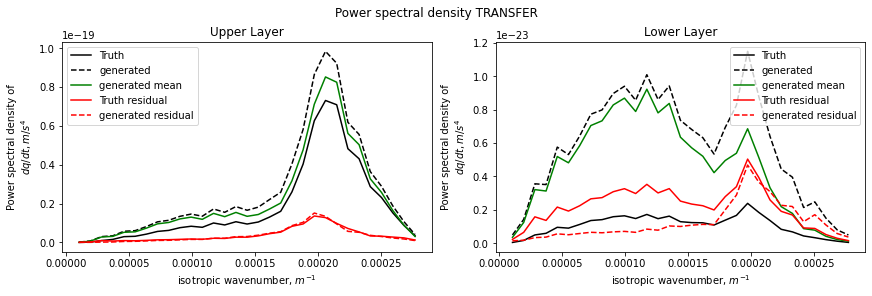

...

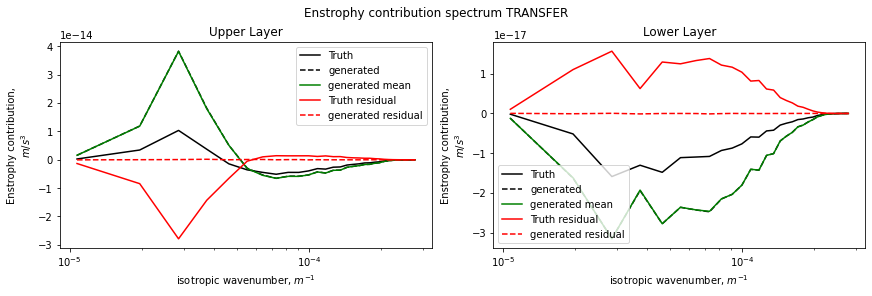

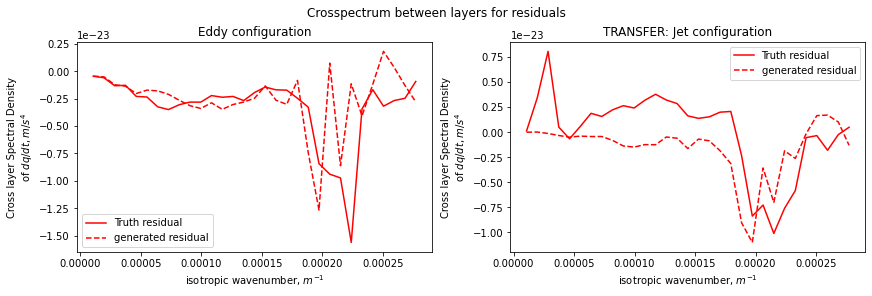

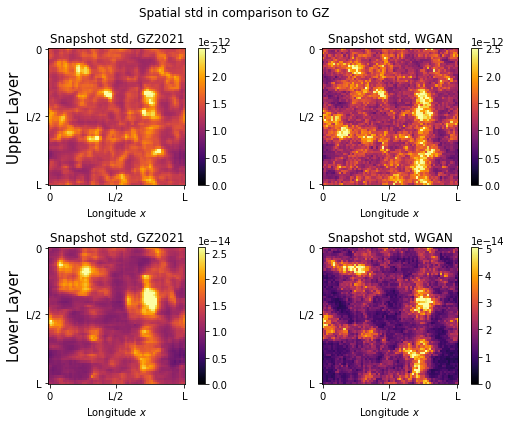

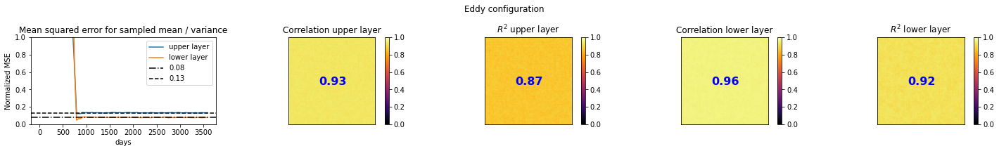

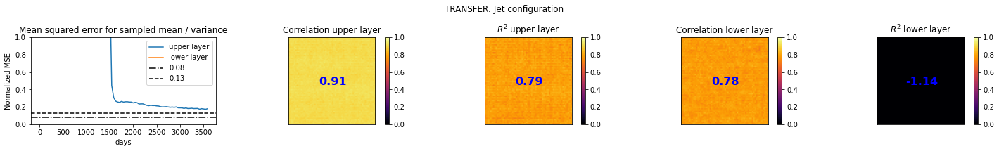

In [35]:
overview_experiment('EXP8')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DeepInversion', 'bn': 'BatchNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.403,0.395,1.075]
   L2_q:       [0.153,0.154,12.784]
        L2_dq: [0.499,0.540,4.185]
L2+L2_q+L2_dq: [1.056,1.088,18.044]


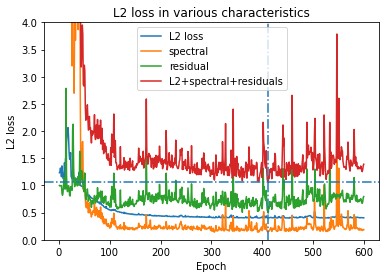

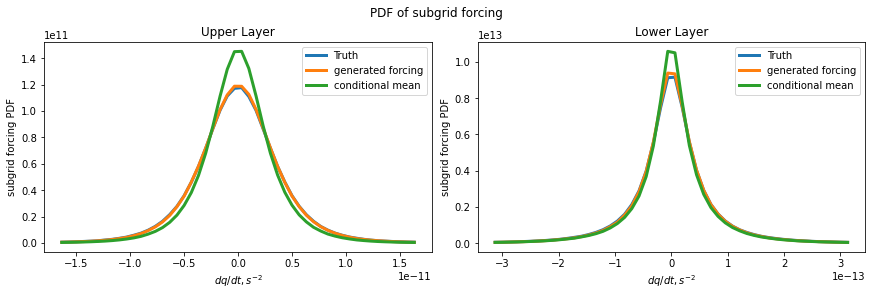

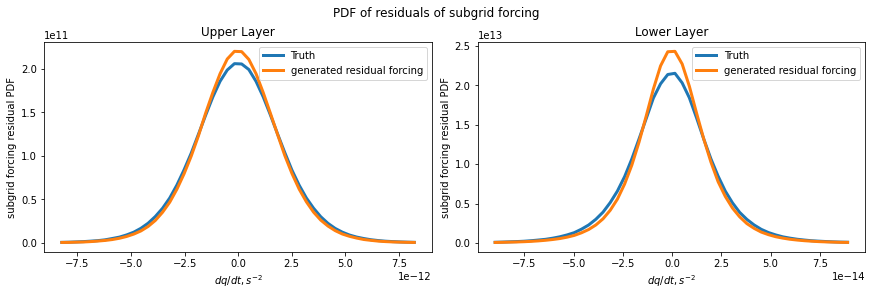

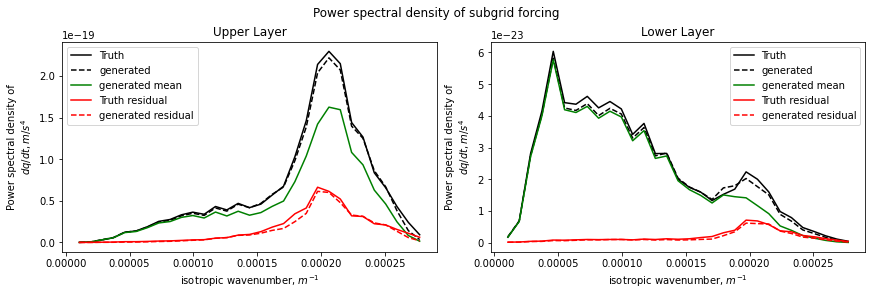

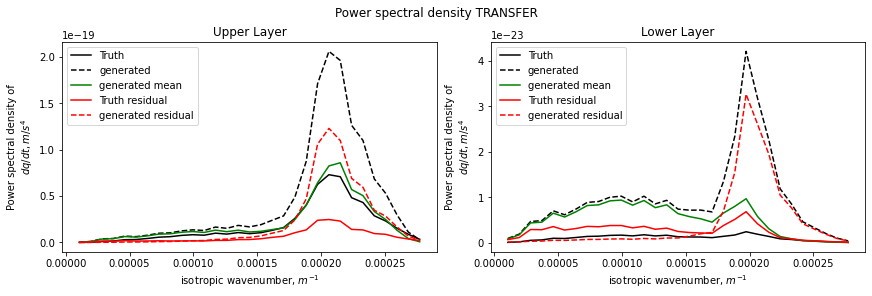

...

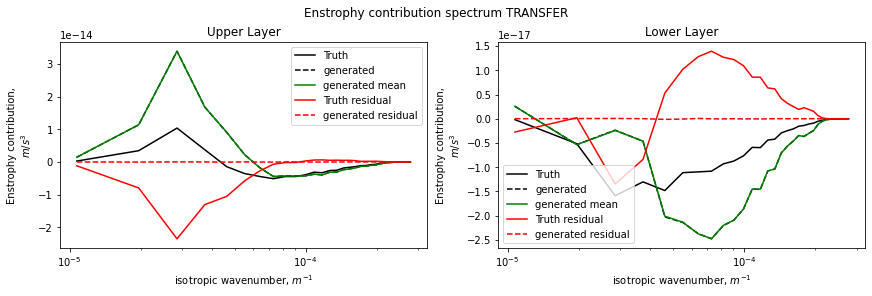

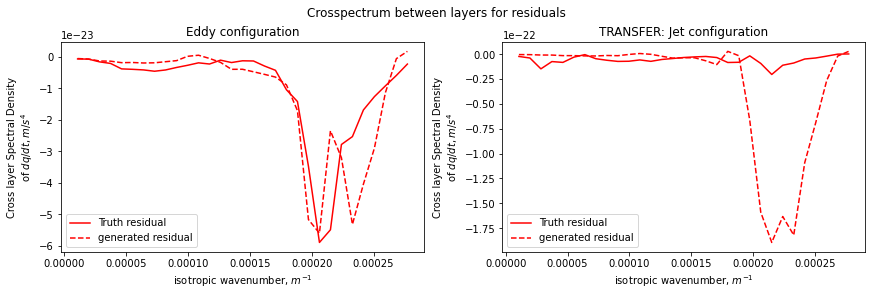

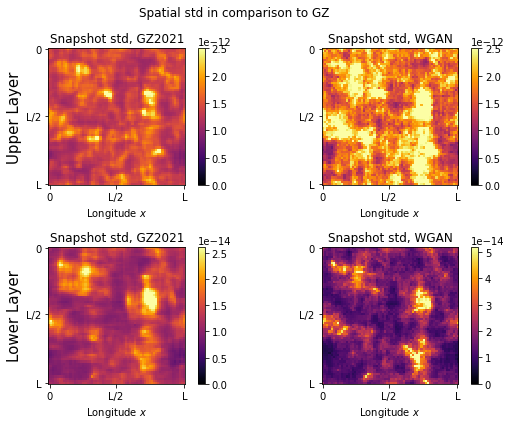

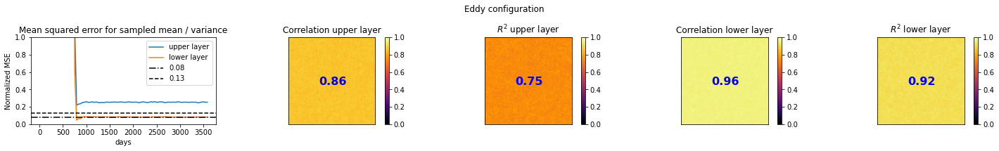

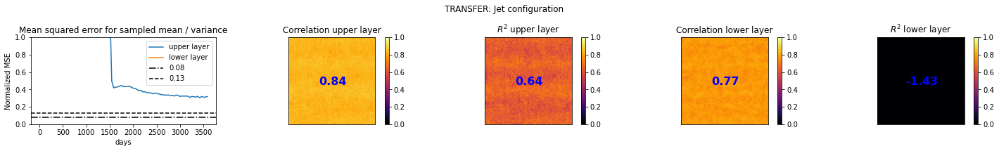

In [36]:
overview_experiment('EXP9')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DeepInversion', 'bn': 'LayerNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.404,0.394,1.100]
   L2_q:       [0.150,0.146,14.796]
        L2_dq: [0.614,0.672,4.355]
L2+L2_q+L2_dq: [1.168,1.213,20.251]


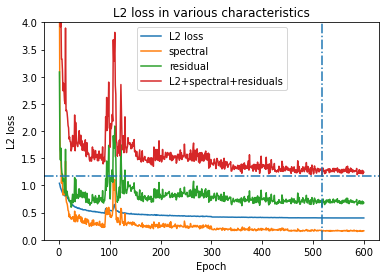

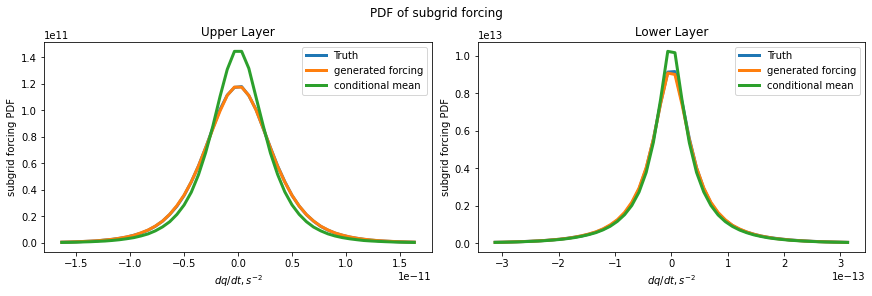

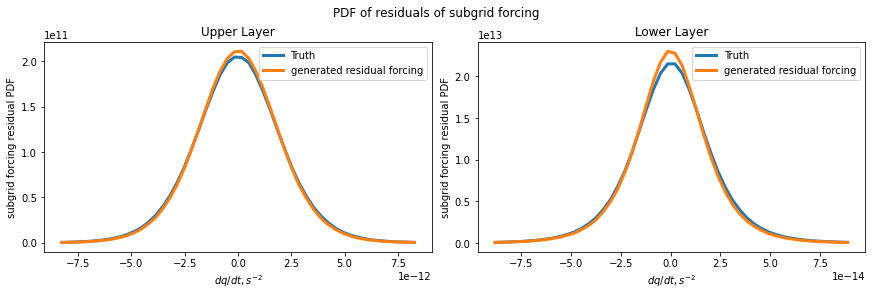

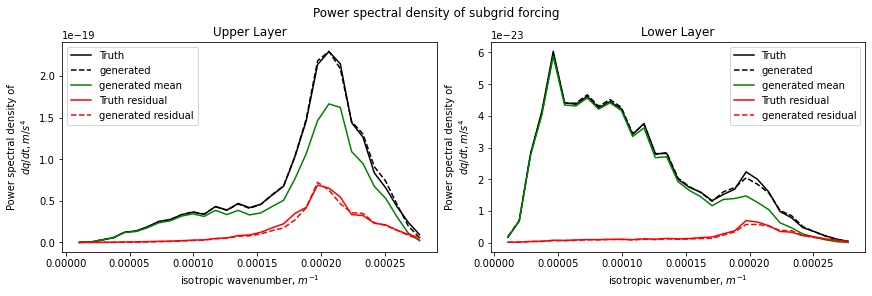

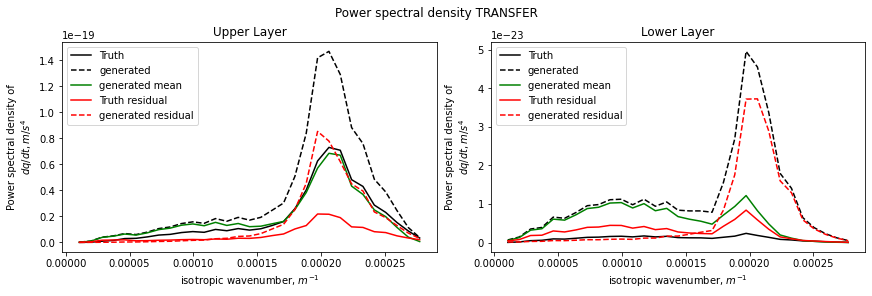

...

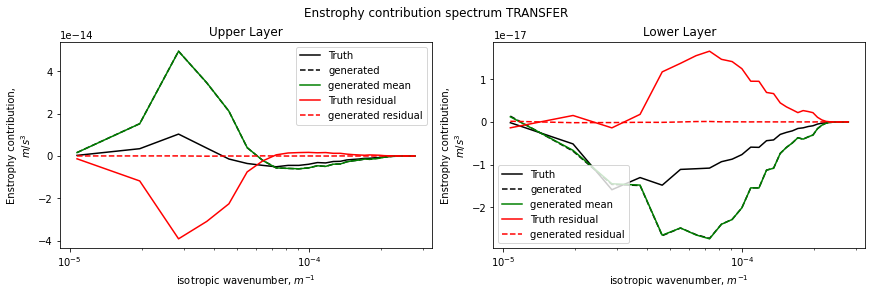

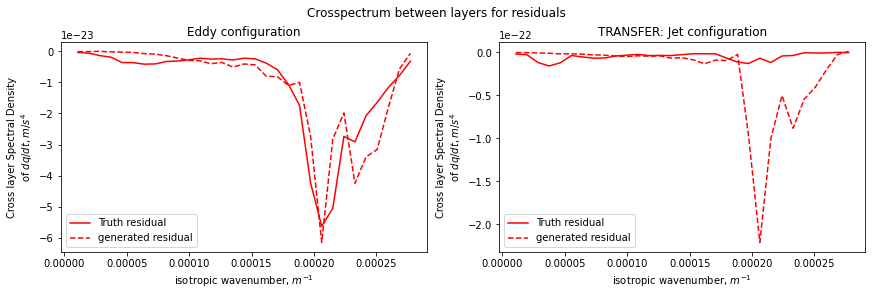

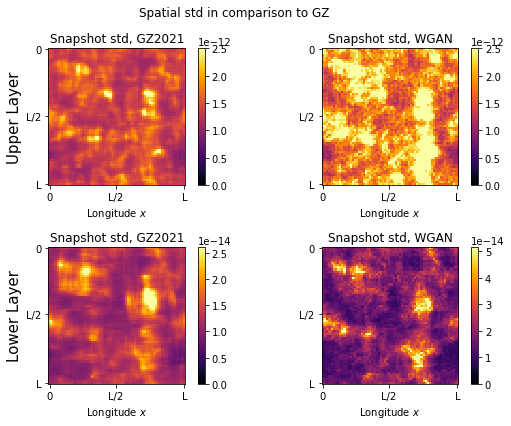

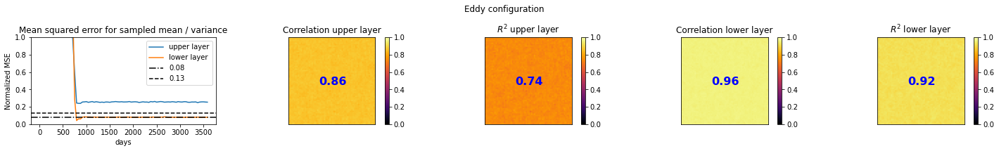

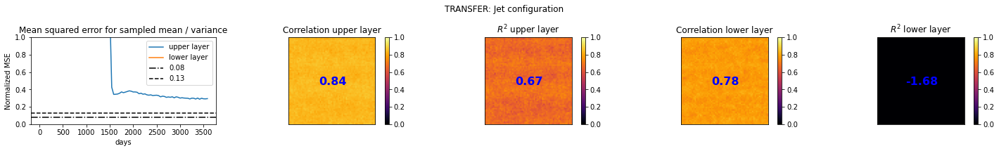

In [37]:
overview_experiment('EXP10')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DeepInversion', 'bn': 'InstanceNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.423,0.413,1.079]
   L2_q:       [0.193,0.197,11.465]
        L2_dq: [0.811,0.880,3.972]
L2+L2_q+L2_dq: [1.427,1.490,16.516]


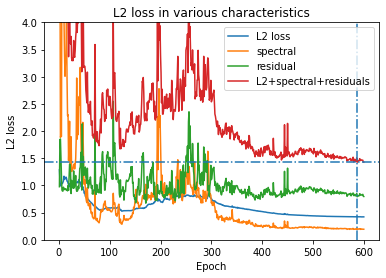

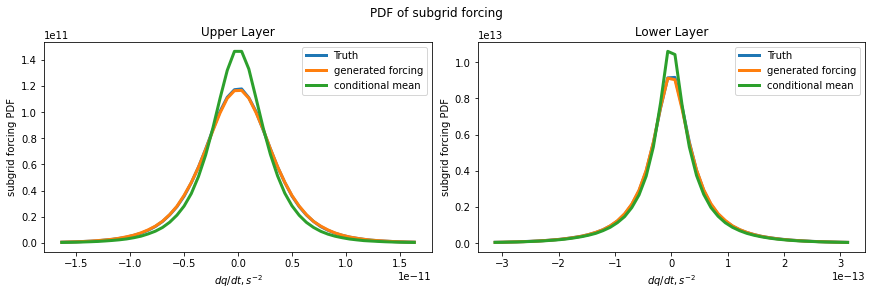

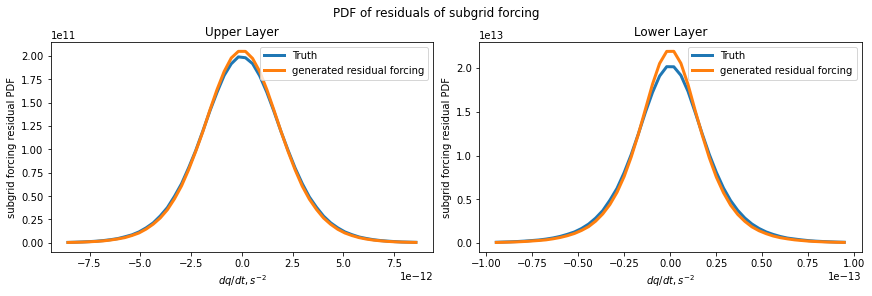

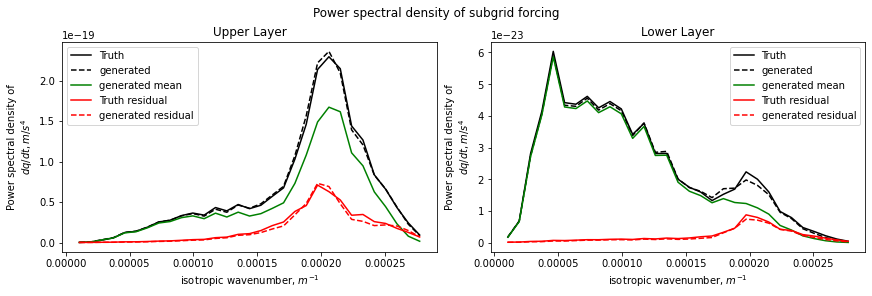

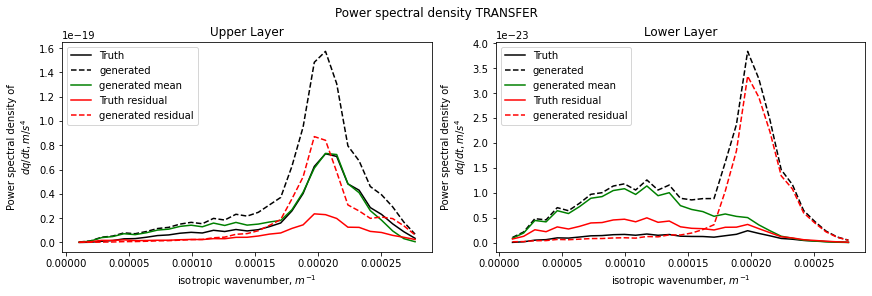

...

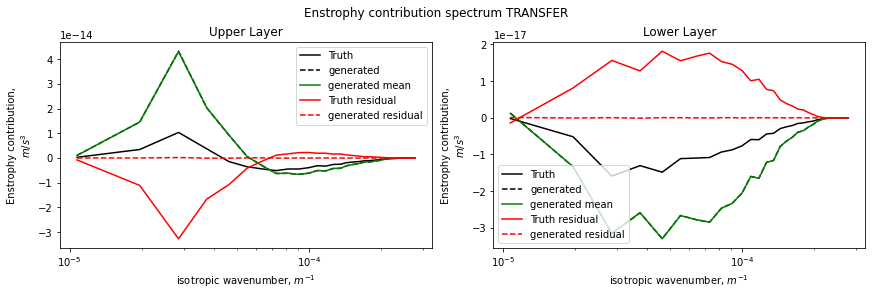

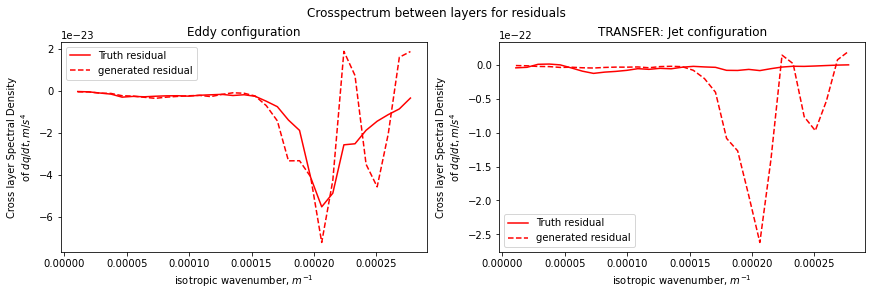

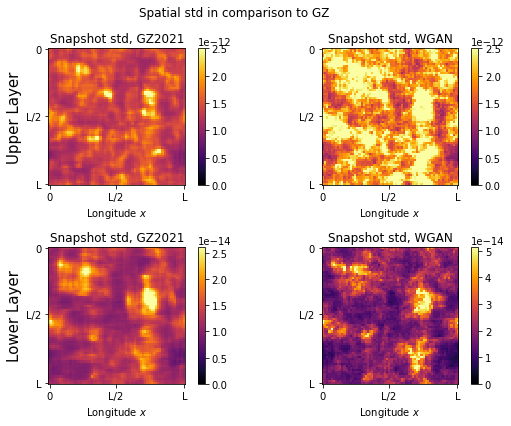

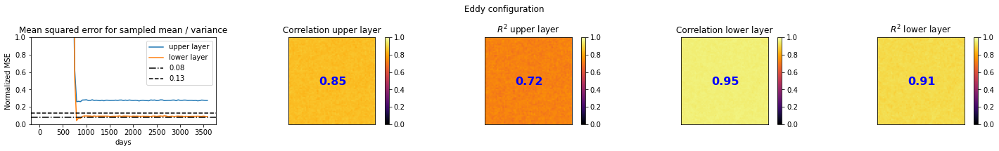

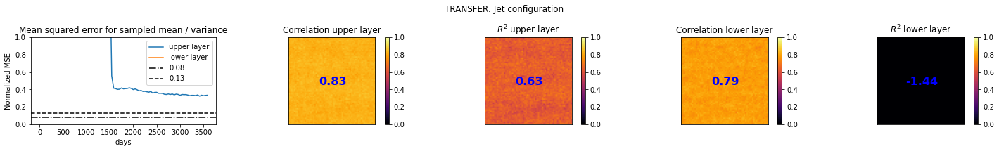

In [38]:
overview_experiment('EXP11')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DeepInversion', 'bn': 'None', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.388,0.379,1.004]
   L2_q:       [0.139,0.140,4.737]
        L2_dq: [0.656,0.723,2.542]
L2+L2_q+L2_dq: [1.183,1.242,8.284]


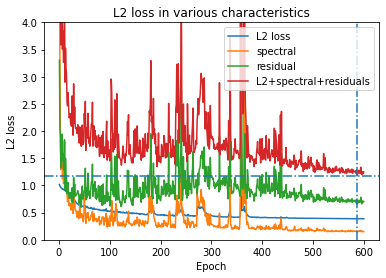

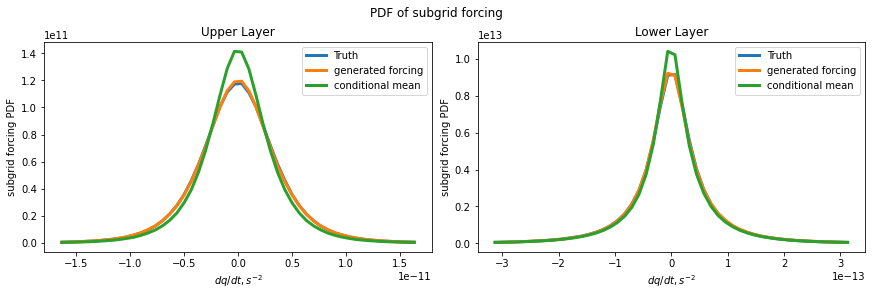

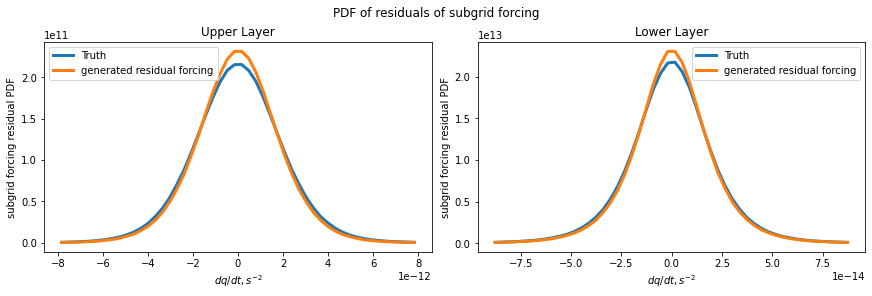

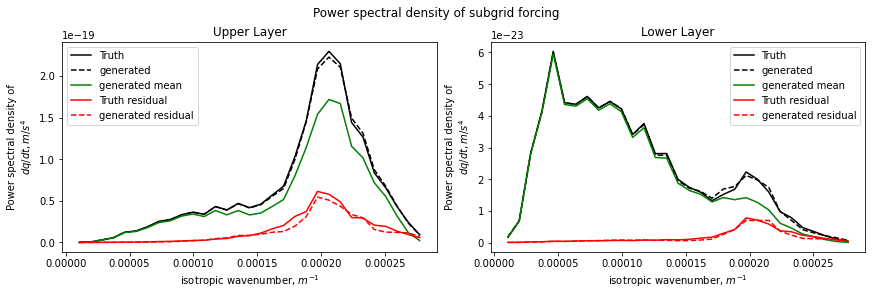

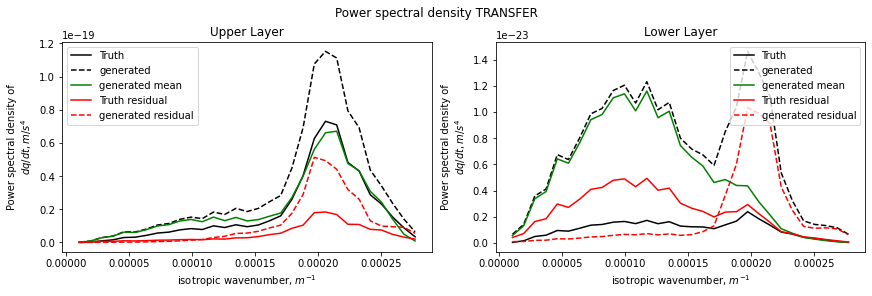

...

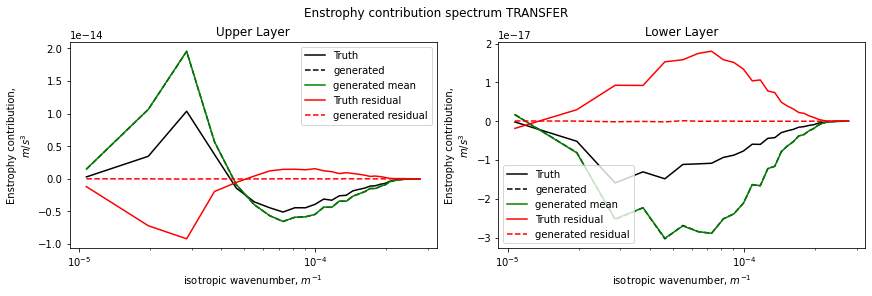

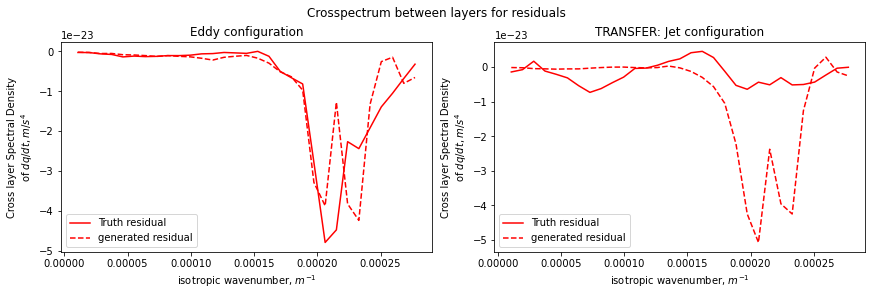

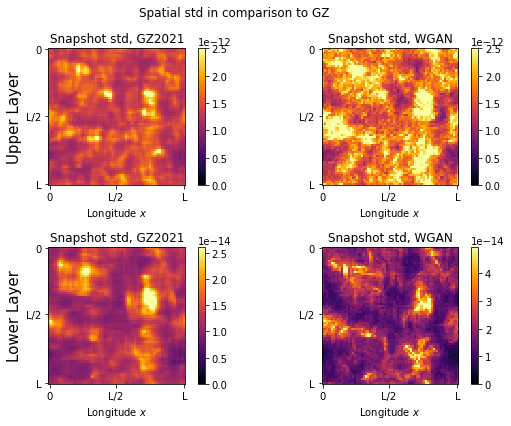

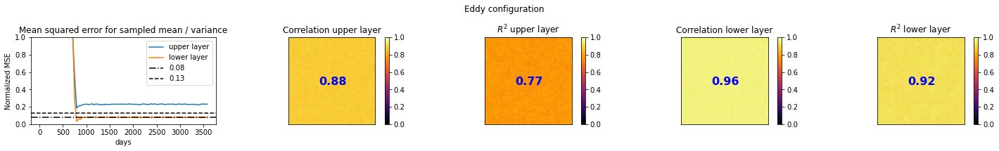

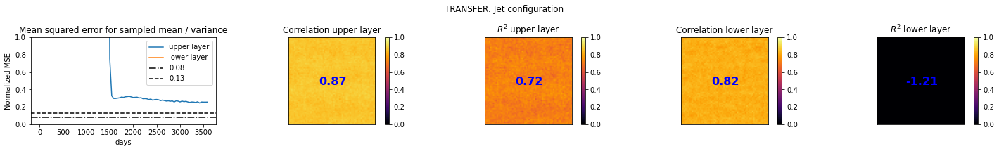

In [39]:
overview_experiment('EXP12')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'DeepInversion', 'discriminator': 'DeepInversion', 'bn': 'BatchNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.686,0.671,1.275]
   L2_q:       [0.302,0.308,14.226]
        L2_dq: [0.530,0.558,1.438]
L2+L2_q+L2_dq: [1.519,1.537,16.939]


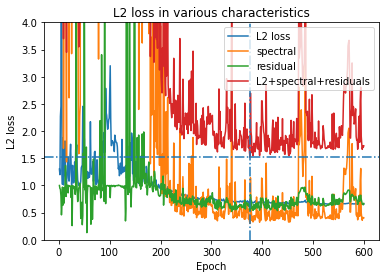

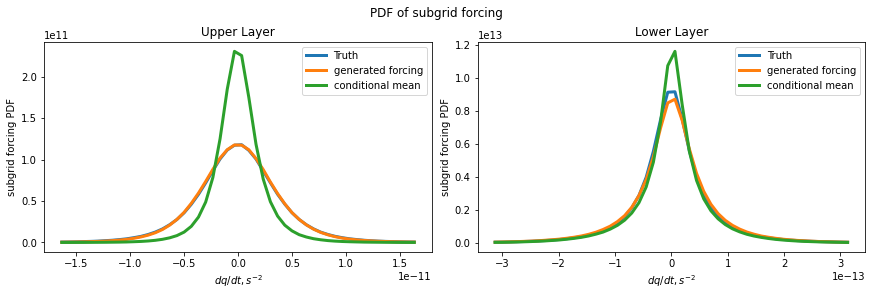

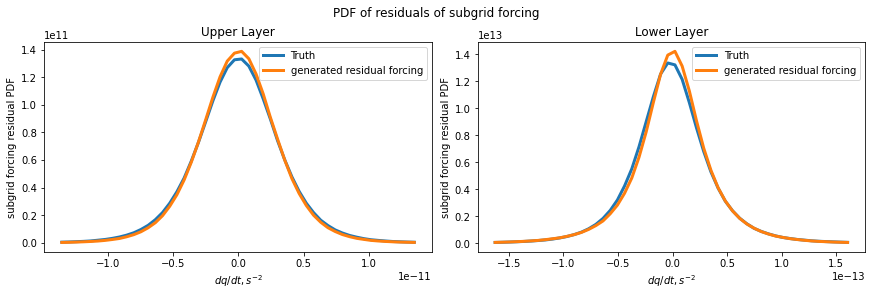

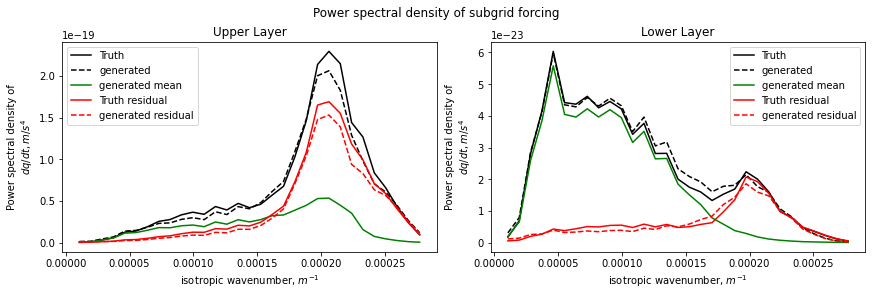

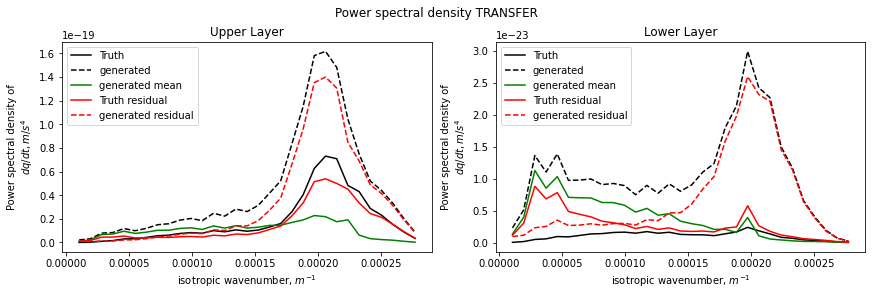

...

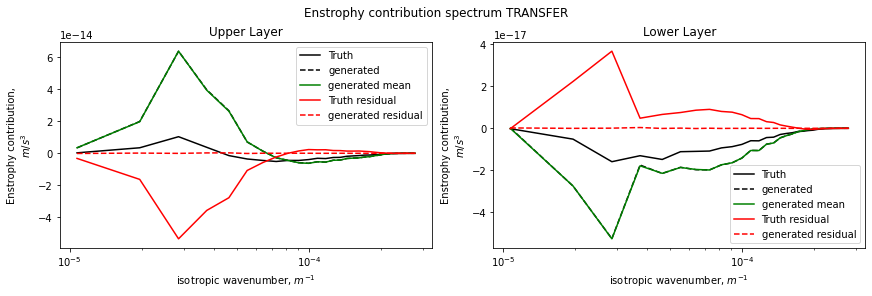

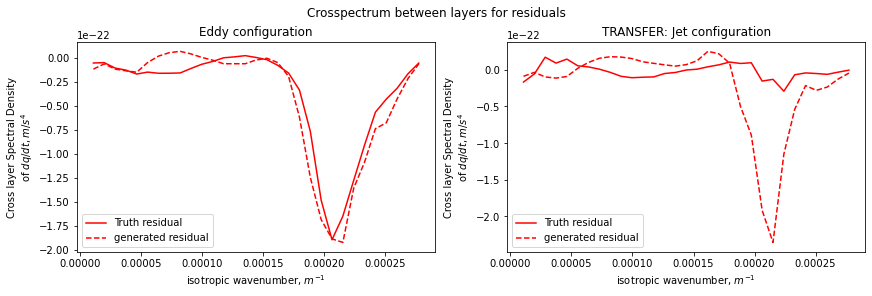

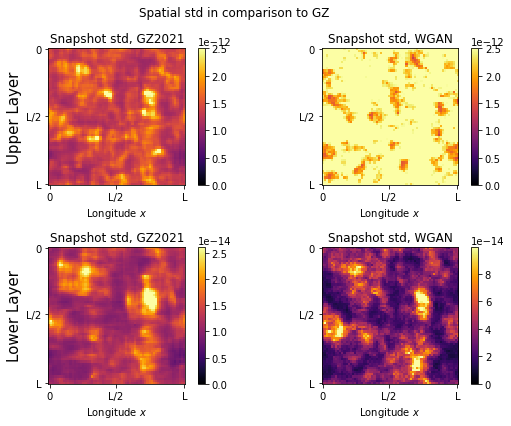

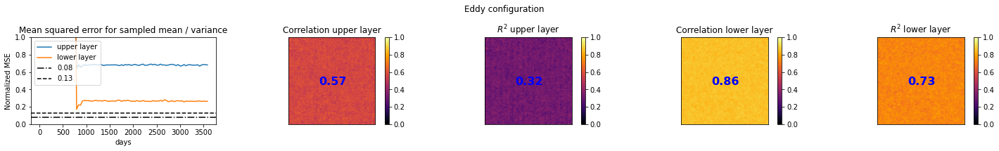

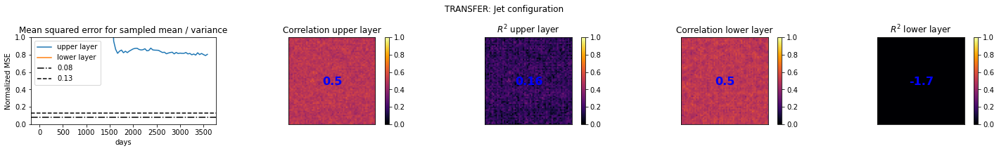

In [40]:
overview_experiment('EXP13')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'DeepInversion', 'discriminator': 'DeepInversion', 'bn': 'LayerNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.376,0.368,0.897]
   L2_q:       [0.266,0.266,6.421]
        L2_dq: [1.502,1.779,2.187]
L2+L2_q+L2_dq: [2.144,2.412,9.506]


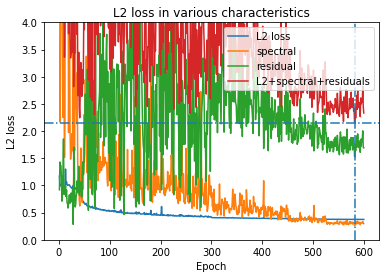

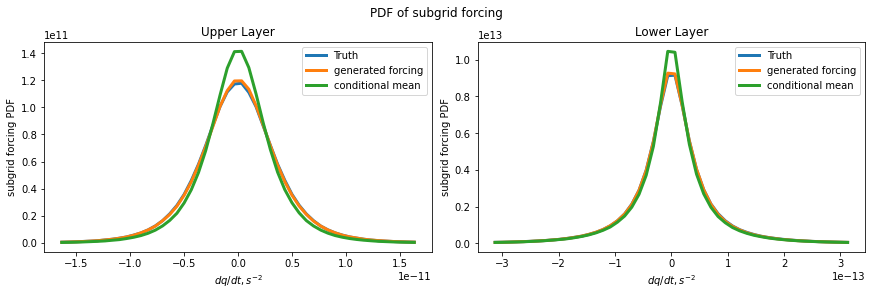

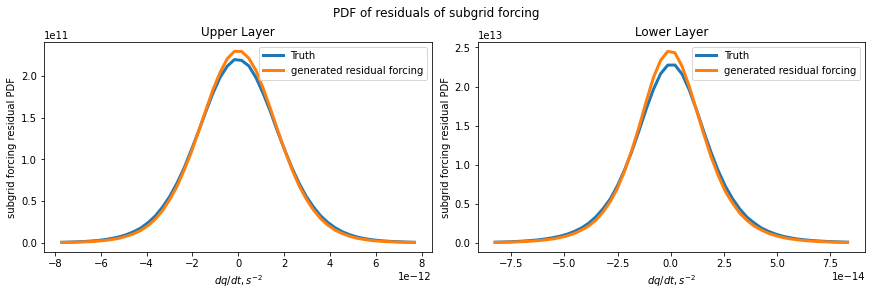

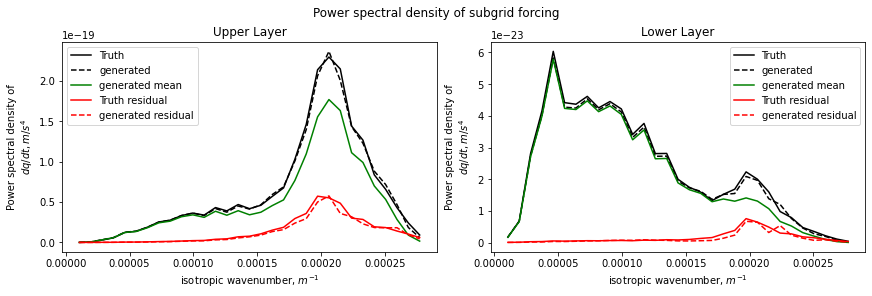

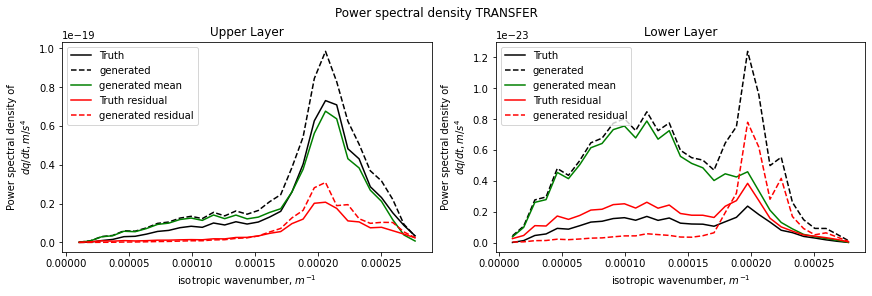

...

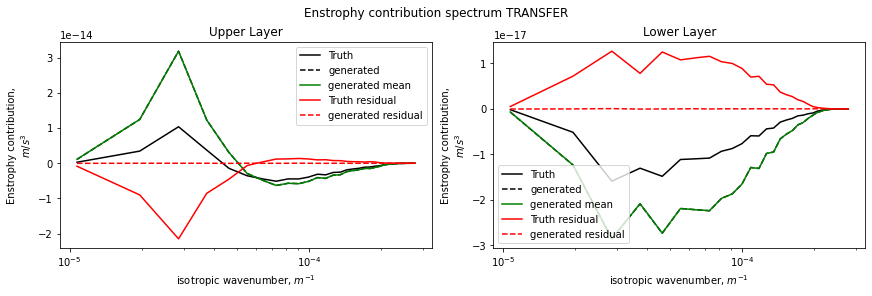

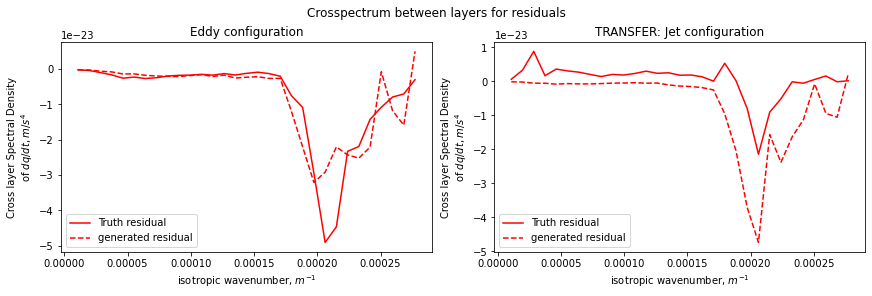

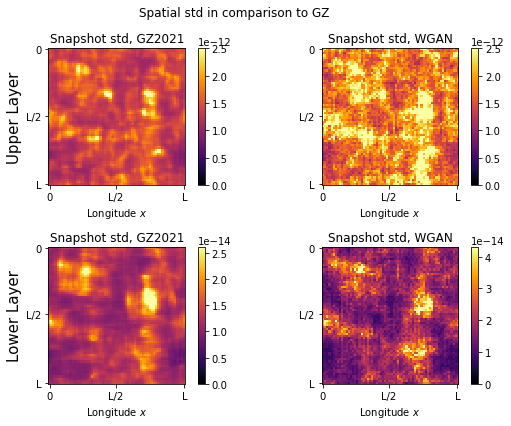

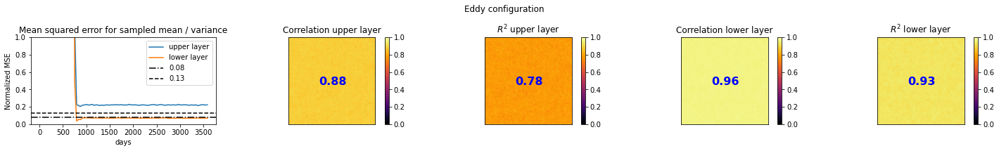

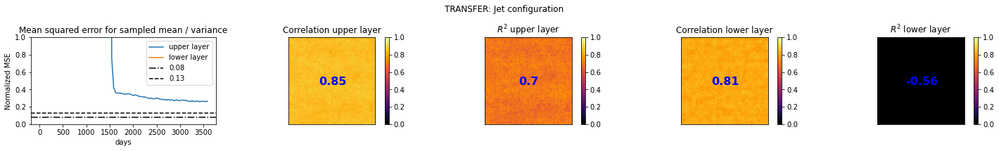

In [41]:
overview_experiment('EXP14')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'DeepInversion', 'discriminator': 'DeepInversion', 'bn': 'InstanceNorm', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.796,0.780,2.255]
   L2_q:       [0.577,0.573,210.559]
        L2_dq: [0.778,0.864,1.049]
L2+L2_q+L2_dq: [2.151,2.217,213.864]


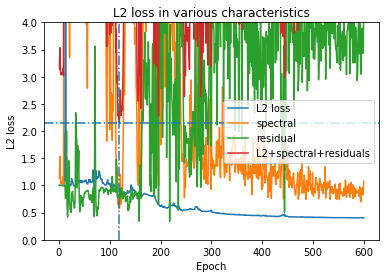

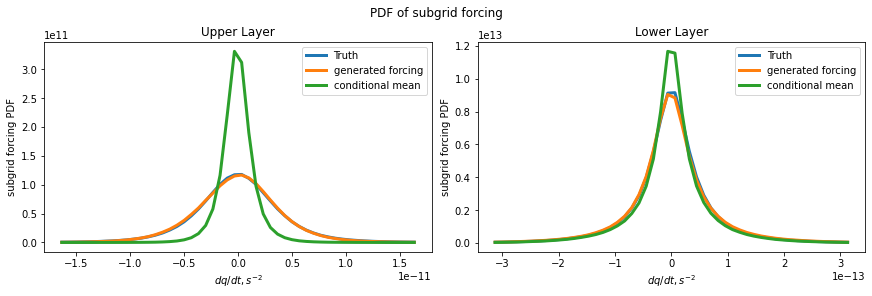

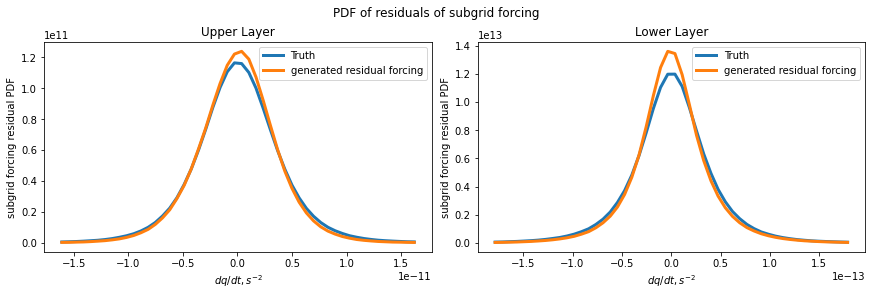

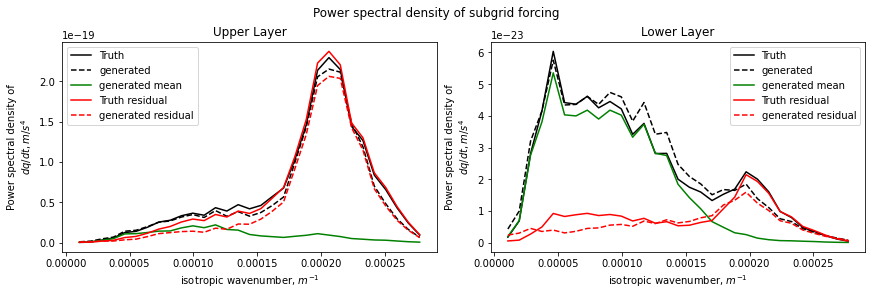

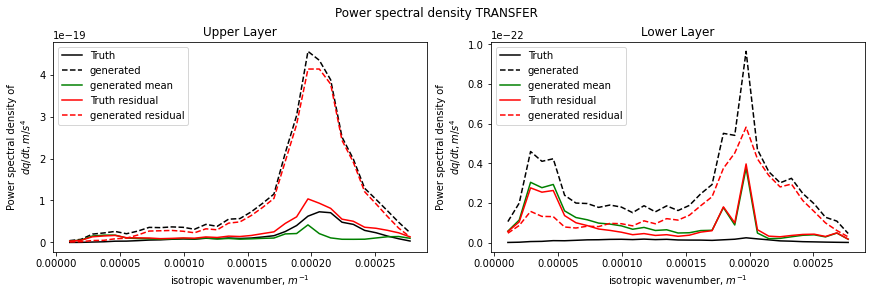

...

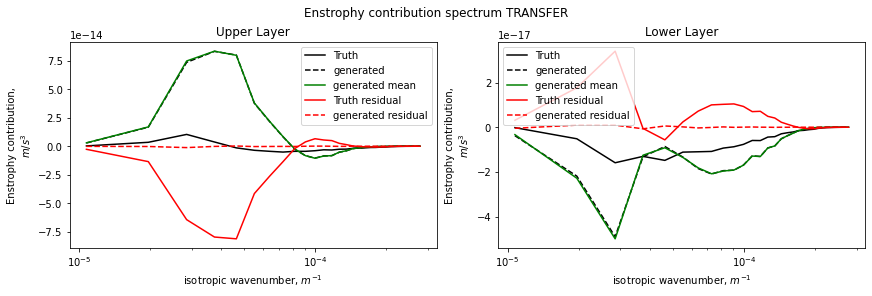

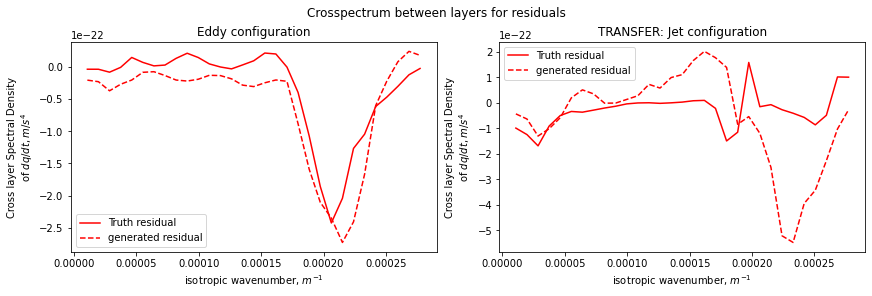

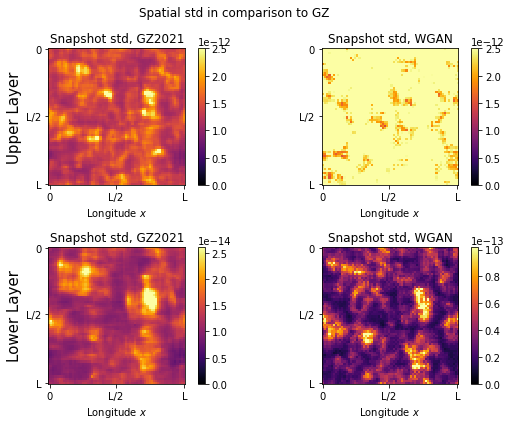

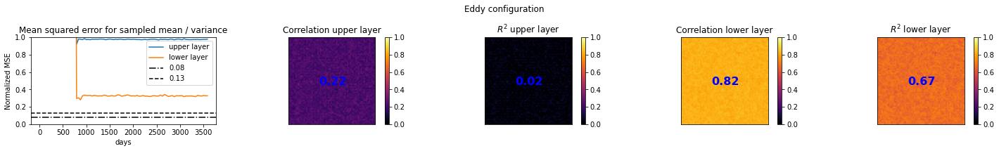

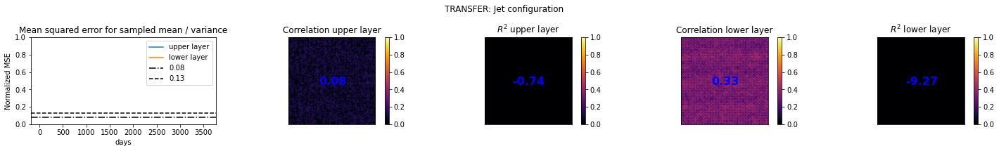

In [42]:
overview_experiment('EXP15')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'DeepInversion', 'discriminator': 'DeepInversion', 'bn': 'None', 'GP_shuffle': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.544,0.534,0.867]
   L2_q:       [0.469,0.469,4.572]
        L2_dq: [0.876,0.952,1.072]
L2+L2_q+L2_dq: [1.889,1.955,6.511]


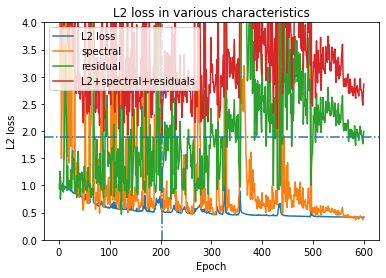

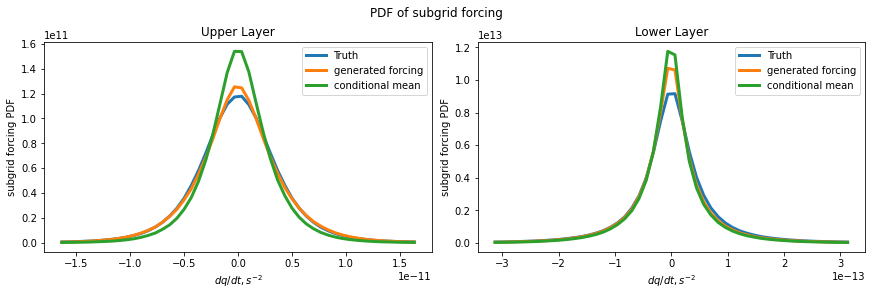

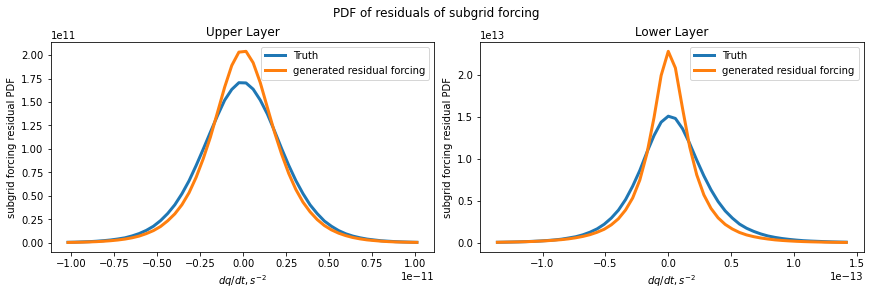

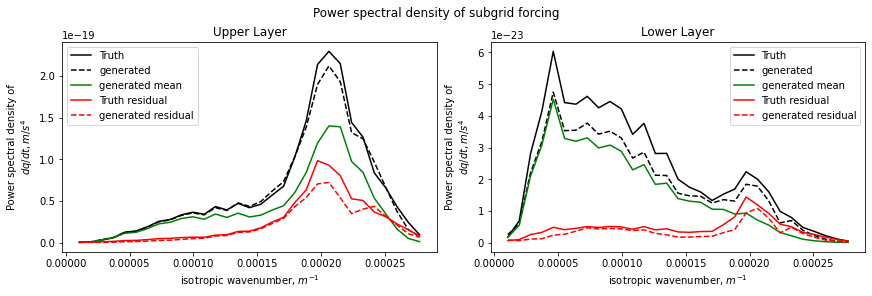

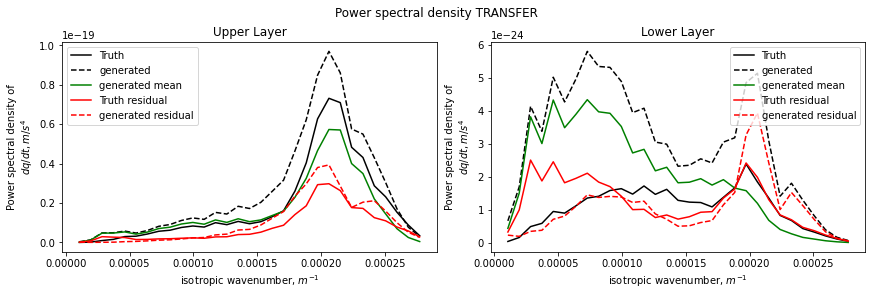

...

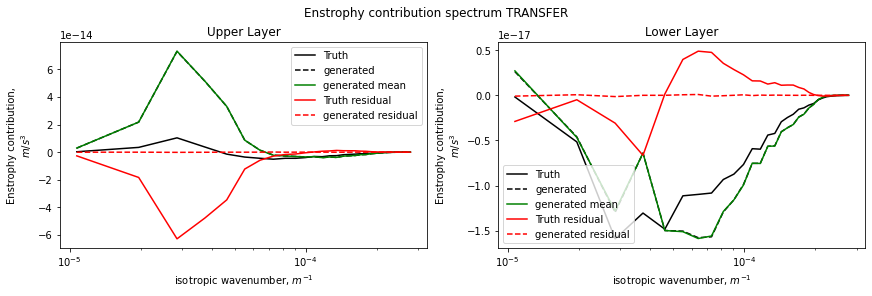

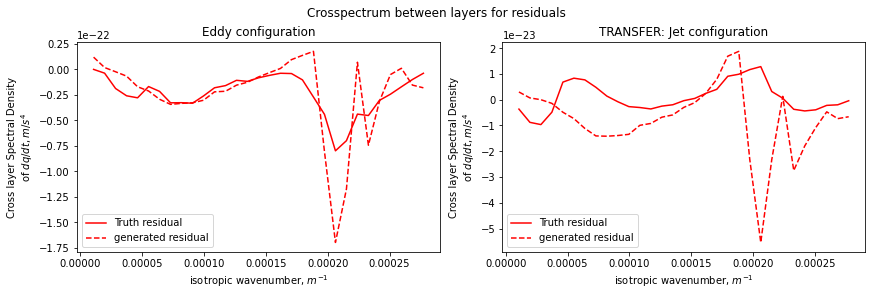

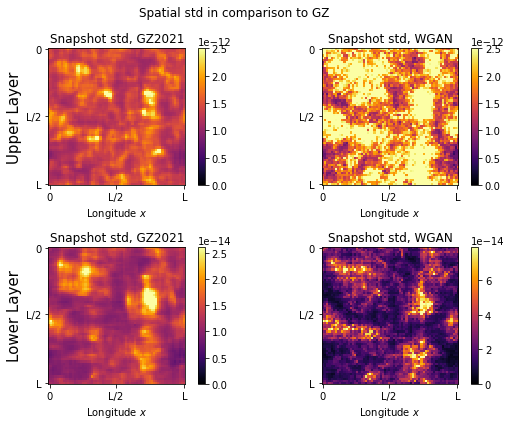

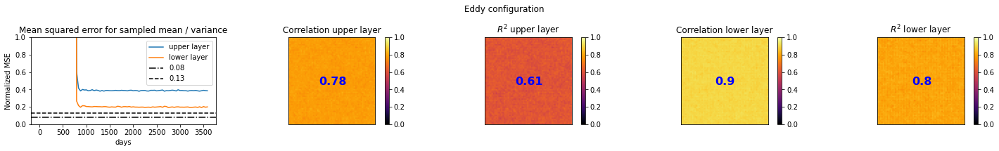

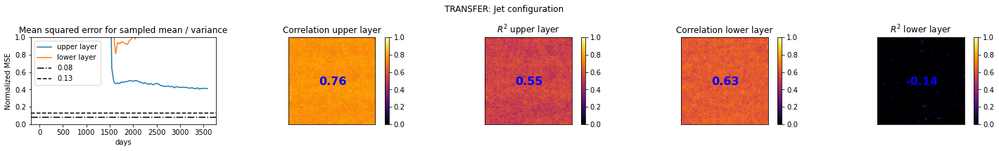

In [43]:
overview_experiment('EXP16')

# Regularizations

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 1.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.614,0.602,2.006]
   L2_q:       [0.391,0.387,22.453]
        L2_dq: [0.734,0.821,1.292]
L2+L2_q+L2_dq: [1.739,1.809,25.750]


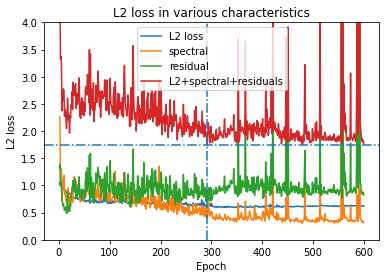

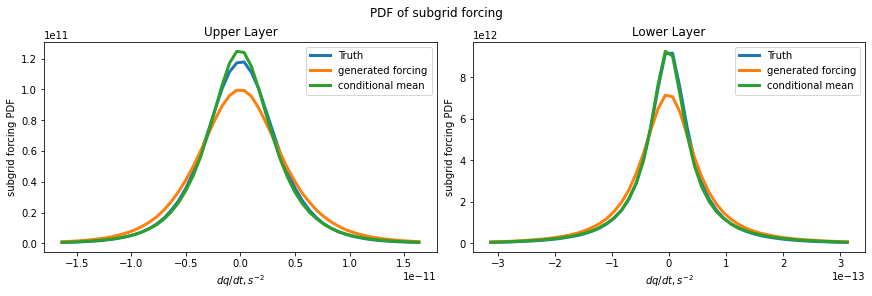

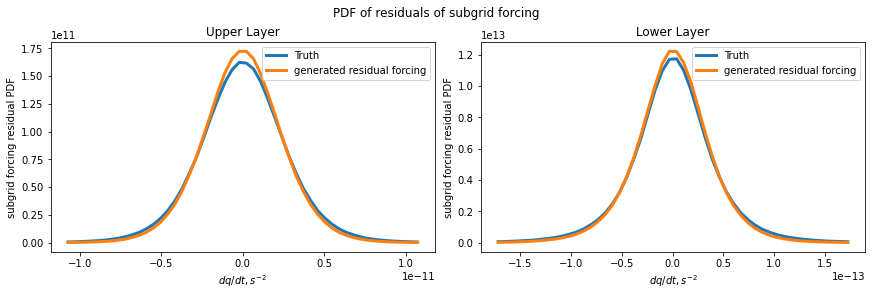

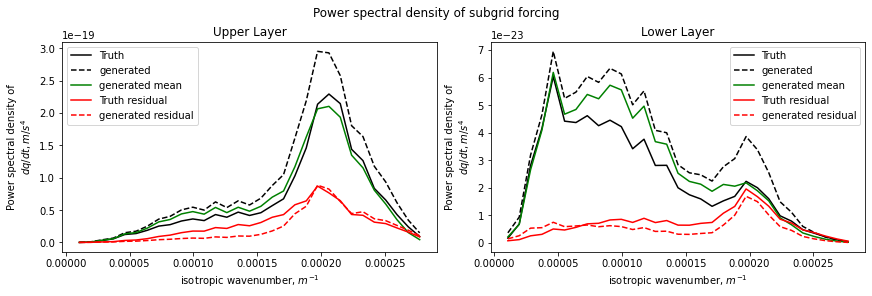

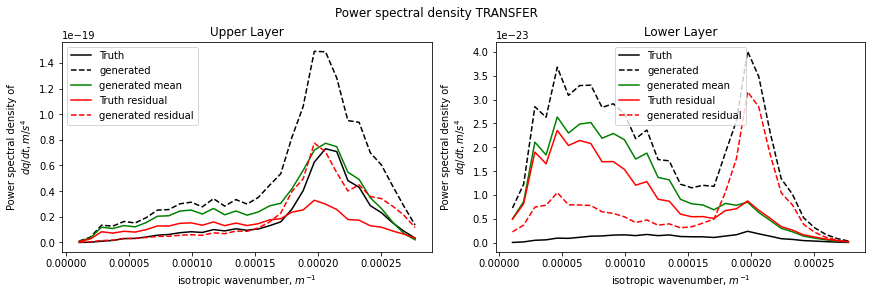

...

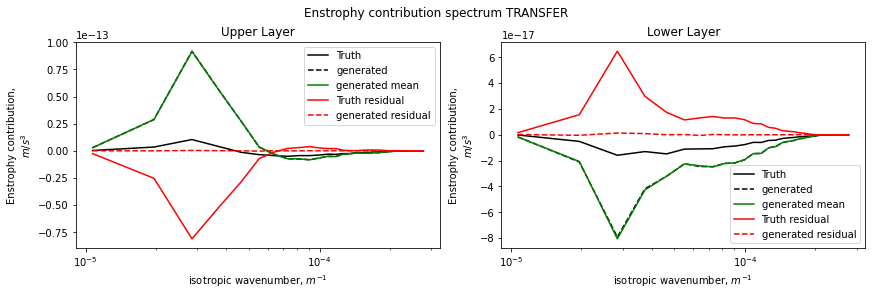

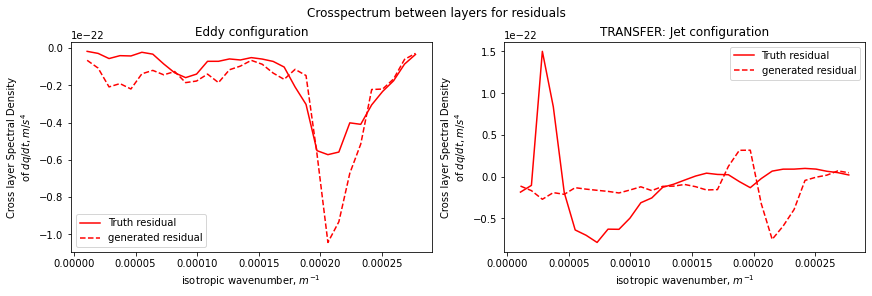

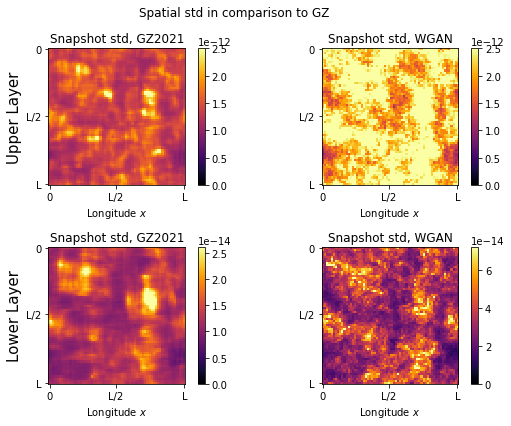

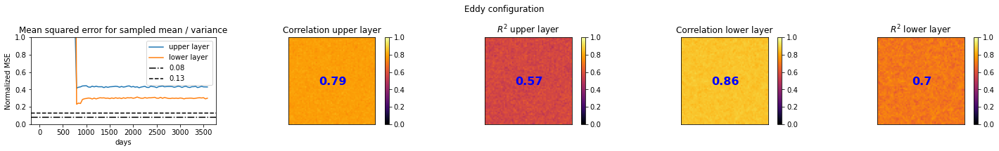

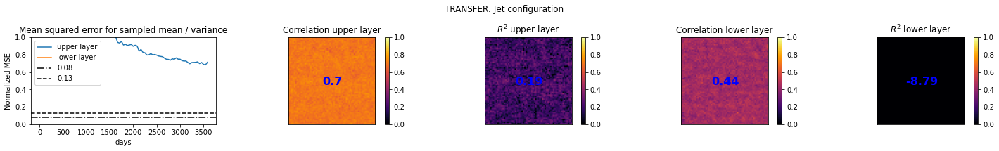

In [44]:
overview_experiment('EXP1', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 10.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.456,0.453,1.480]
   L2_q:       [0.240,0.240,12.324]
        L2_dq: [0.769,0.790,0.973]
L2+L2_q+L2_dq: [1.465,1.482,14.776]


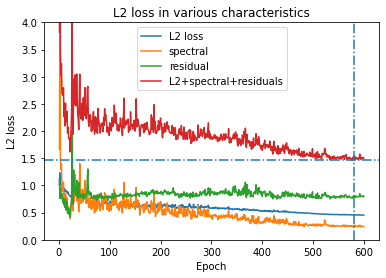

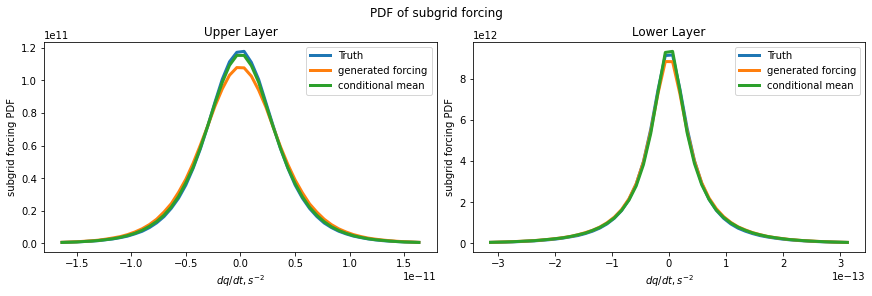

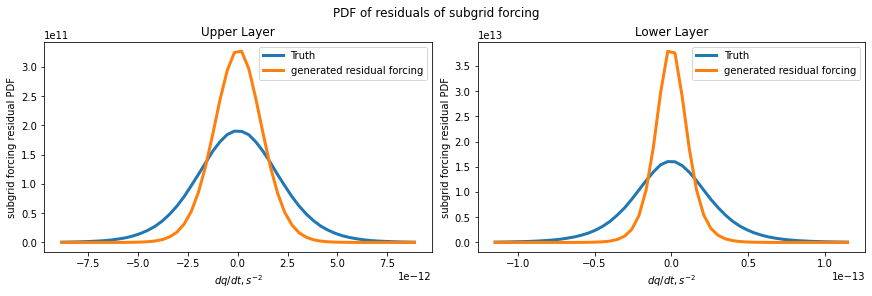

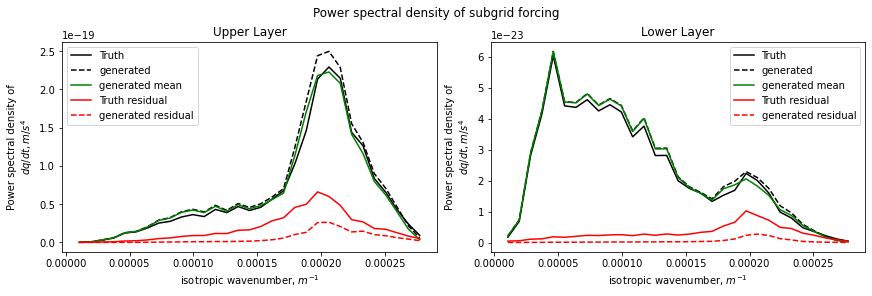

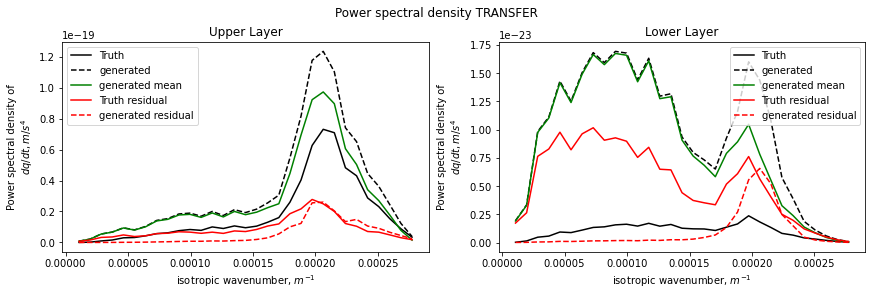

...

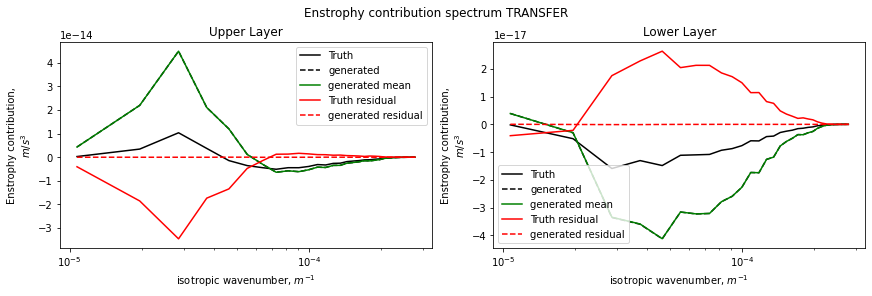

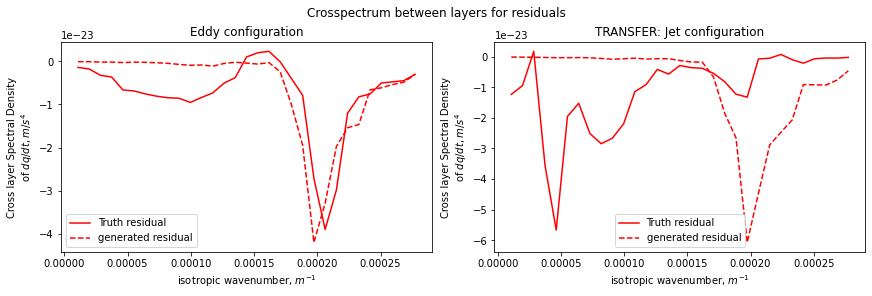

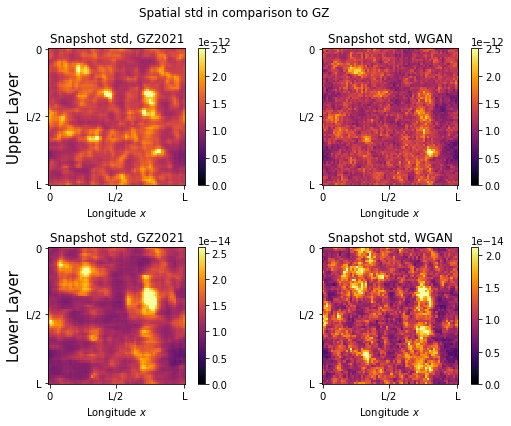

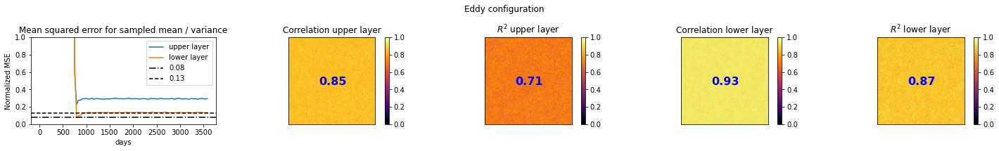

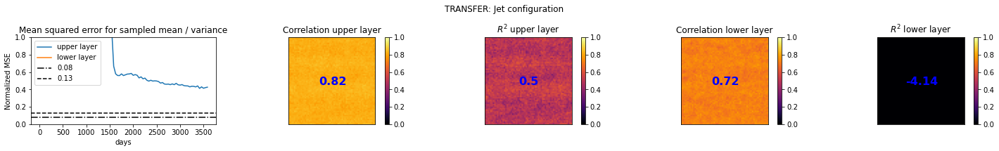

In [45]:
overview_experiment('EXP2', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 0.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.451,0.447,1.284]
   L2_q:       [0.198,0.198,6.999]
        L2_dq: [0.714,0.728,1.145]
L2+L2_q+L2_dq: [1.364,1.373,9.428]


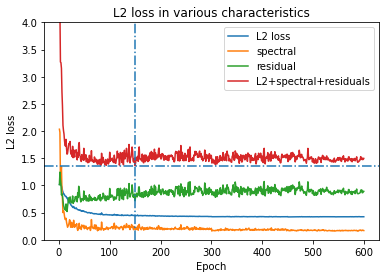

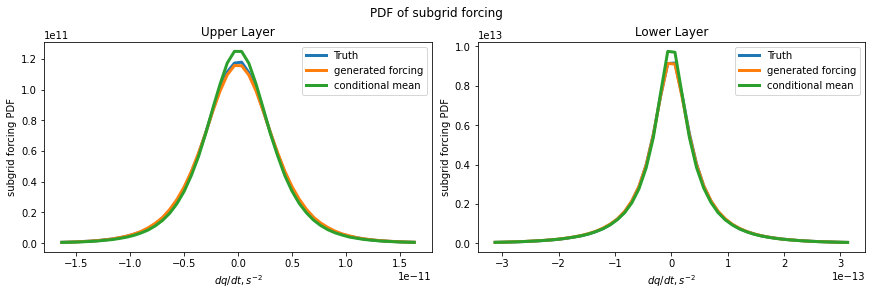

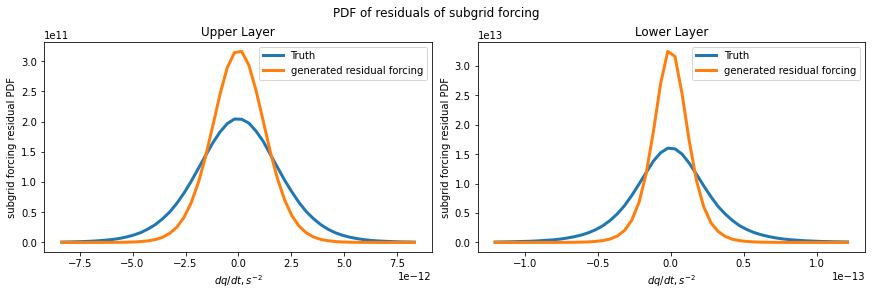

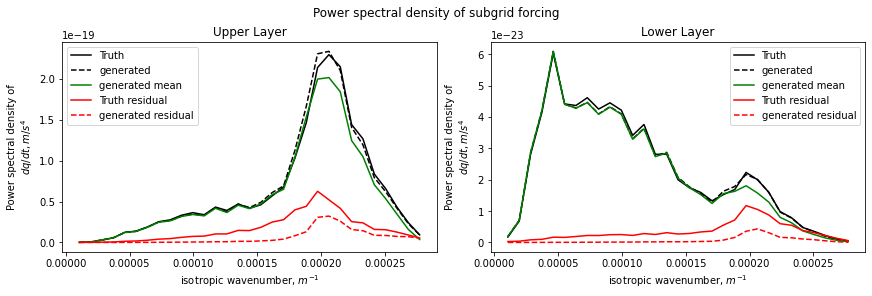

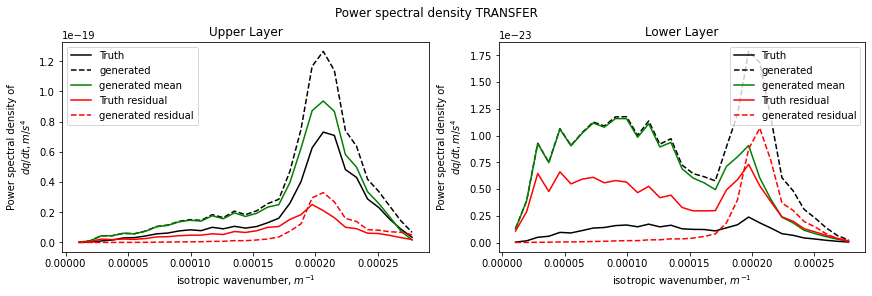

...

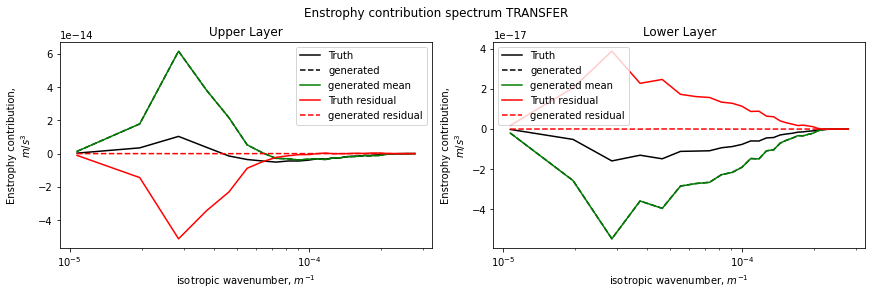

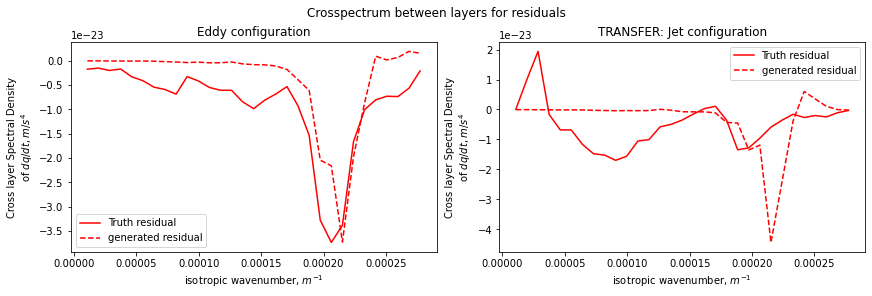

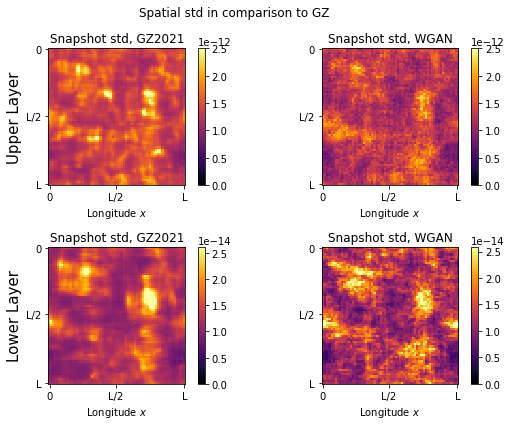

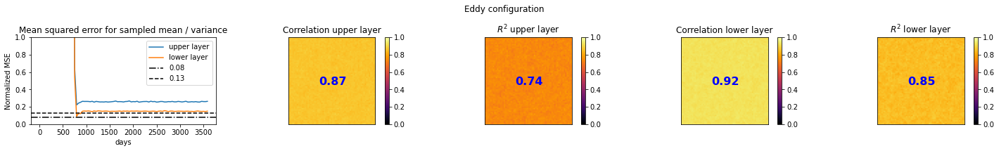

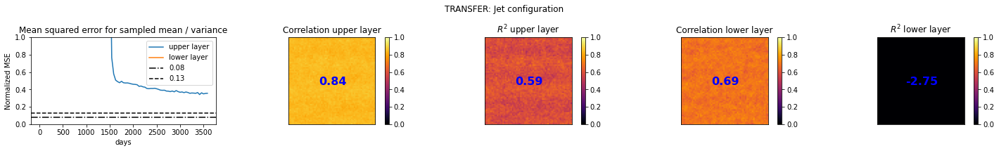

In [46]:
overview_experiment('EXP3', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 1, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 0.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.469,0.469,1.289]
   L2_q:       [0.176,0.177,4.950]
        L2_dq: [1.000,1.000,1.000]
L2+L2_q+L2_dq: [1.645,1.646,7.239]


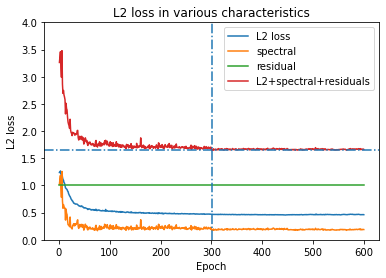

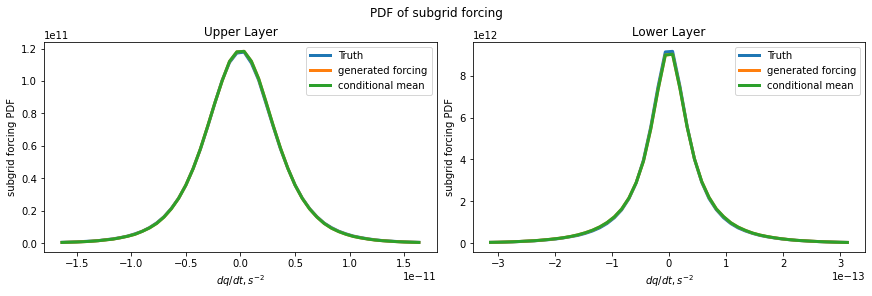

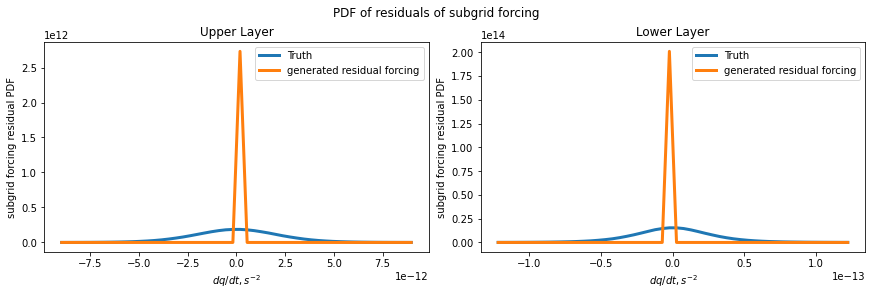

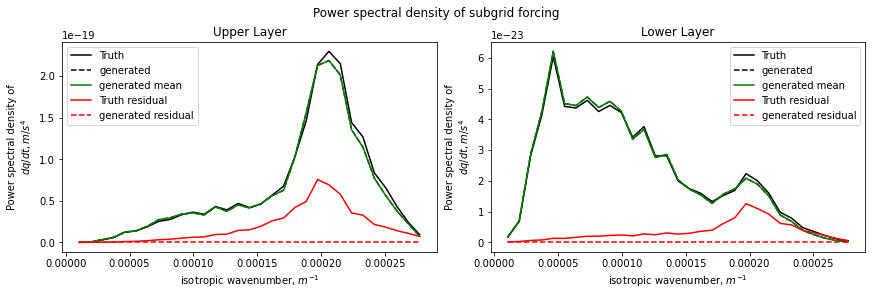

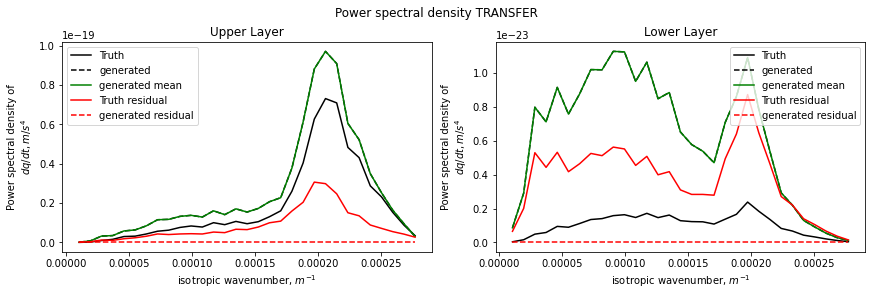

...

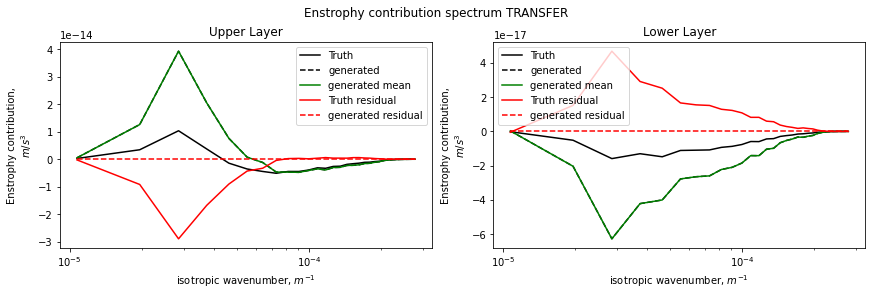

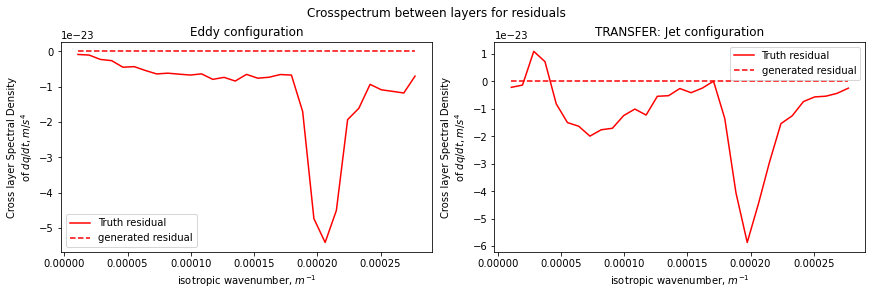

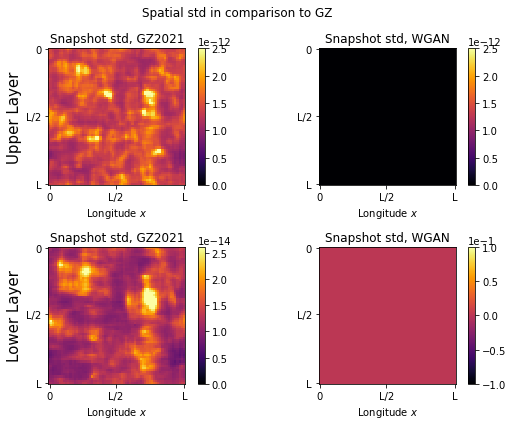

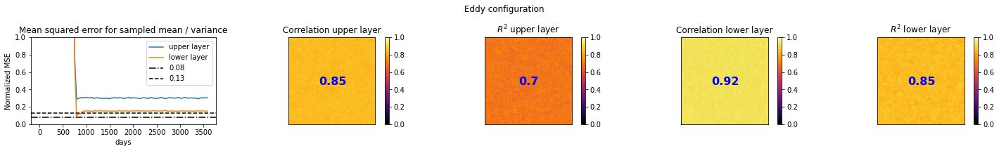

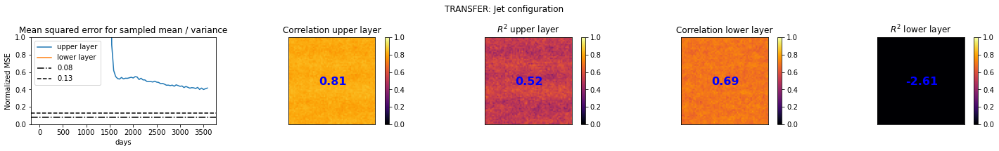

In [47]:
overview_experiment('EXP4', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 1.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 0.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.527,0.522,1.296]
   L2_q:       [0.176,0.175,10.425]
        L2_dq: [0.629,0.652,2.093]
L2+L2_q+L2_dq: [1.331,1.349,13.814]


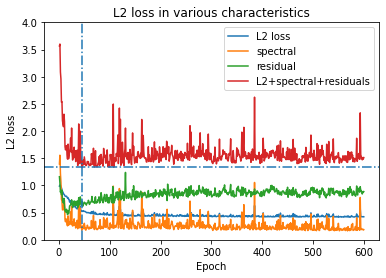

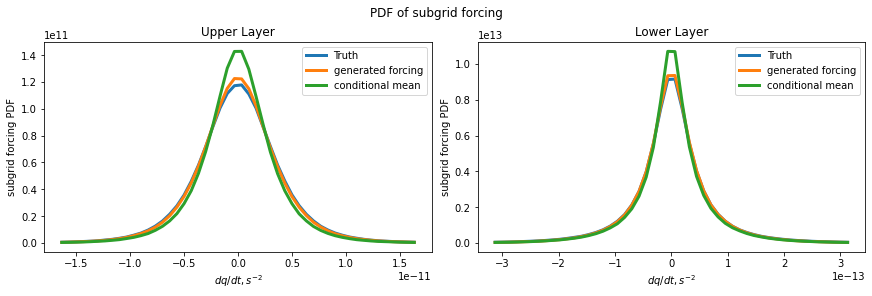

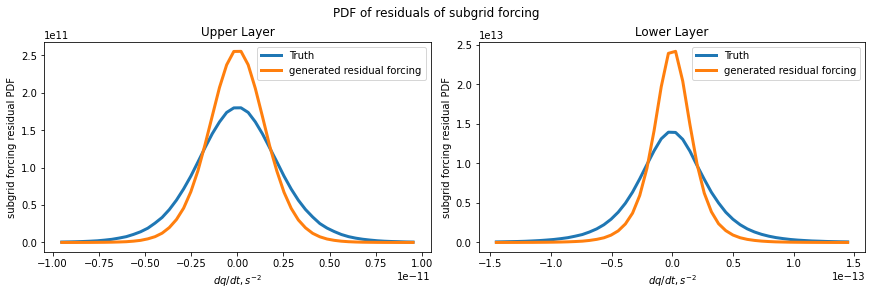

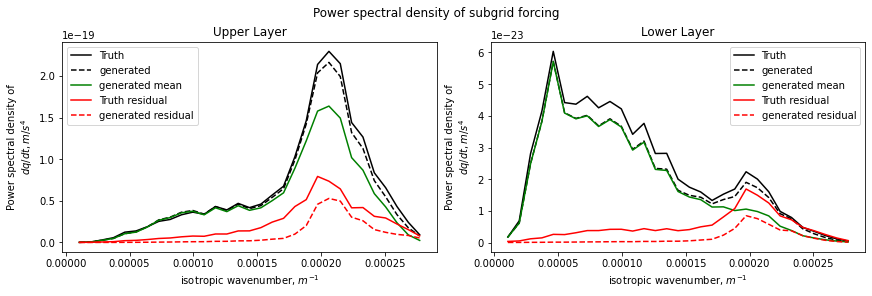

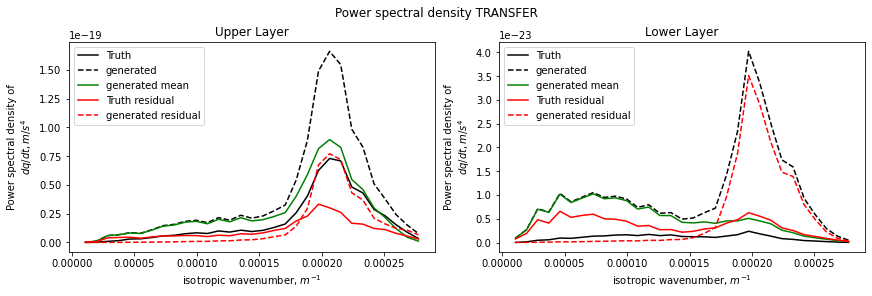

...

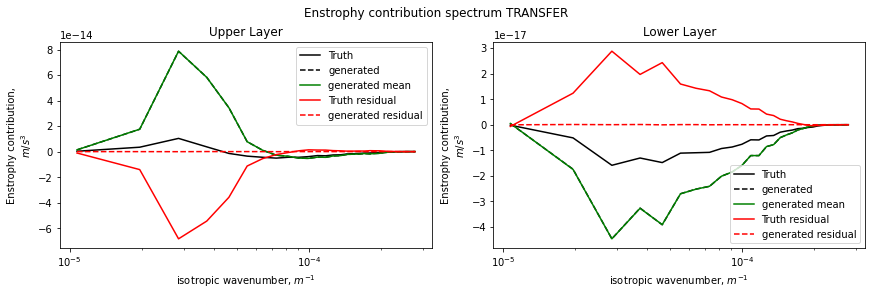

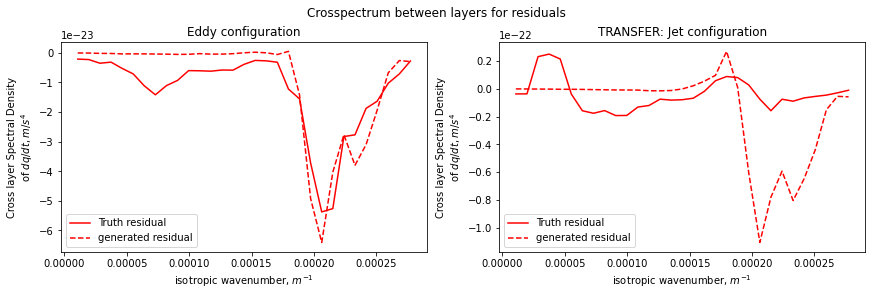

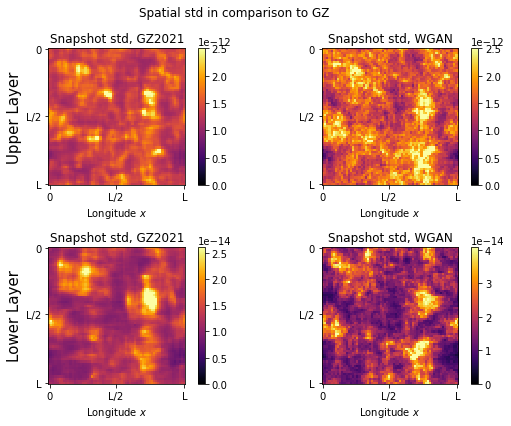

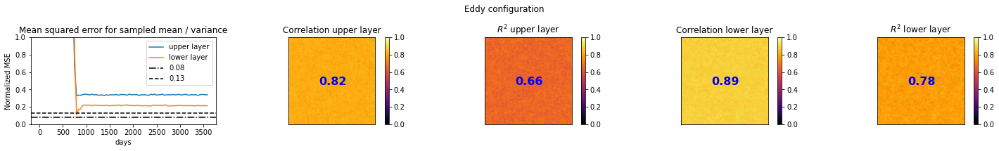

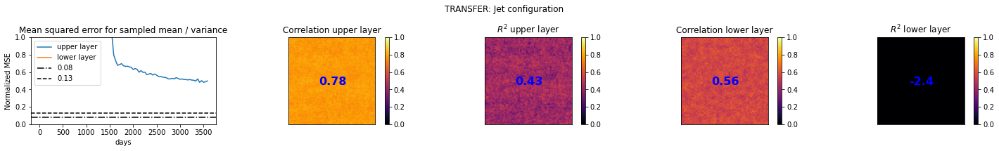

In [48]:
overview_experiment('EXP5', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 10.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 0.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.411,0.404,1.044]
   L2_q:       [0.150,0.149,7.603]
        L2_dq: [0.526,0.562,2.790]
L2+L2_q+L2_dq: [1.087,1.115,11.437]


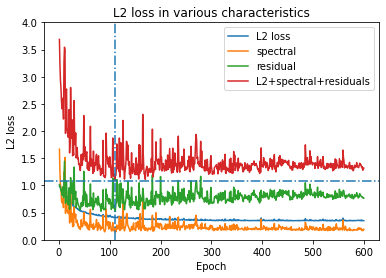

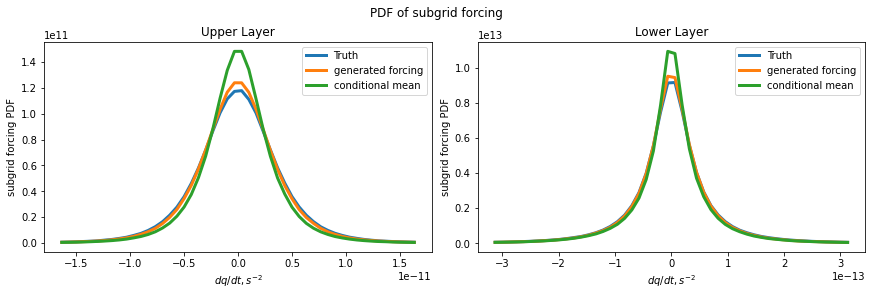

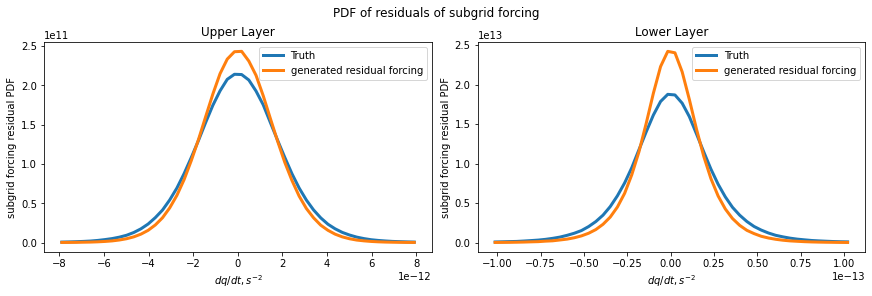

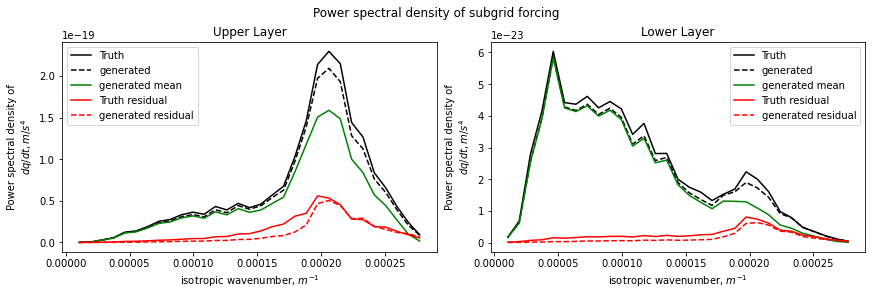

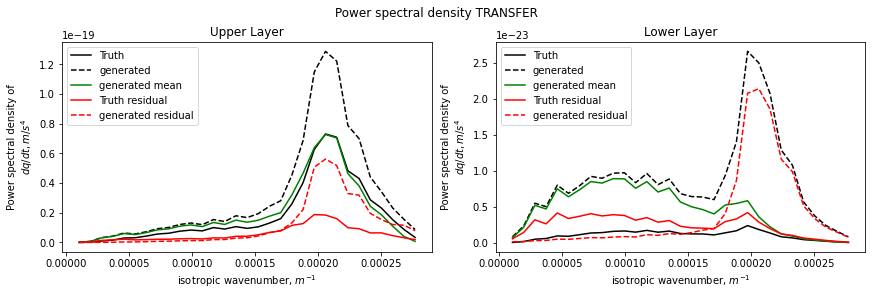

...

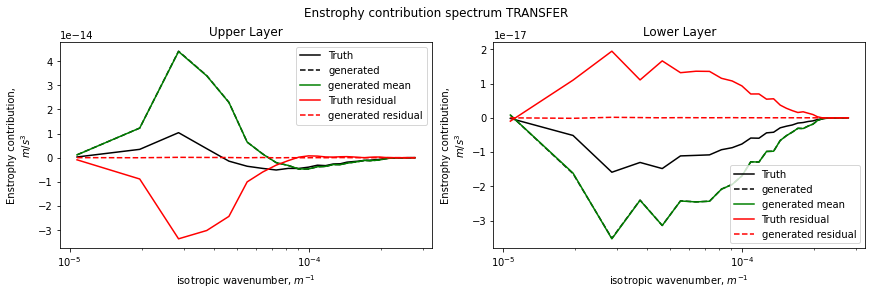

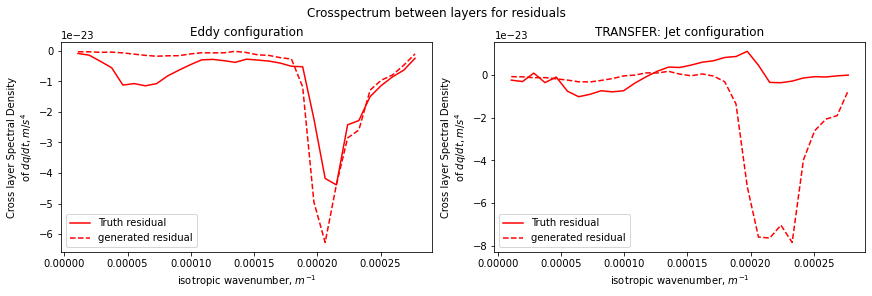

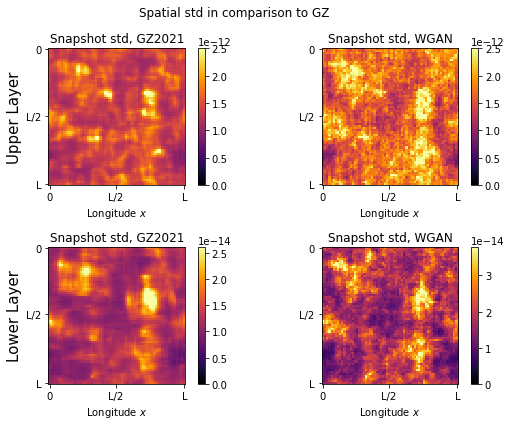

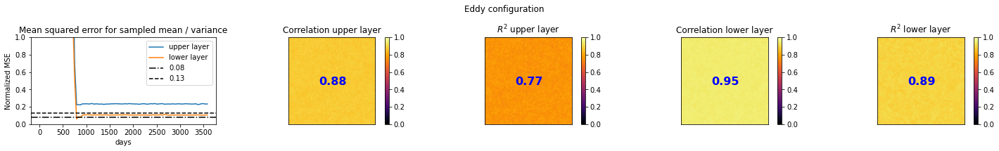

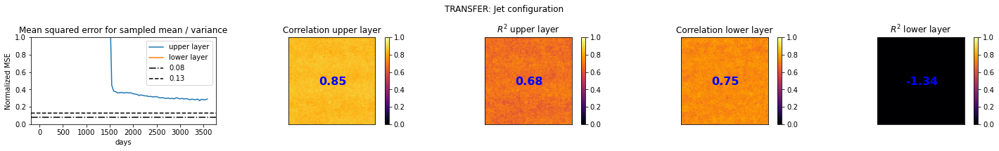

In [49]:
overview_experiment('EXP6', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 1.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 0.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.482,0.478,1.298]
   L2_q:       [0.171,0.173,8.463]
        L2_dq: [0.684,0.690,1.277]
L2+L2_q+L2_dq: [1.336,1.340,11.038]


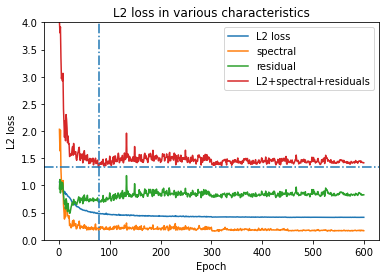

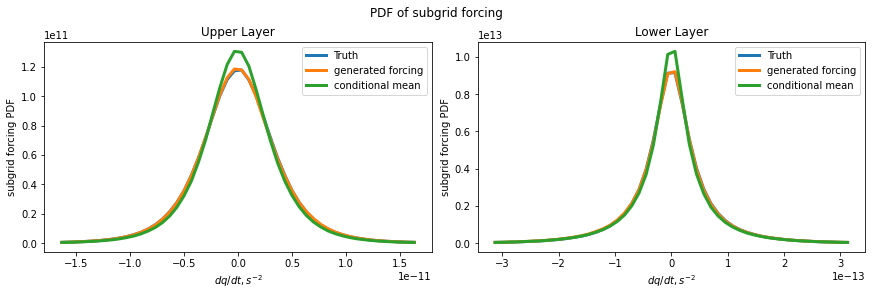

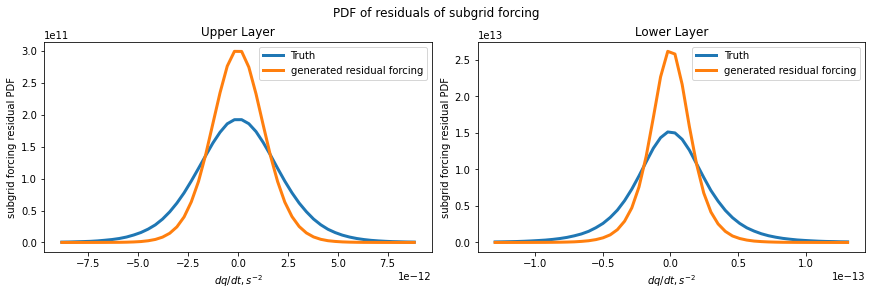

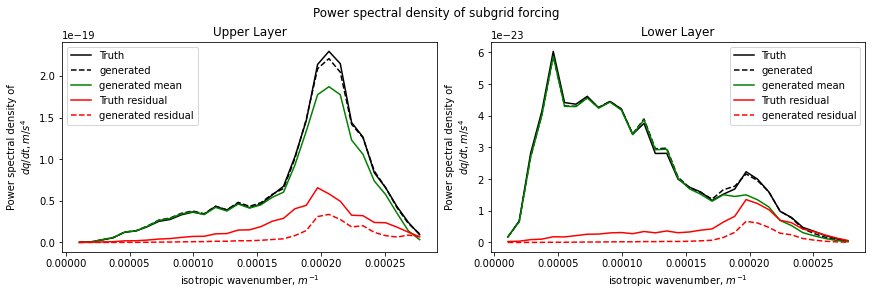

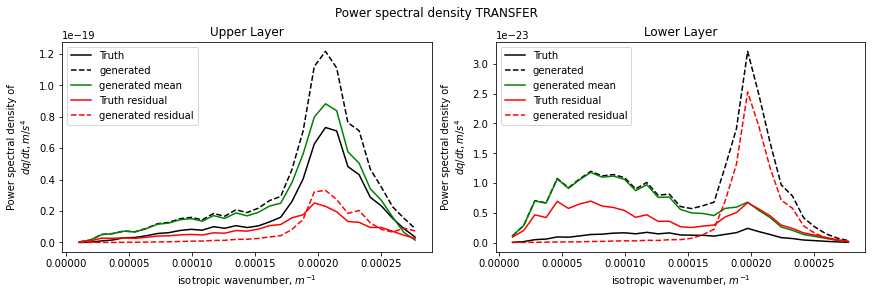

...

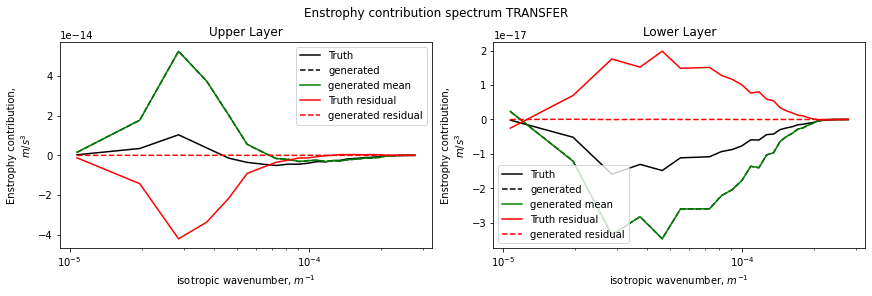

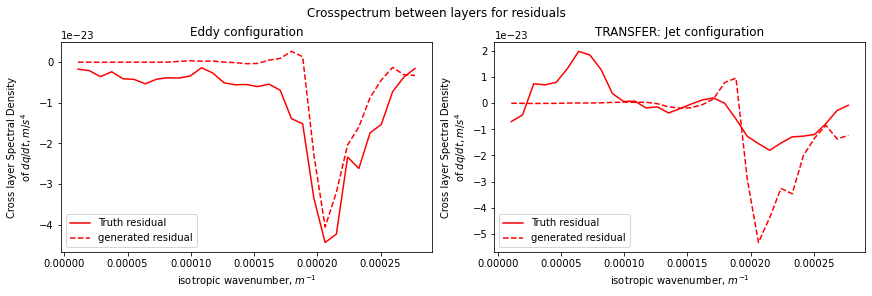

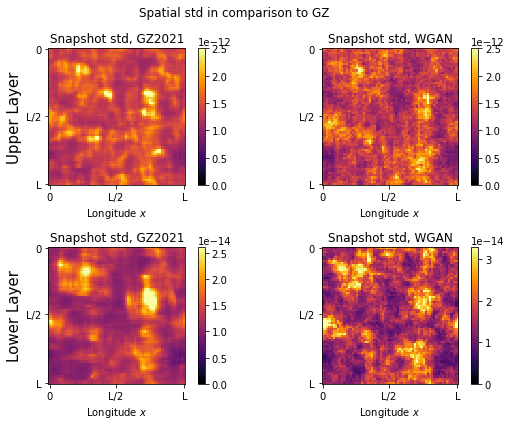

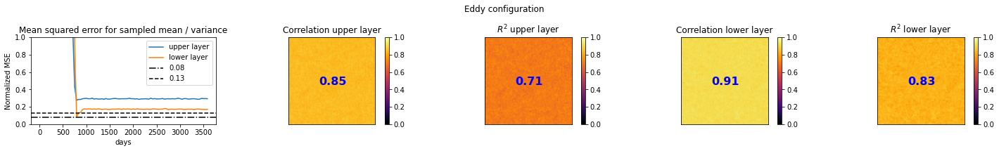

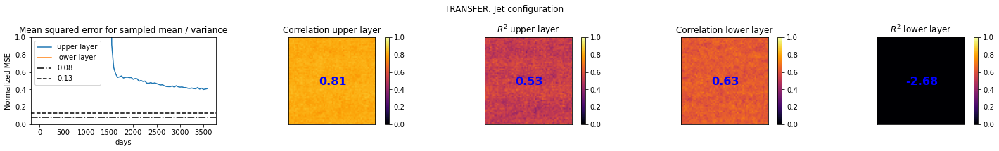

In [50]:
overview_experiment('EXP7', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 10.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 0.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.368,0.367,1.154]
   L2_q:       [0.173,0.174,4.230]
        L2_dq: [0.763,0.772,0.978]
L2+L2_q+L2_dq: [1.304,1.313,6.362]


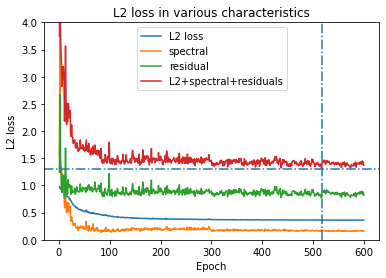

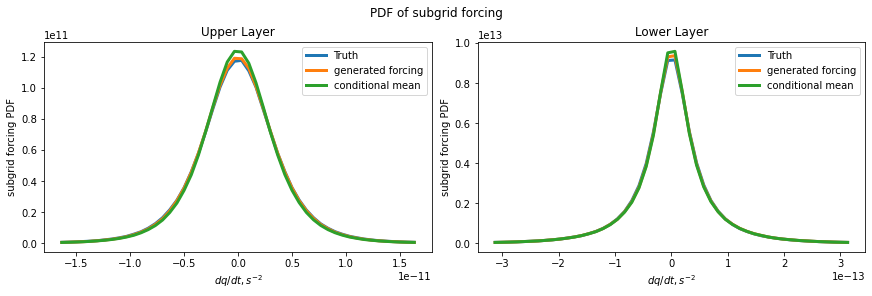

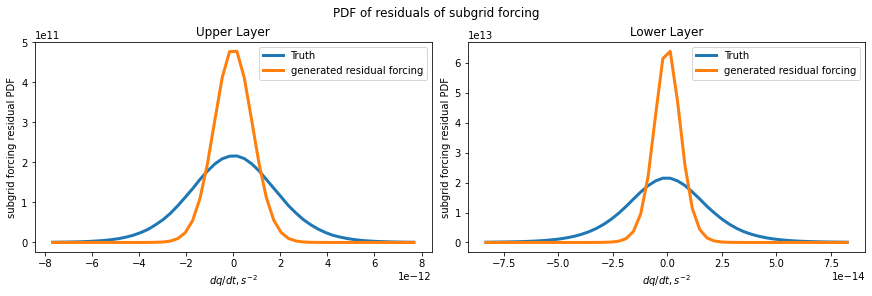

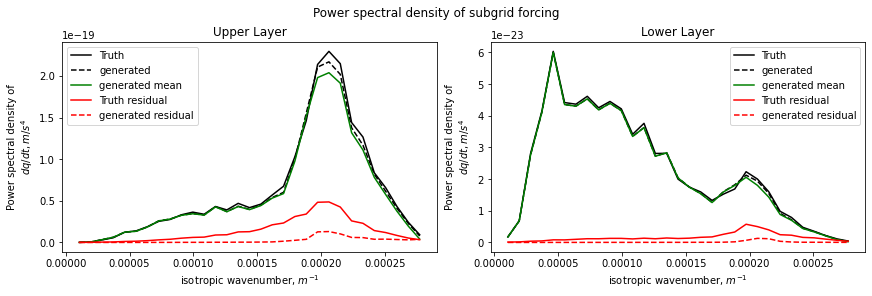

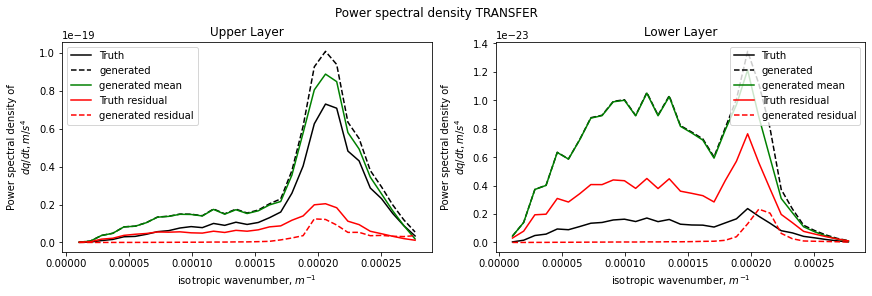

...

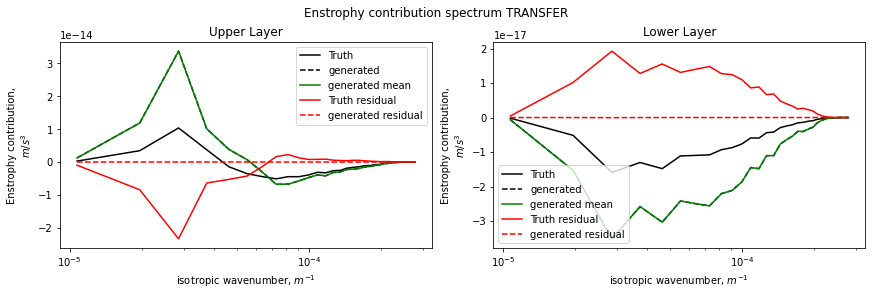

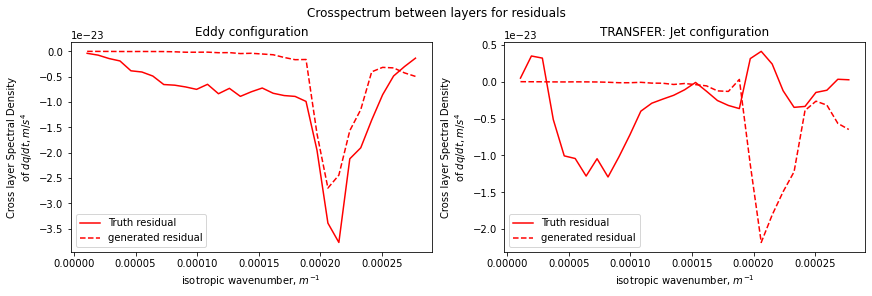

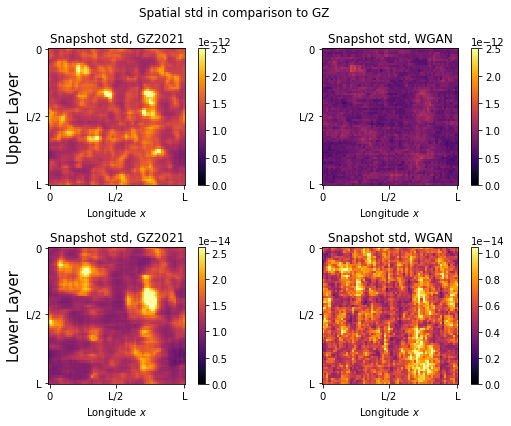

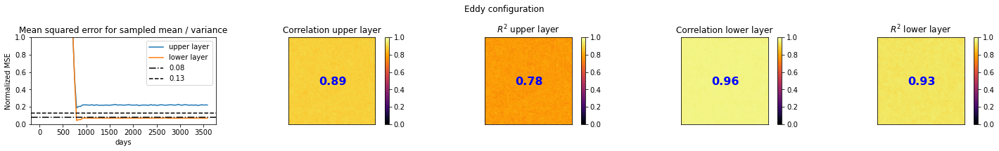

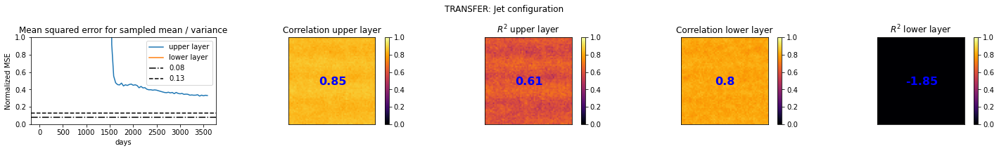

In [51]:
overview_experiment('EXP8', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 1.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 0.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.372,0.363,1.110]
   L2_q:       [0.156,0.155,7.699]
        L2_dq: [0.561,0.629,2.110]
L2+L2_q+L2_dq: [1.088,1.147,10.919]


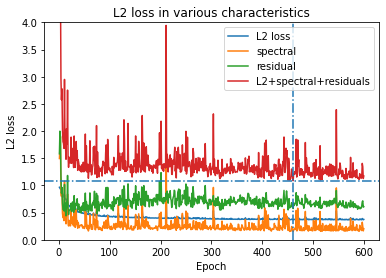

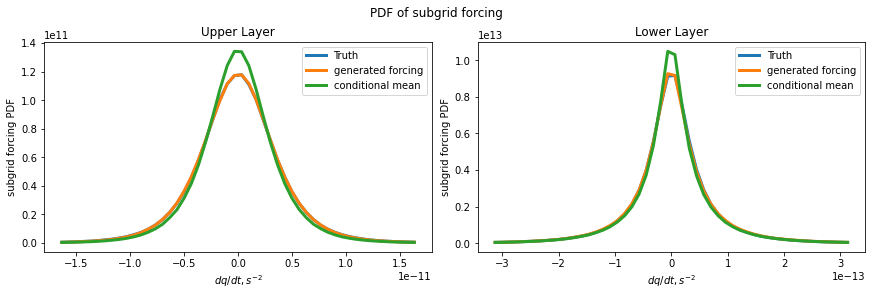

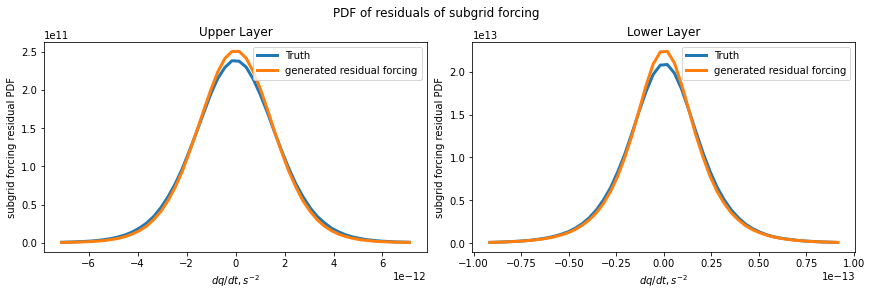

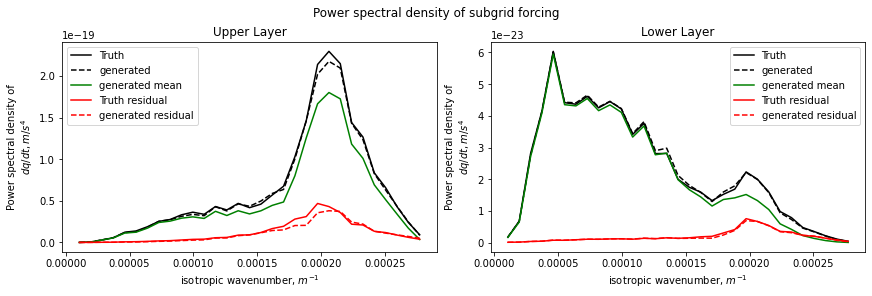

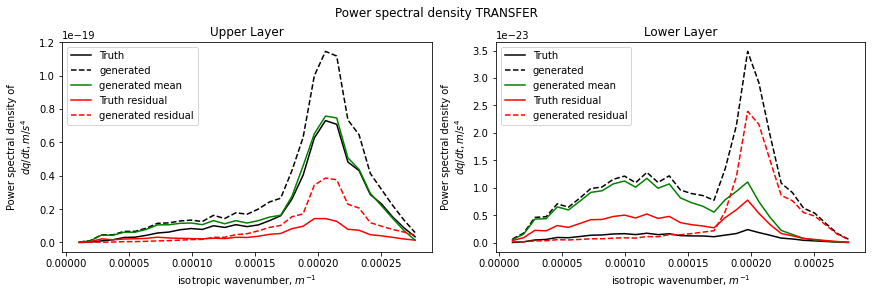

...

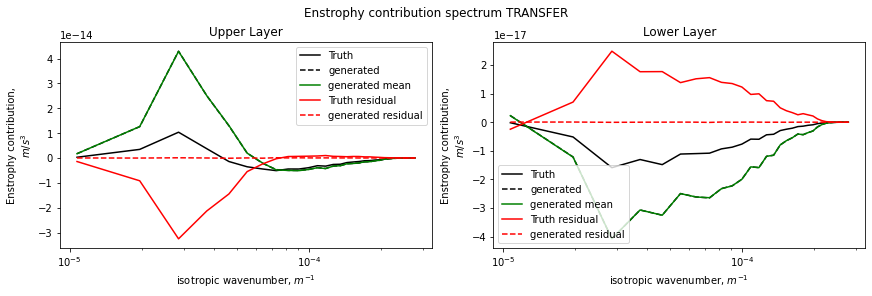

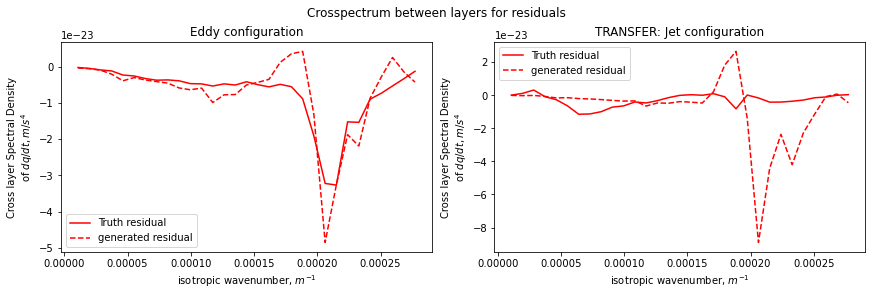

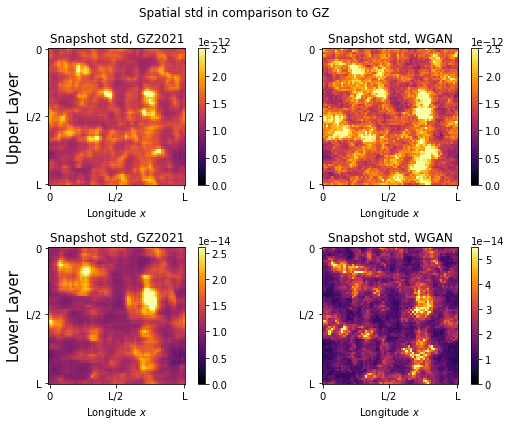

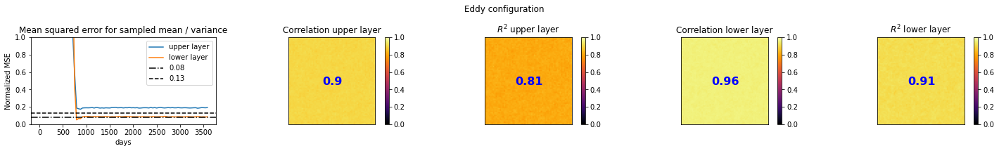

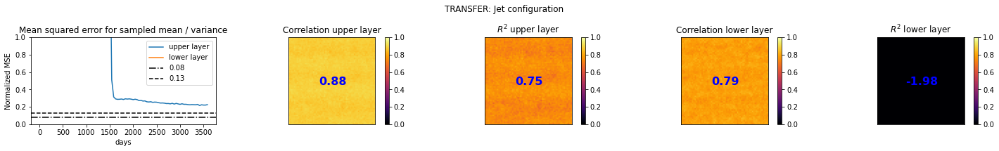

In [52]:
overview_experiment('EXP9', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 10.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 0.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.338,0.330,0.997]
   L2_q:       [0.156,0.157,5.158]
        L2_dq: [0.508,0.538,1.365]
L2+L2_q+L2_dq: [1.002,1.024,7.520]


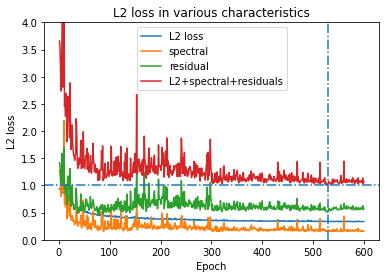

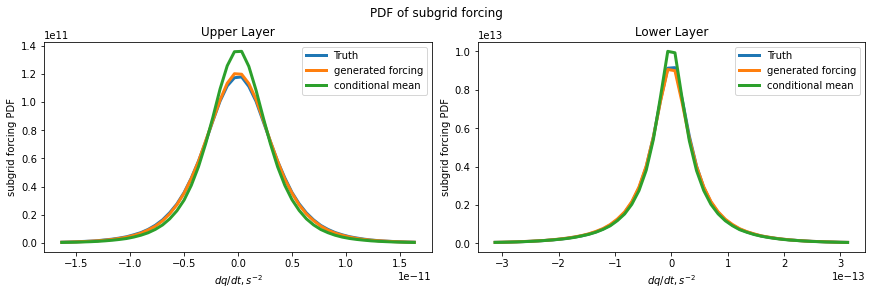

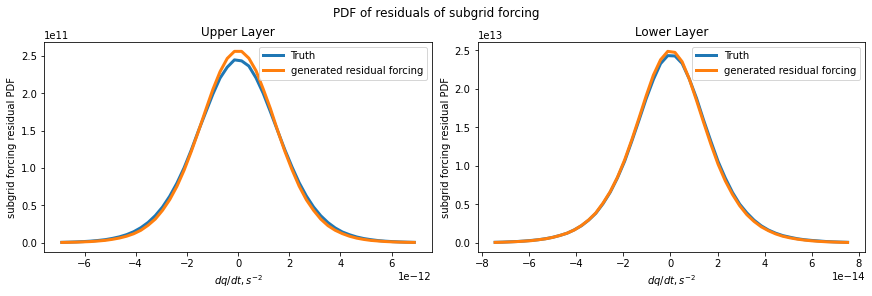

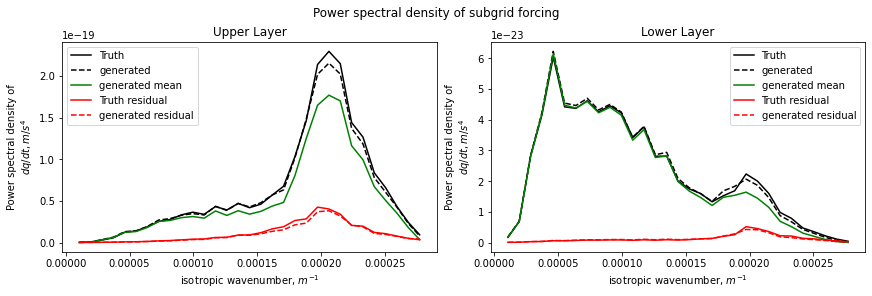

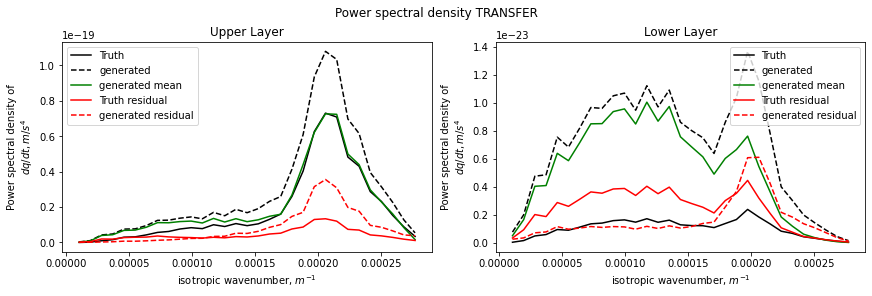

...

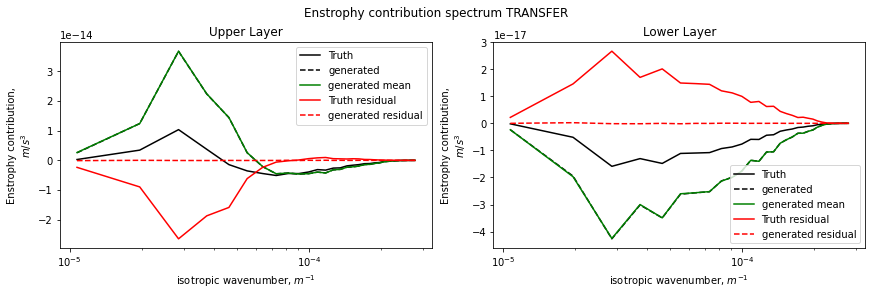

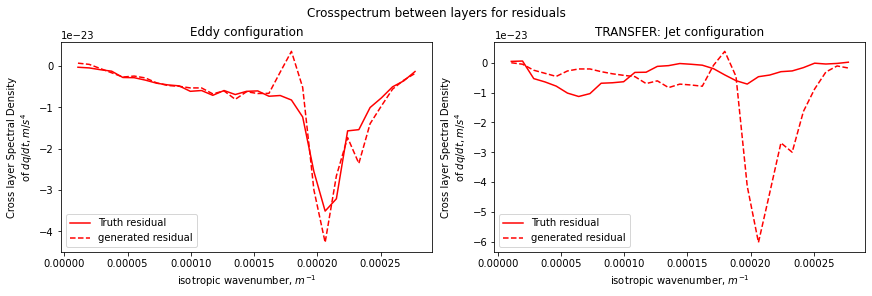

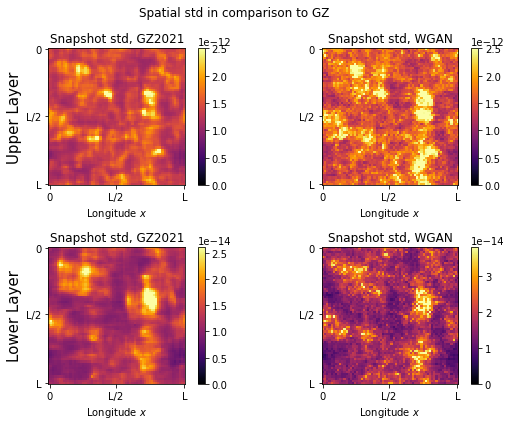

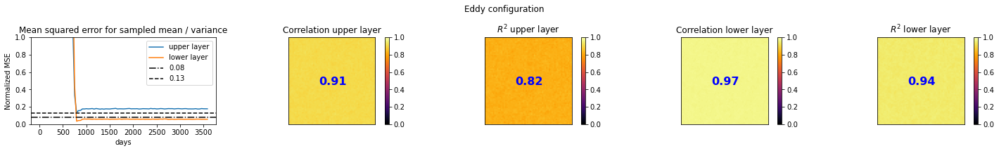

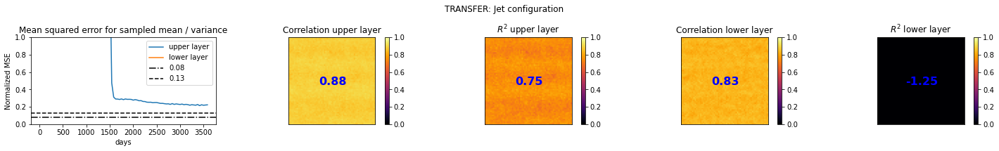

In [53]:
overview_experiment('EXP10', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 1.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 0.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.368,0.360,1.077]
   L2_q:       [0.152,0.154,5.399]
        L2_dq: [0.558,0.621,1.780]
L2+L2_q+L2_dq: [1.078,1.135,8.256]


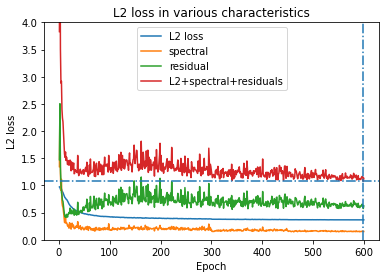

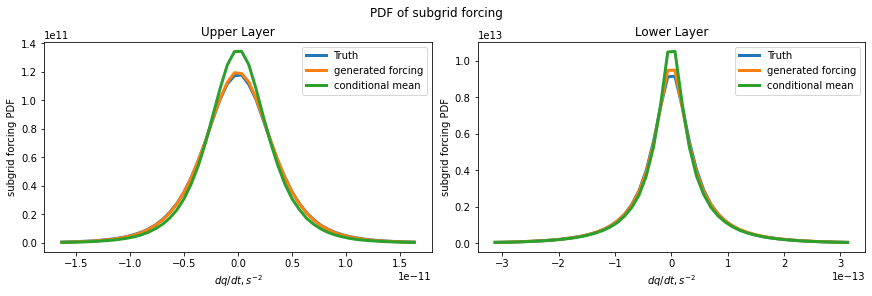

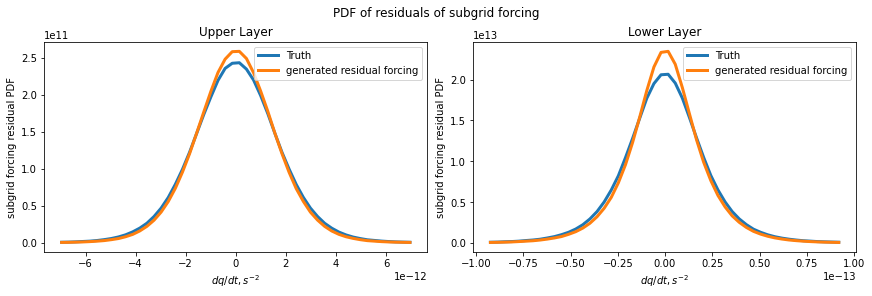

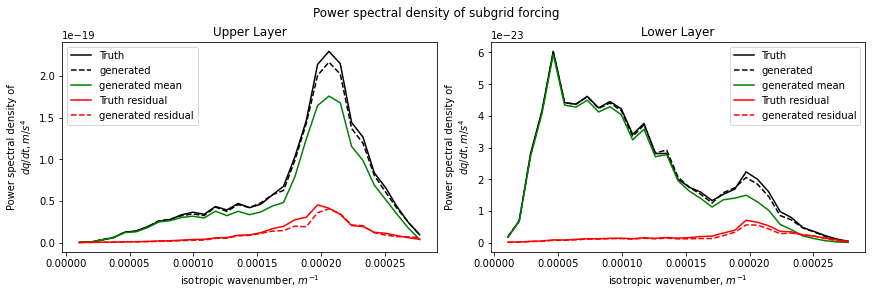

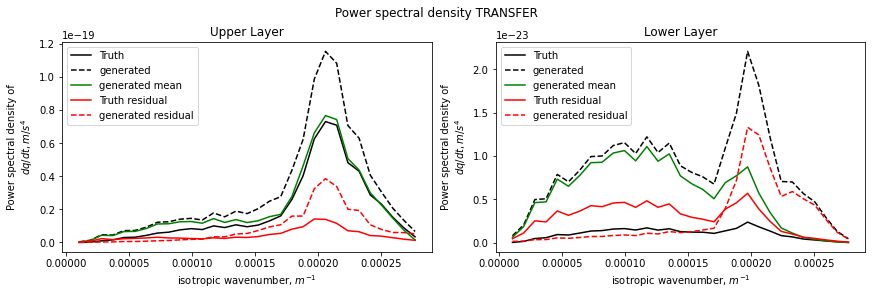

...

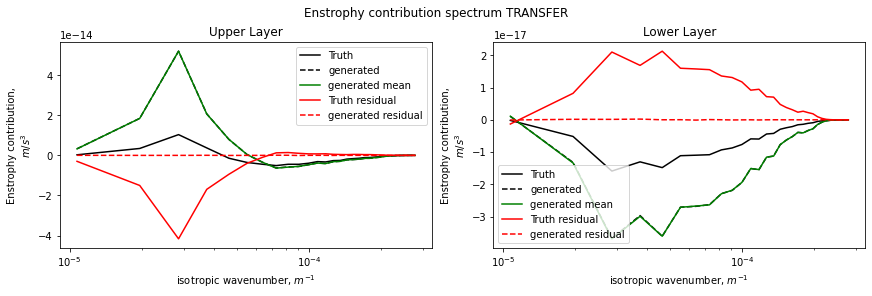

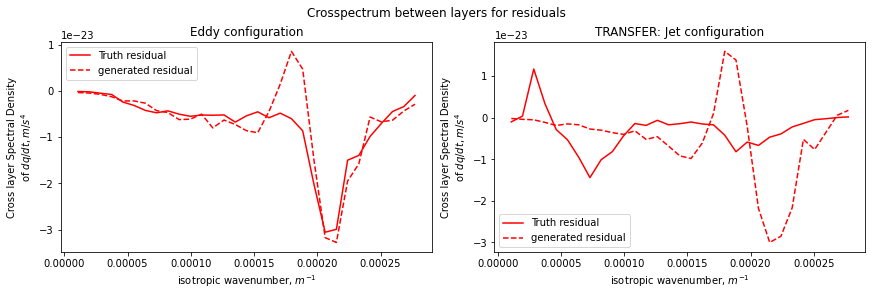

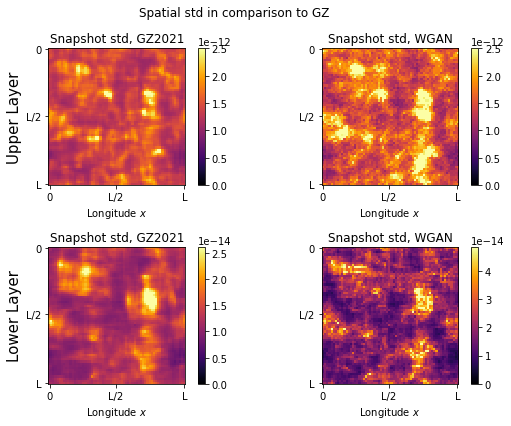

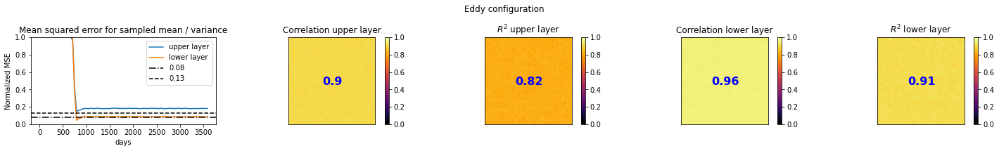

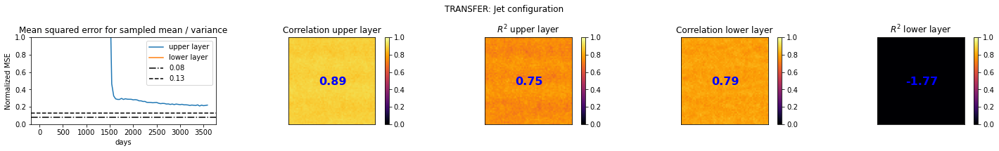

In [54]:
overview_experiment('EXP11', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 10.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 0.0, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.388,0.379,1.147]
   L2_q:       [0.134,0.135,10.139]
        L2_dq: [0.477,0.504,2.091]
L2+L2_q+L2_dq: [0.999,1.018,13.377]


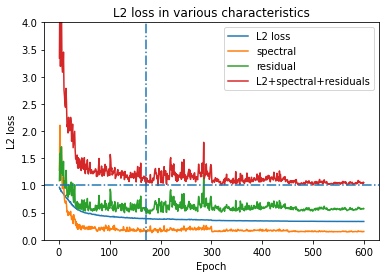

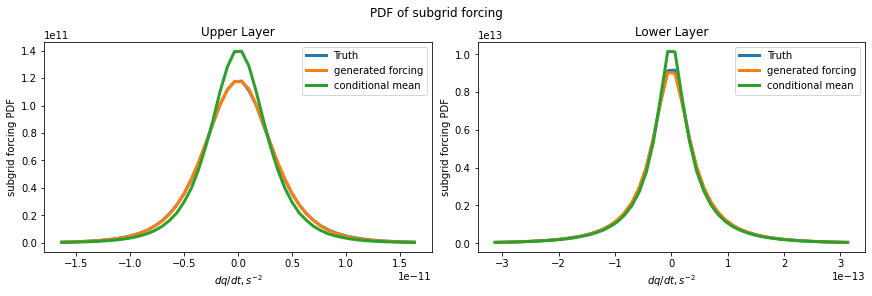

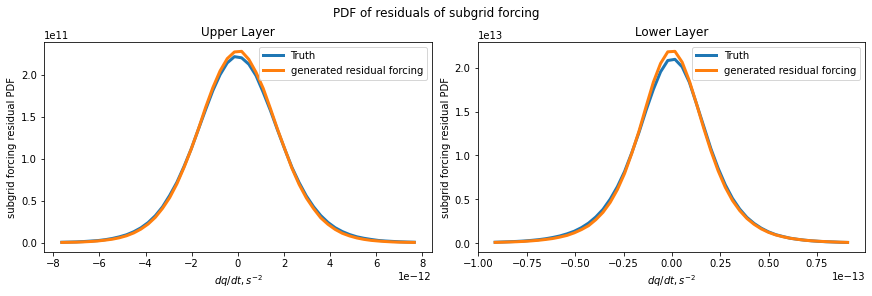

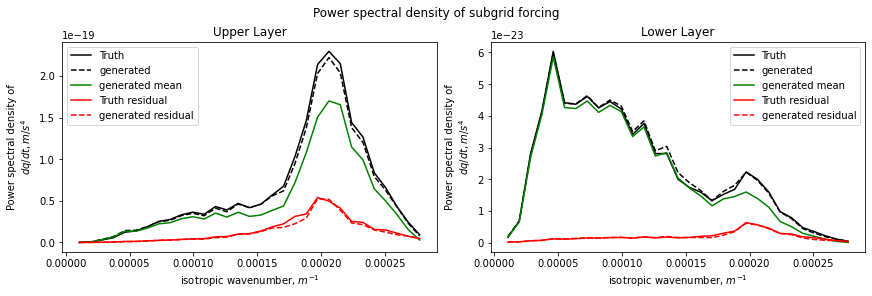

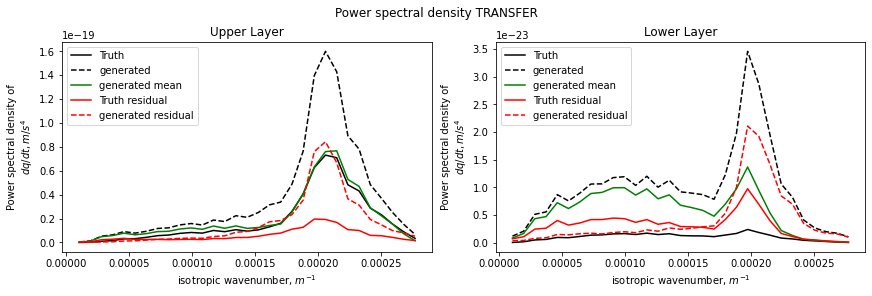

...

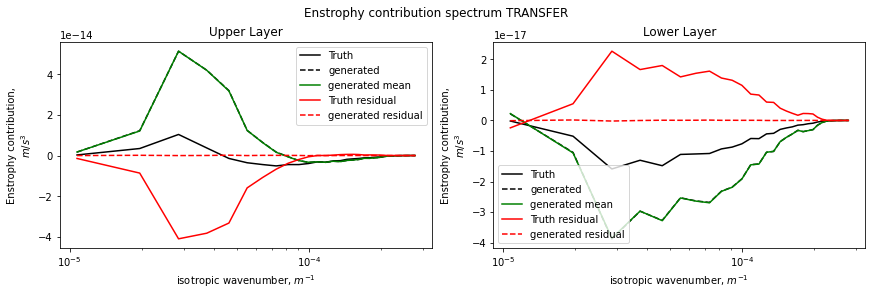

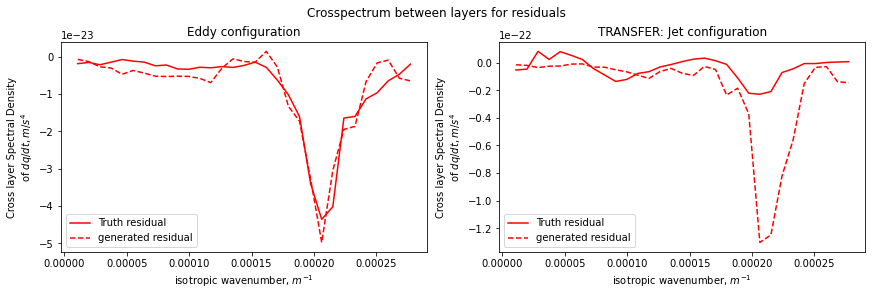

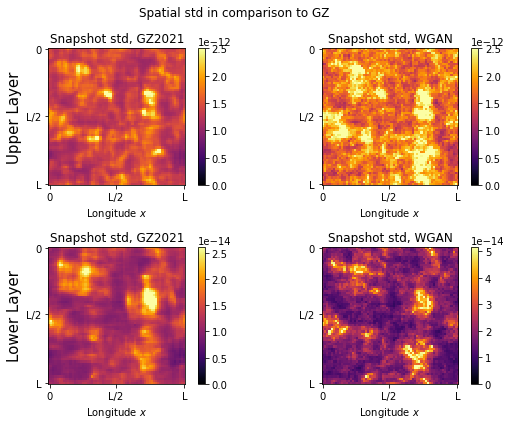

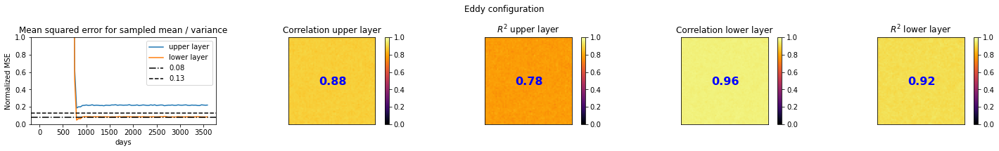

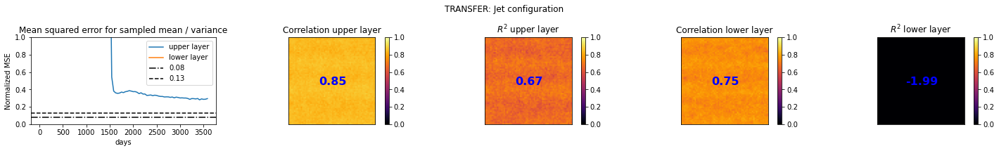

In [55]:
overview_experiment('EXP12', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 1.0, 'pretrain': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.521,0.513,1.553]
   L2_q:       [0.344,0.341,9.982]
        L2_dq: [0.640,0.650,0.986]
L2+L2_q+L2_dq: [1.505,1.505,12.521]


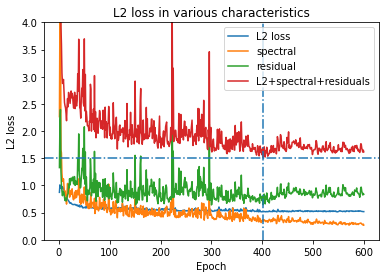

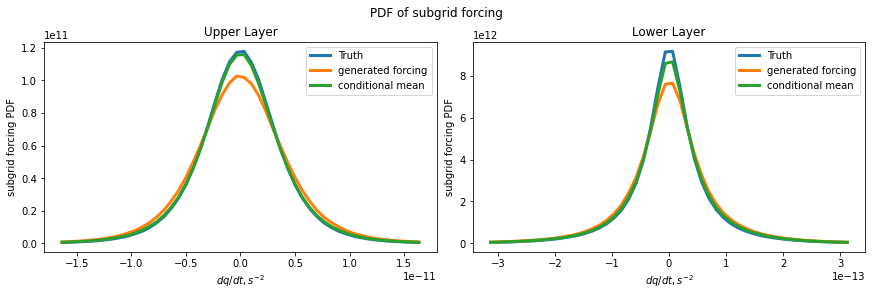

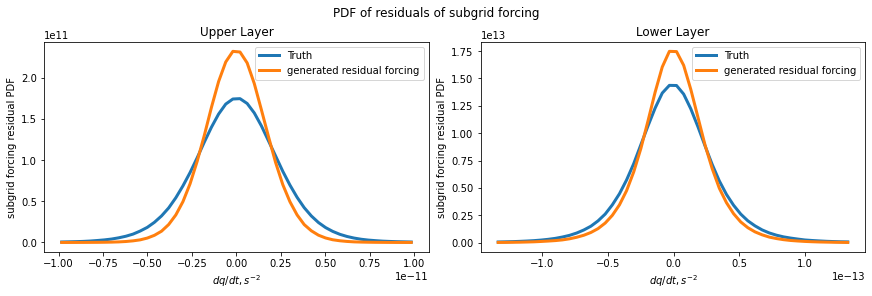

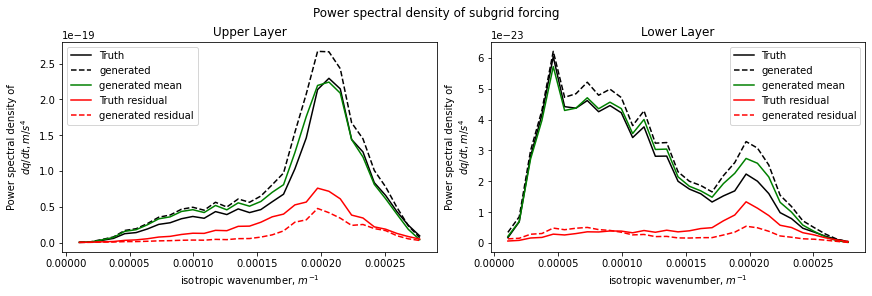

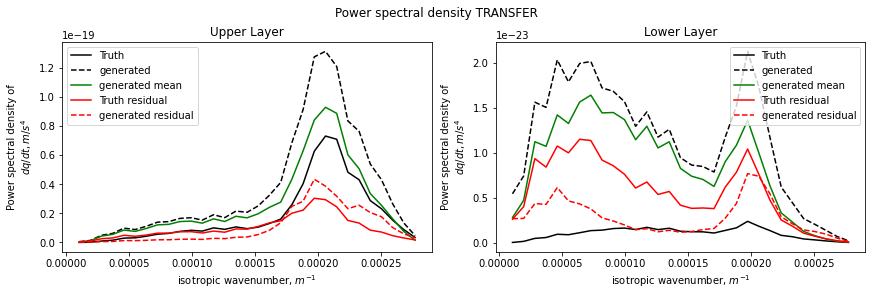

...

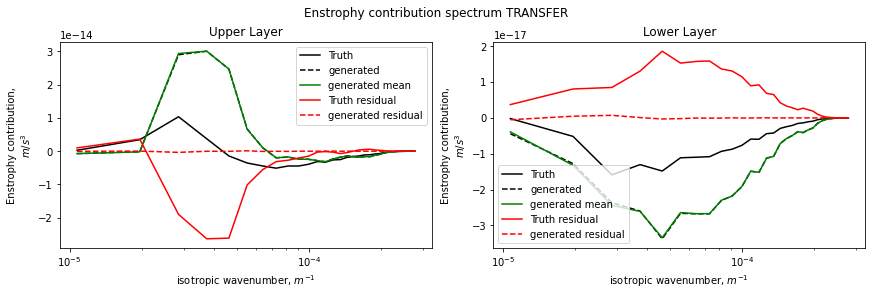

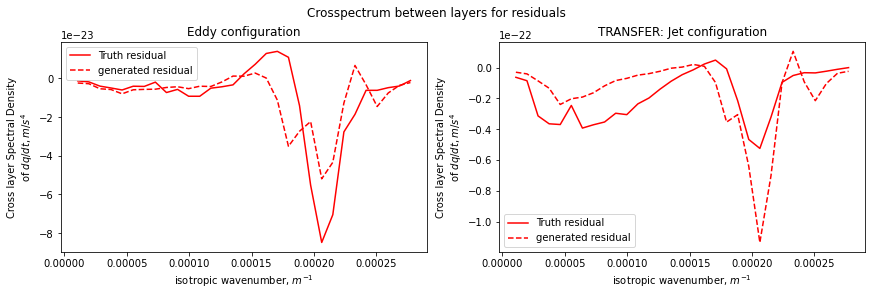

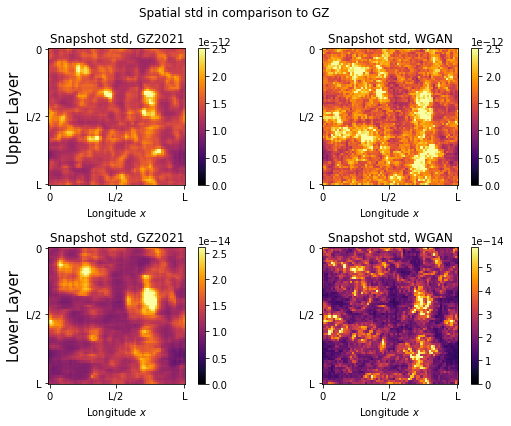

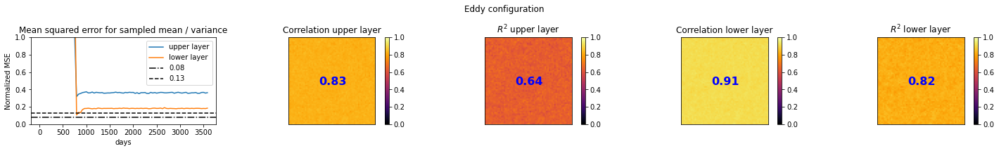

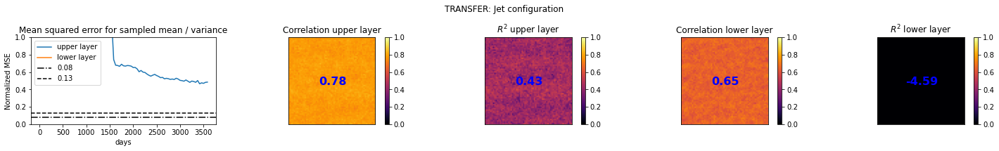

In [56]:
overview_experiment('EXP13', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 10.0, 'pretrain': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.400,0.397,1.492]
   L2_q:       [0.229,0.228,19.280]
        L2_dq: [0.760,0.773,0.998]
L2+L2_q+L2_dq: [1.389,1.397,21.769]


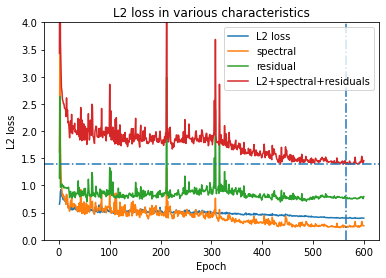

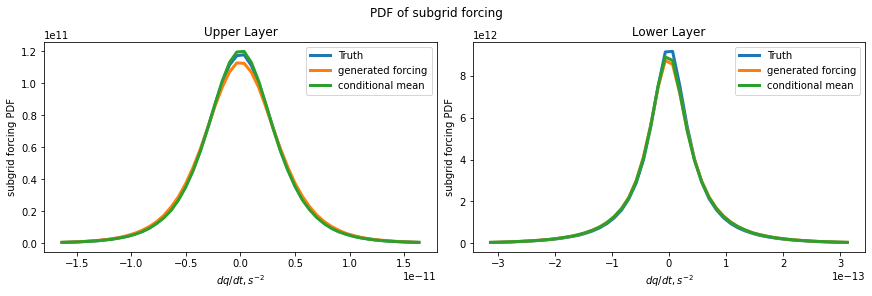

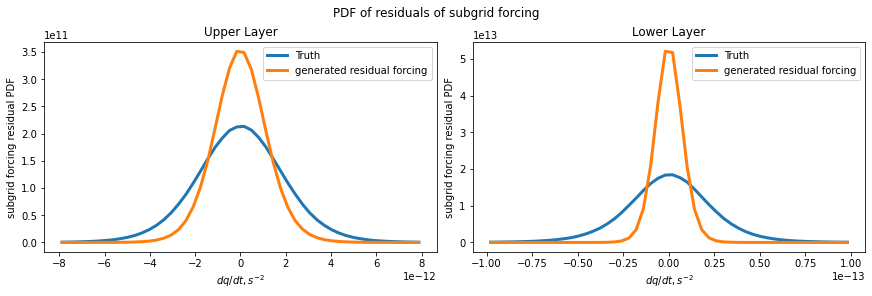

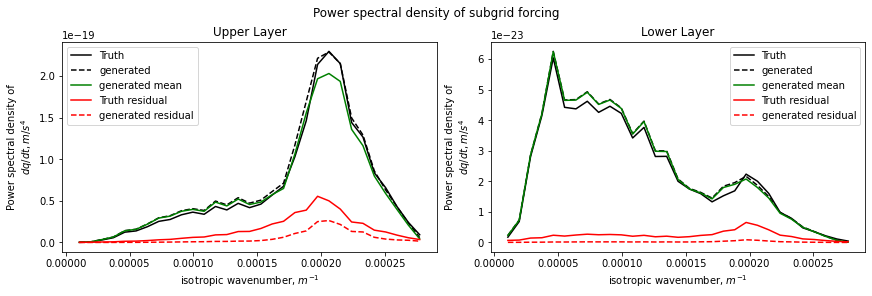

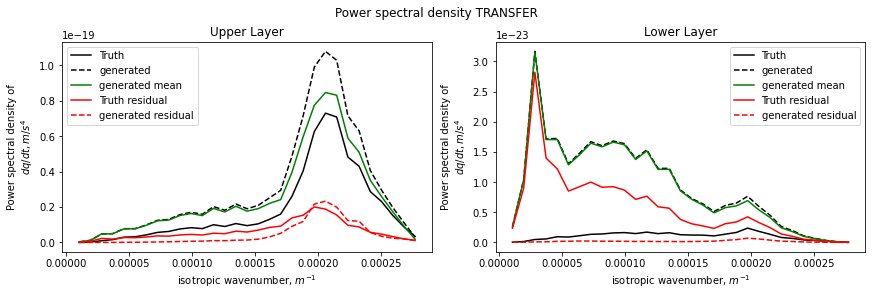

...

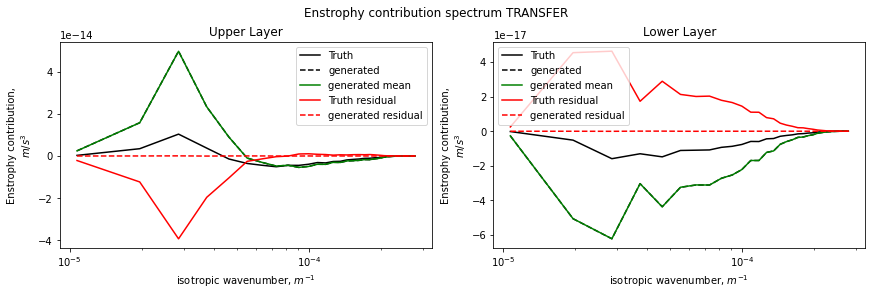

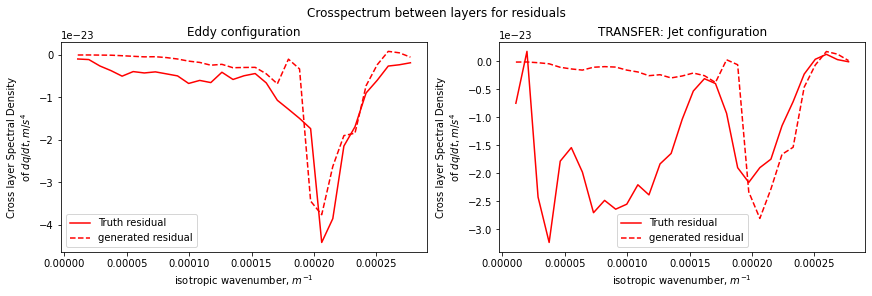

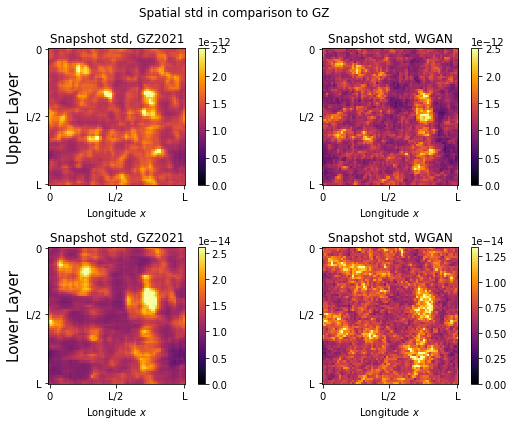

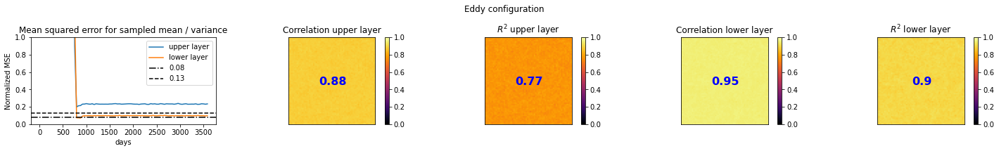

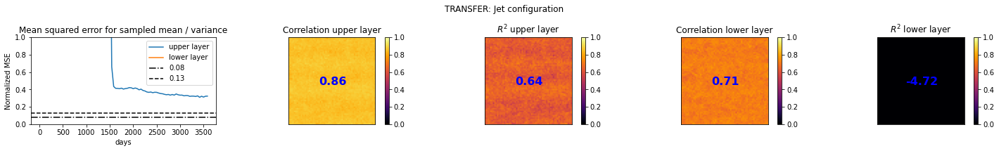

In [57]:
overview_experiment('EXP14', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'residual': 0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'lambda_MSE_two_layer': 0.0, 'pretrain': 1, 'num_epochs': 600, 'ensemble_size': 100} 

               [valid,test ,trans]:
L2:            [0.398,0.389,1.018]
   L2_q:       [0.154,0.154,6.391]
        L2_dq: [0.498,0.550,1.964]
L2+L2_q+L2_dq: [1.050,1.092,9.373]


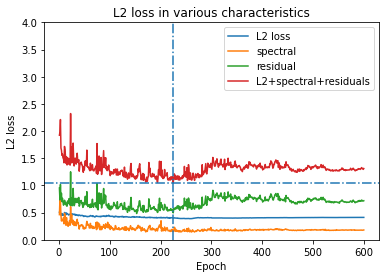

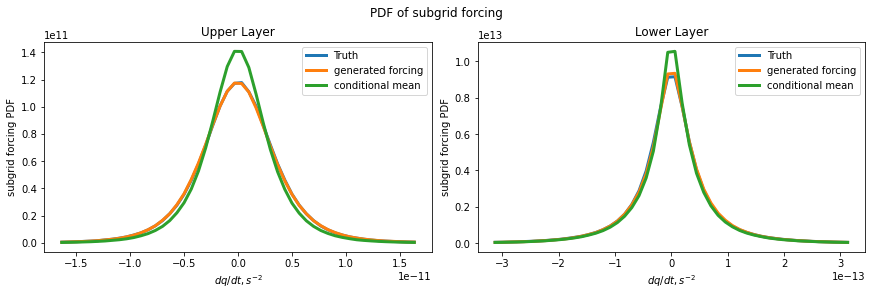

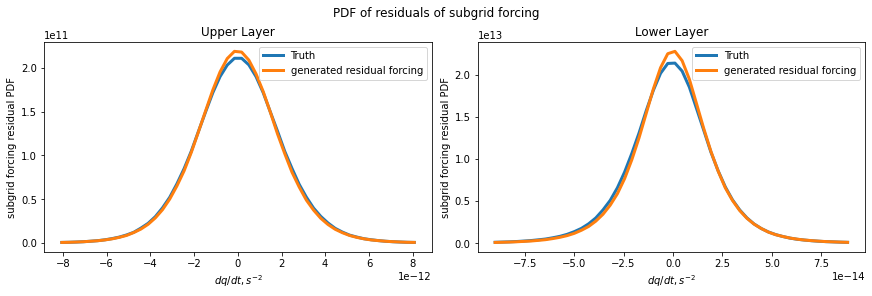

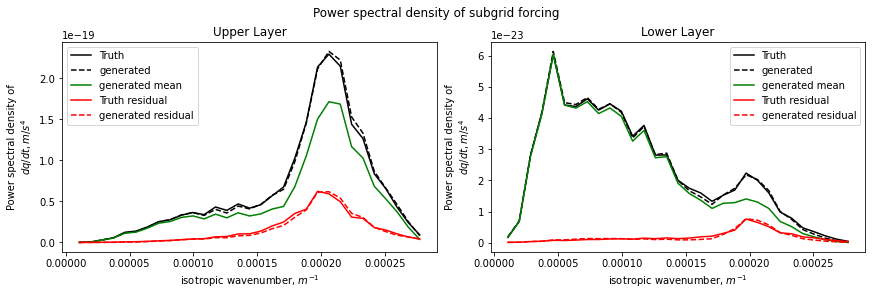

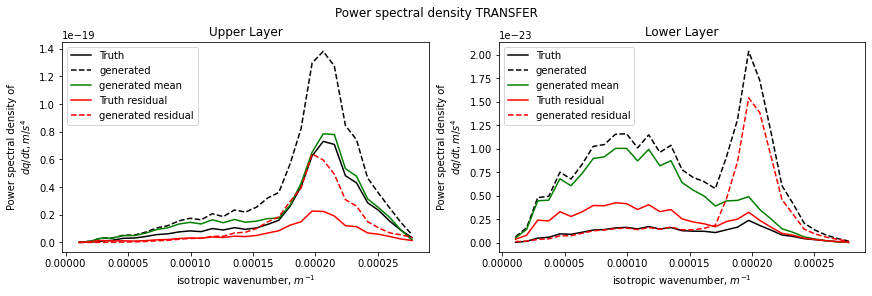

...

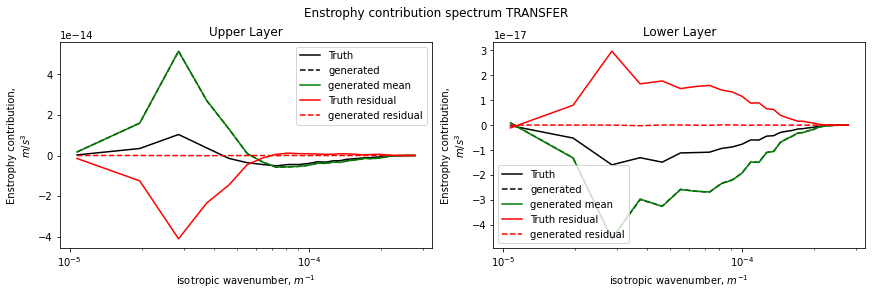

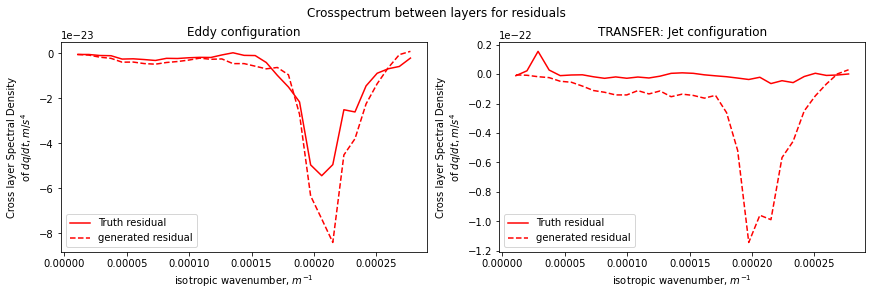

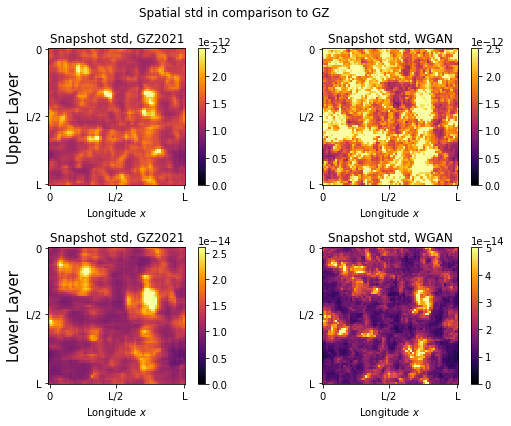

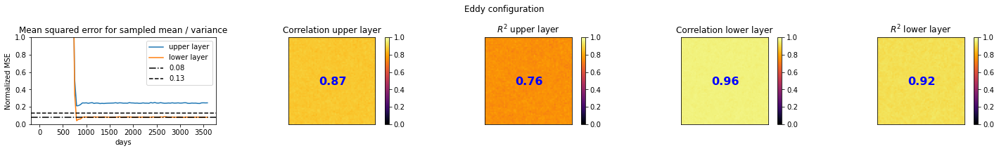

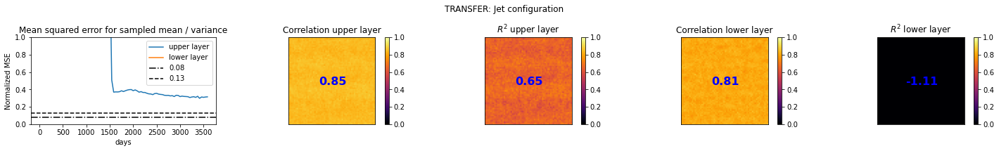

In [58]:
overview_experiment('EXP15', folder='/scratch/pp2681/pyqg_NN/CGAN_regularizations/')

# Regression cGAN

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'GAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'ncritic': 1, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'regression': 1, 'num_epochs': 100, 'ensemble_size': 50} 

               [valid,test ,trans]:
L2:            [0.268,0.264,0.857]
   L2_q:       [0.186,0.185,3.441]
        L2_dq: [0.744,0.811,2.415]
L2+L2_q+L2_dq: [1.199,1.260,6.713]


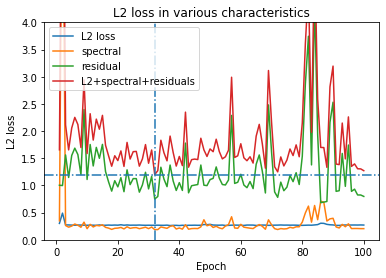

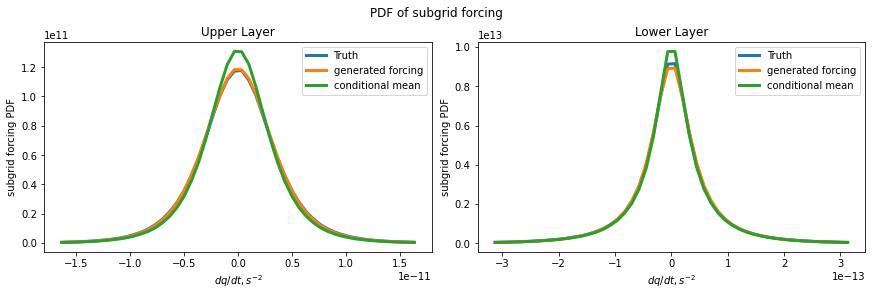

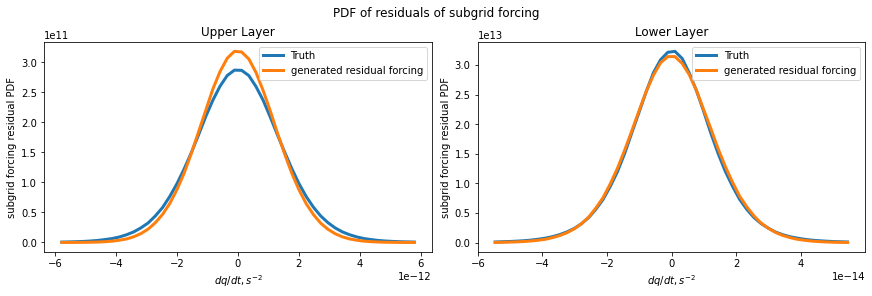

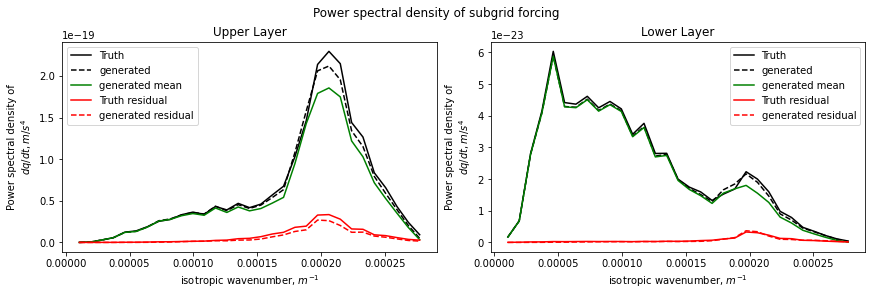

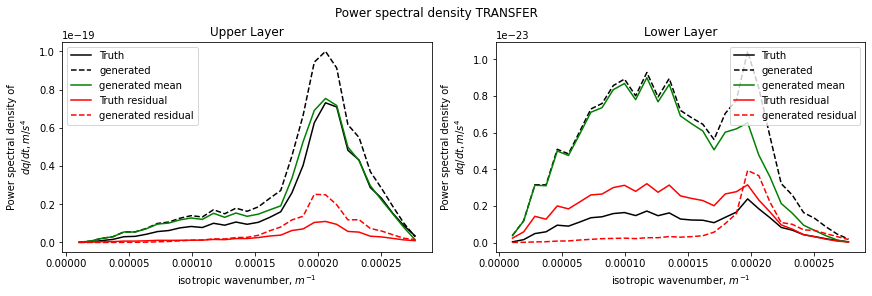

...

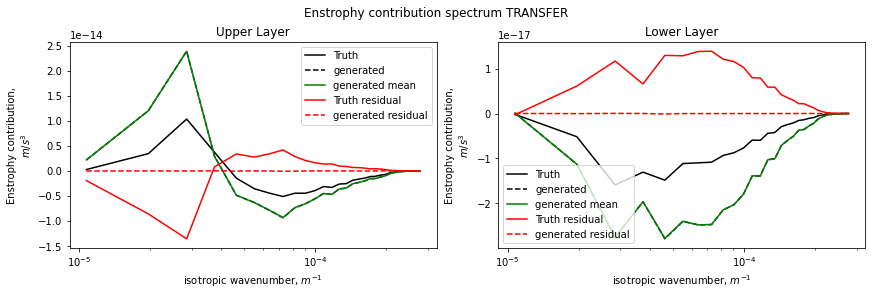

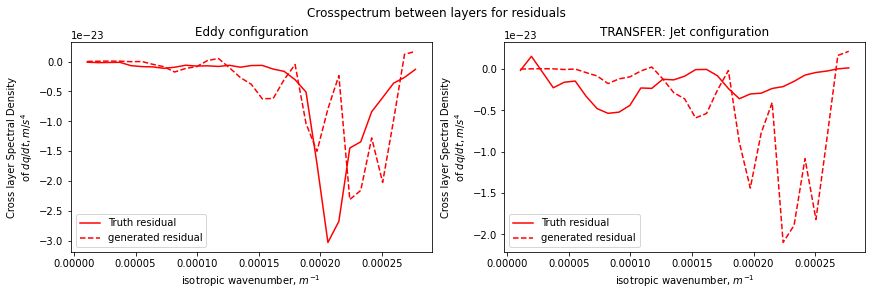

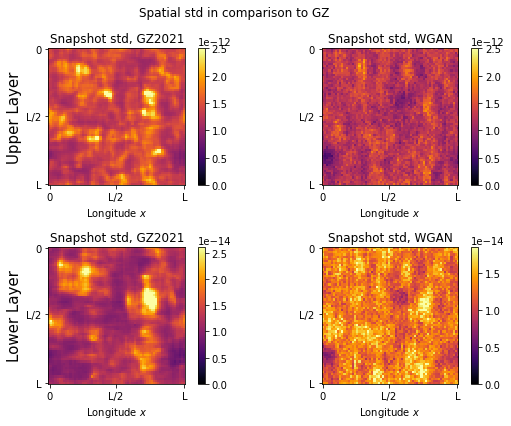

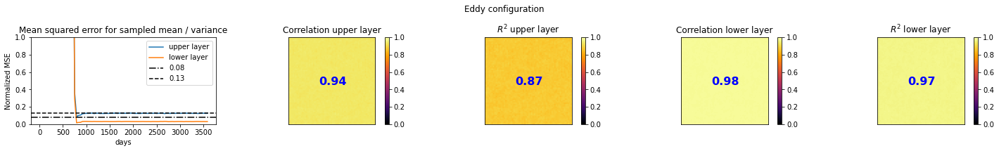

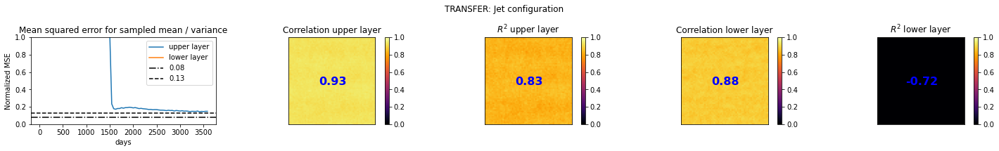

In [59]:
overview_experiment('EXP0', folder='/scratch/pp2681/pyqg_NN/CGAN_regression/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'regression': 1, 'num_epochs': 100, 'ensemble_size': 50} 

               [valid,test ,trans]:
L2:            [0.271,0.266,1.308]
   L2_q:       [0.143,0.142,184.670]
        L2_dq: [0.423,0.457,1.069]
L2+L2_q+L2_dq: [0.837,0.865,187.047]


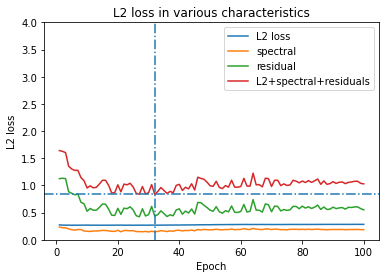

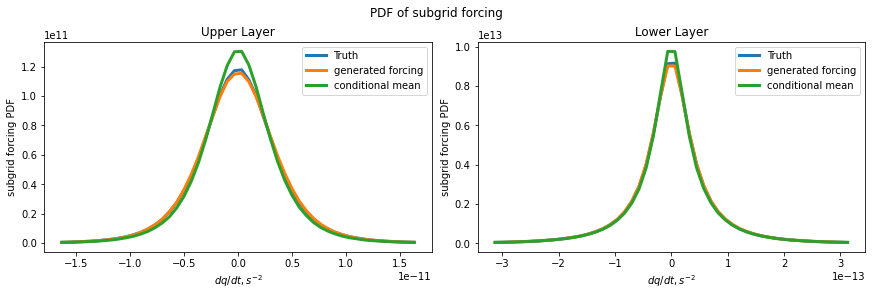

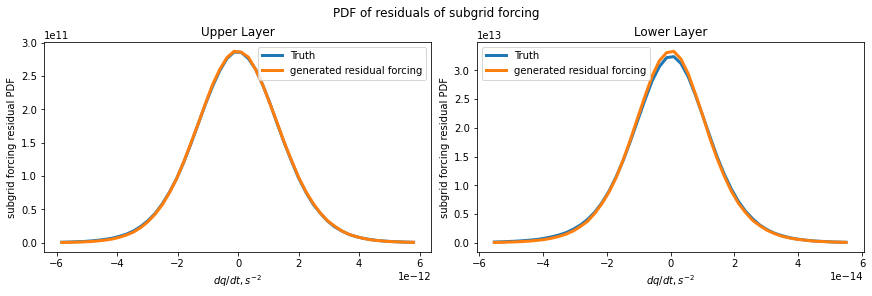

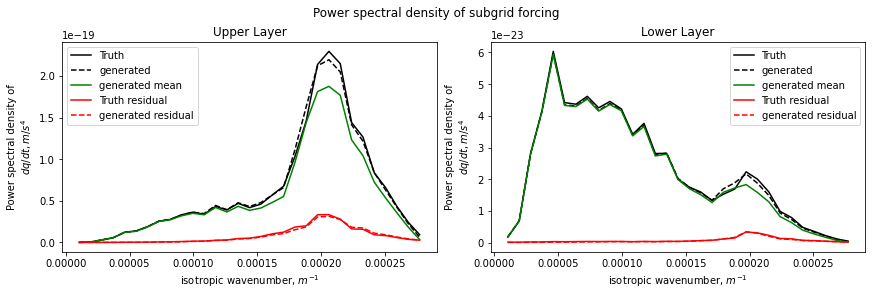

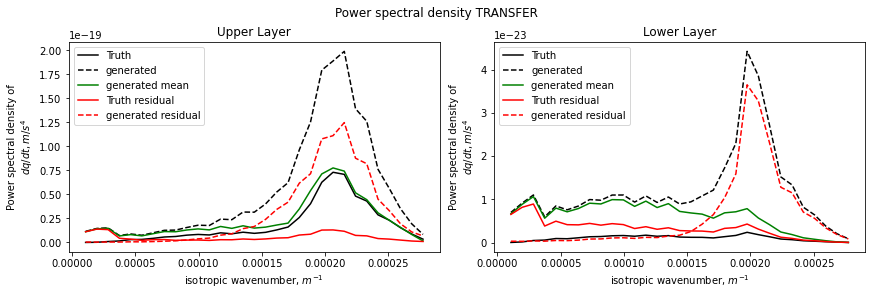

...

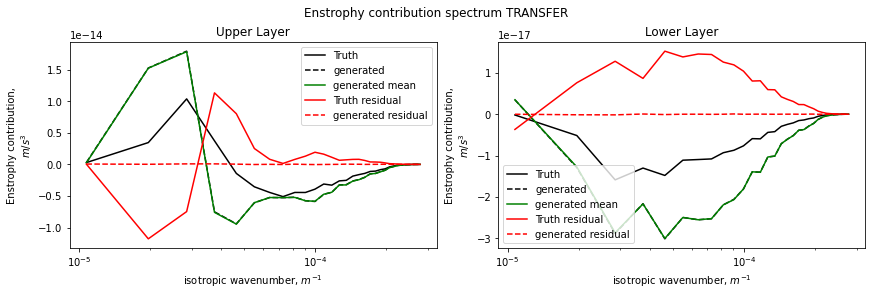

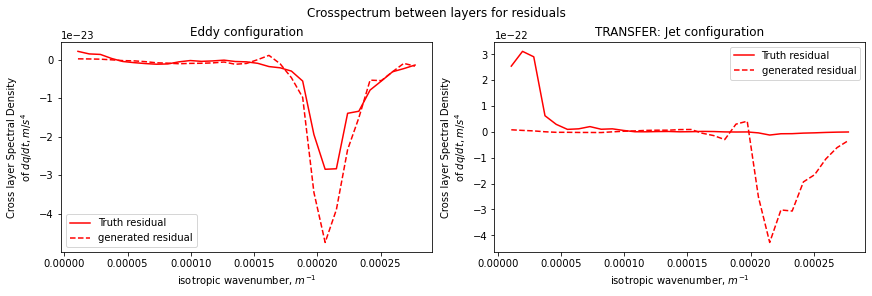

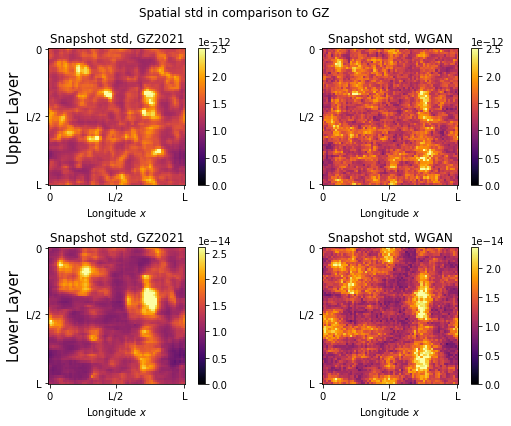

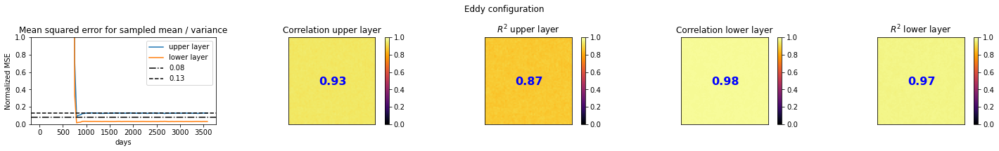

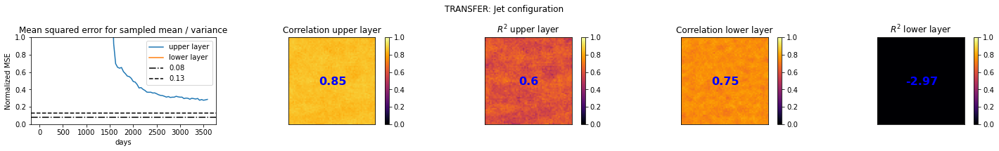

In [60]:
overview_experiment('EXP1', folder='/scratch/pp2681/pyqg_NN/CGAN_regression/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'regression': 1, 'num_epochs': 100, 'ensemble_size': 50} 

               [valid,test ,trans]:
L2:            [0.269,0.264,0.923]
   L2_q:       [0.144,0.148,8.402]
        L2_dq: [0.433,0.454,4.474]
L2+L2_q+L2_dq: [0.846,0.865,13.798]


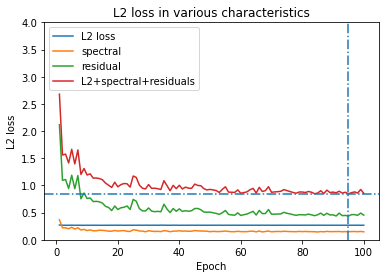

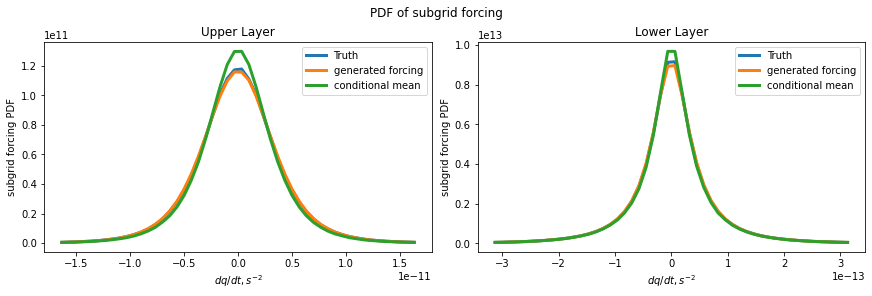

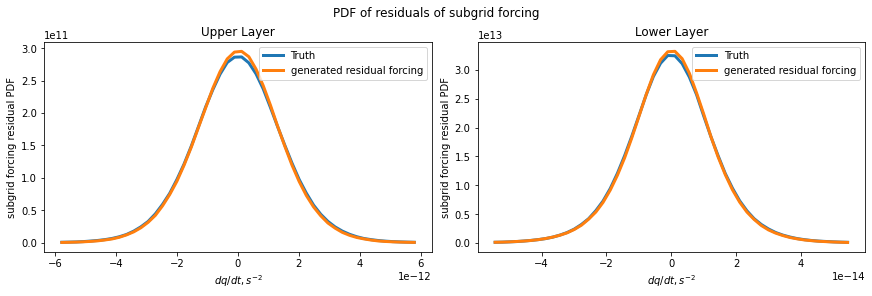

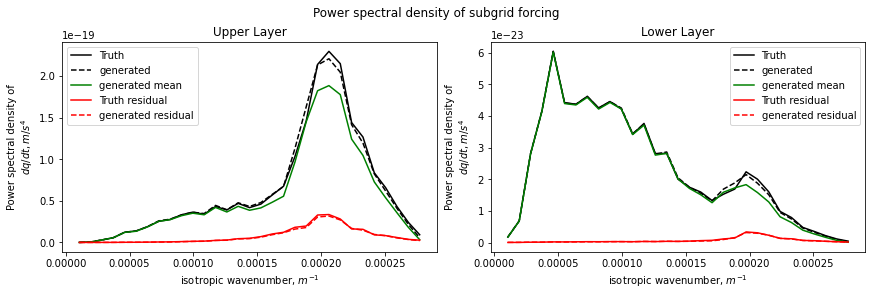

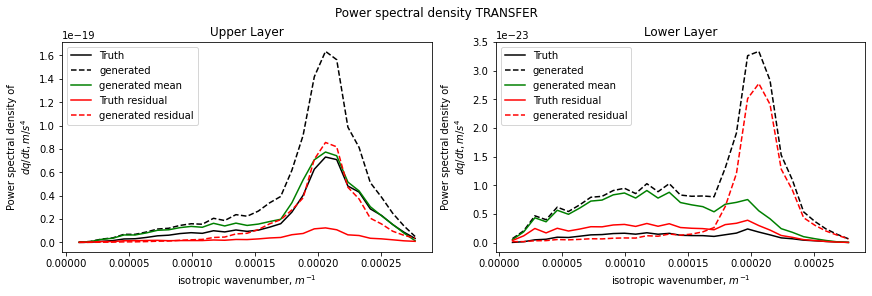

...

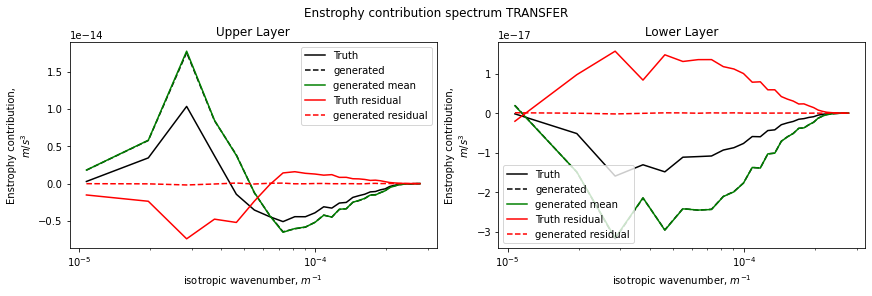

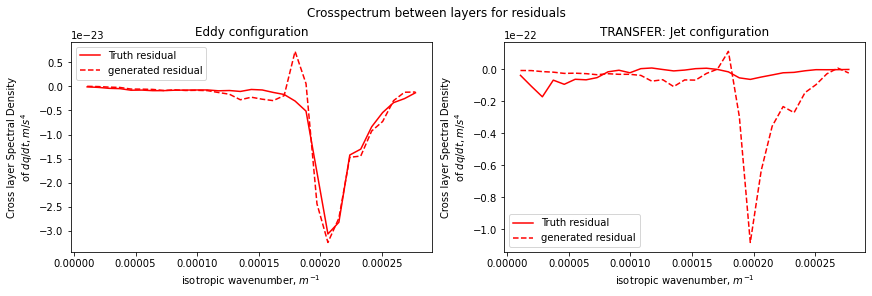

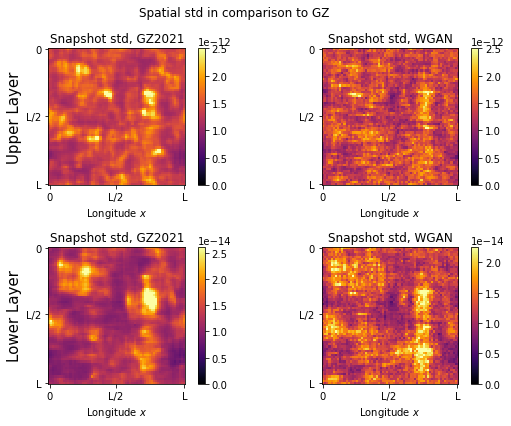

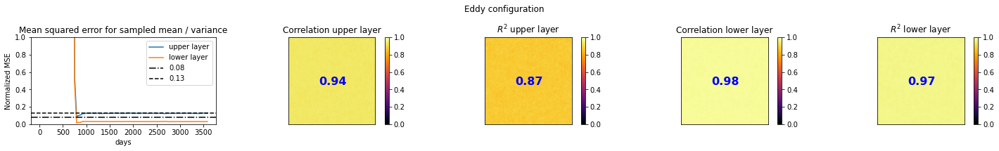

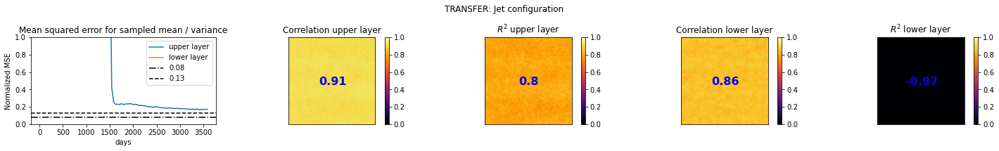

In [61]:
overview_experiment('EXP2', folder='/scratch/pp2681/pyqg_NN/CGAN_regression/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 1, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'regression': 1, 'num_epochs': 100, 'ensemble_size': 50} 

               [valid,test ,trans]:
L2:            [0.360,0.358,0.976]
   L2_q:       [0.192,0.191,2.311]
        L2_dq: [1.000,1.000,1.000]
L2+L2_q+L2_dq: [1.551,1.550,4.287]


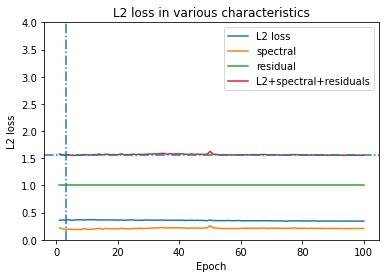

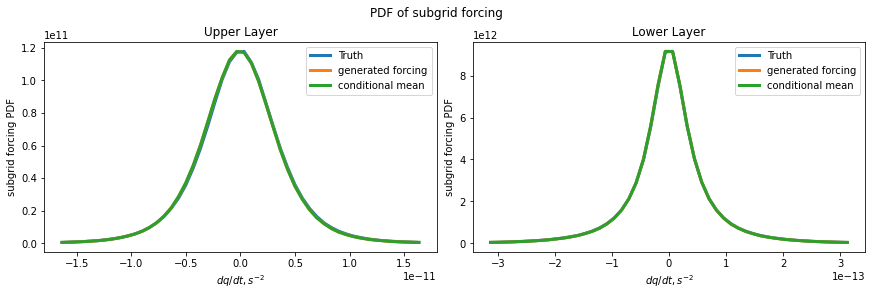

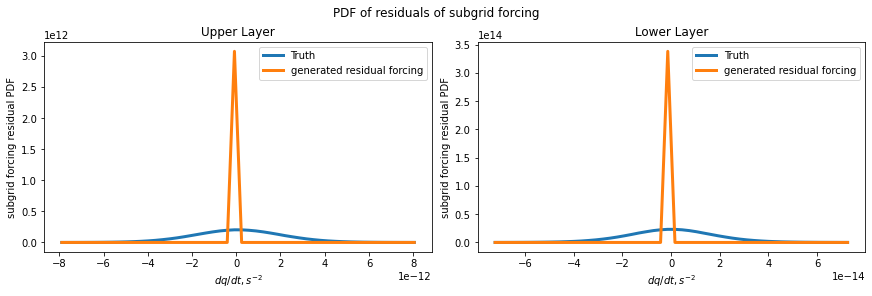

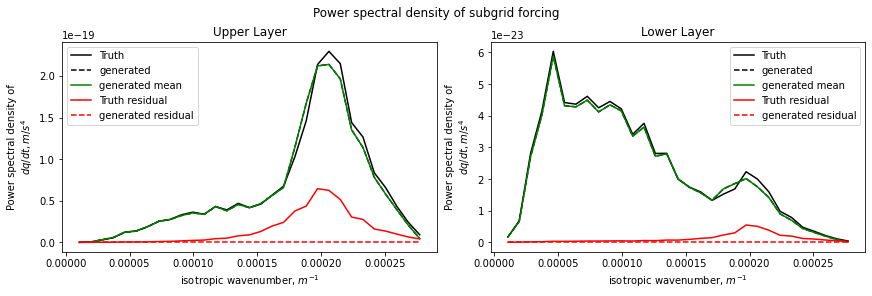

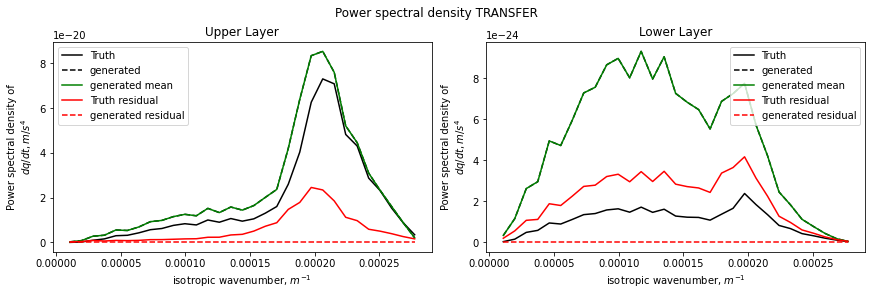

...

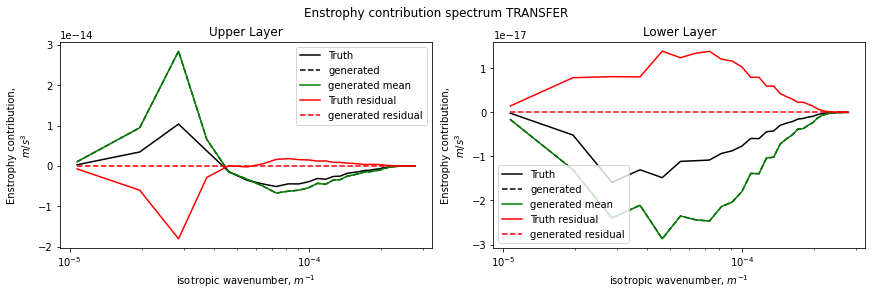

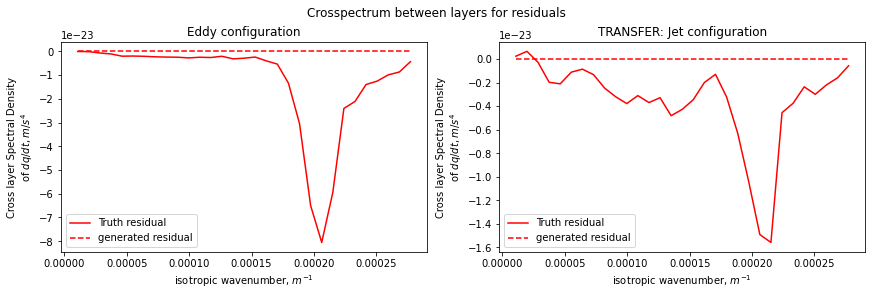

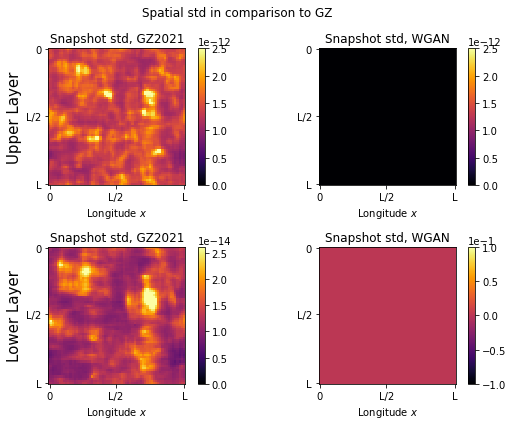

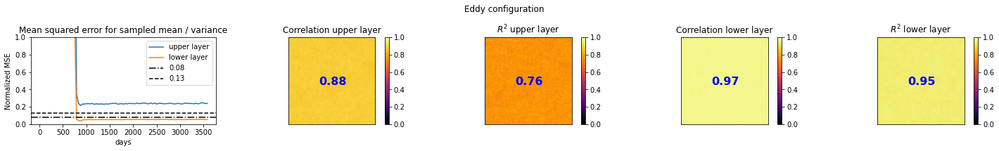

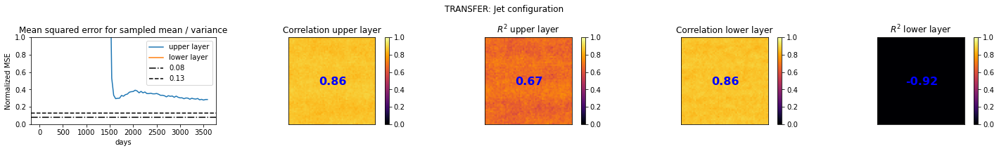

In [62]:
overview_experiment('EXP3', folder='/scratch/pp2681/pyqg_NN/CGAN_regression/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'GAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'ncritic': 1, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'regression': 1, 'num_epochs': 100, 'ensemble_size': 50} 

               [valid,test ,trans]:
L2:            [0.270,0.265,0.865]
   L2_q:       [0.170,0.170,2.632]
        L2_dq: [0.602,0.629,1.453]
L2+L2_q+L2_dq: [1.041,1.064,4.950]


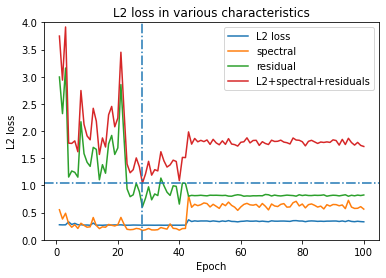

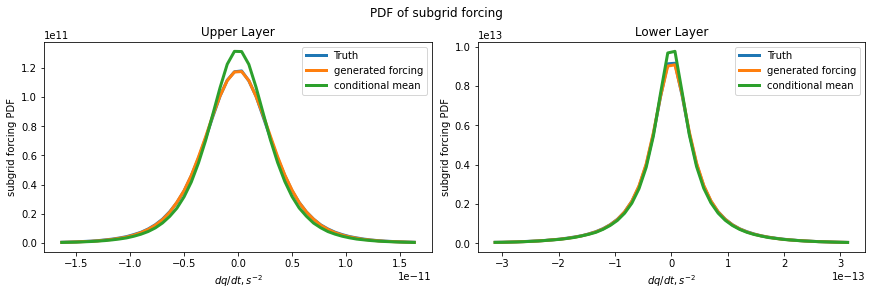

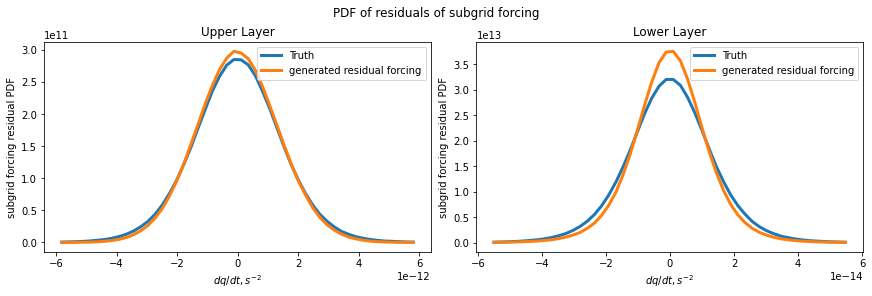

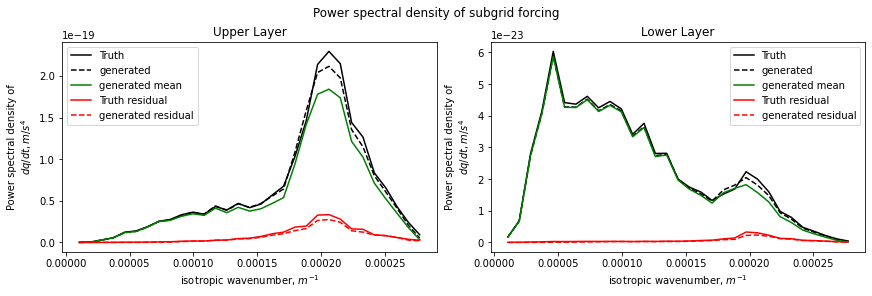

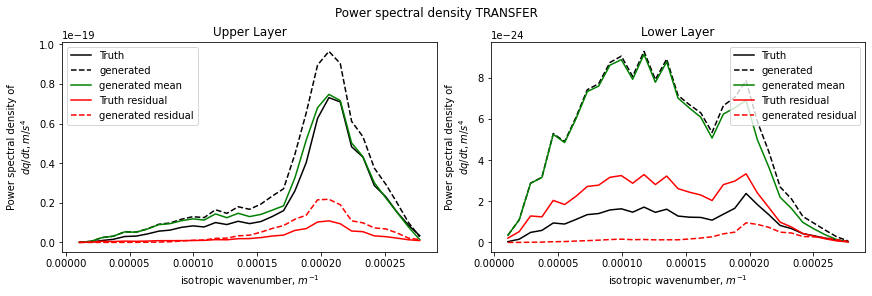

...

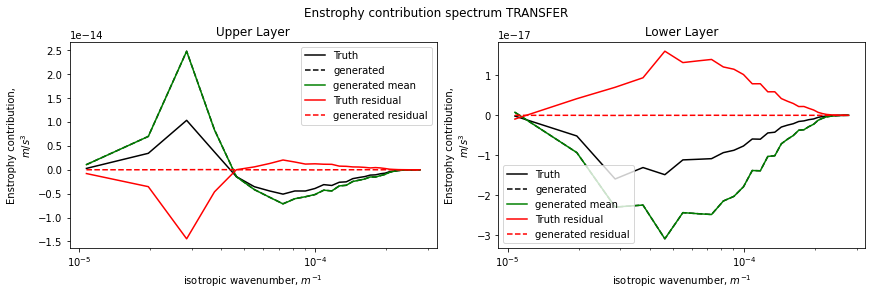

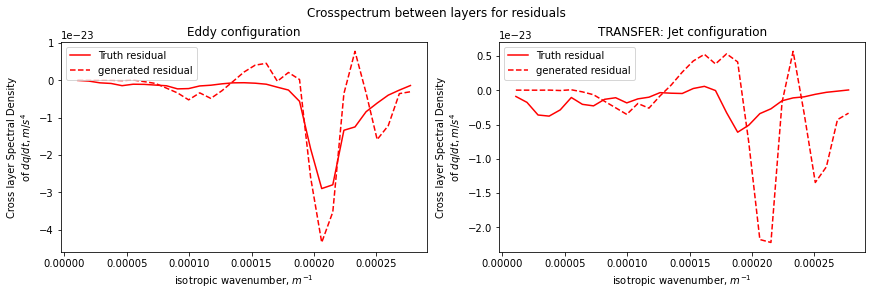

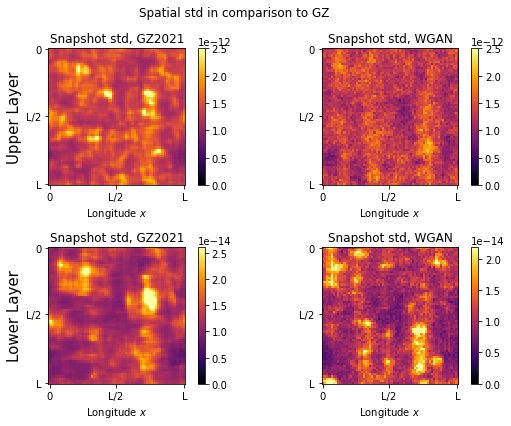

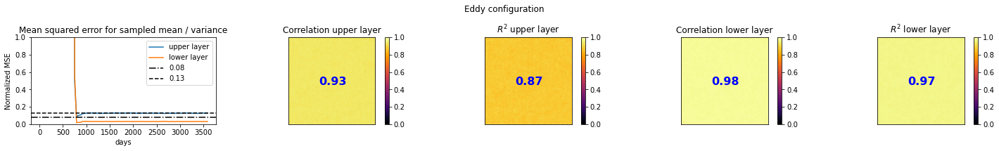

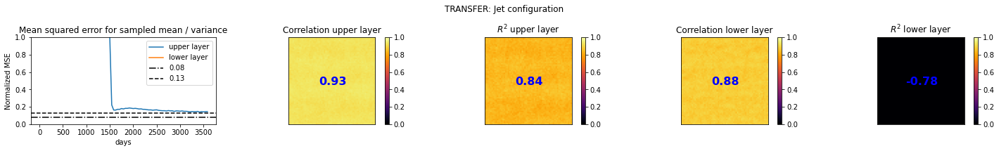

In [63]:
overview_experiment('EXP4', folder='/scratch/pp2681/pyqg_NN/CGAN_regression/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 0, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'regression': 1, 'num_epochs': 100, 'ensemble_size': 50} 

               [valid,test ,trans]:
L2:            [0.272,0.267,1.001]
   L2_q:       [0.149,0.149,15.326]
        L2_dq: [0.422,0.438,2.561]
L2+L2_q+L2_dq: [0.842,0.853,18.888]


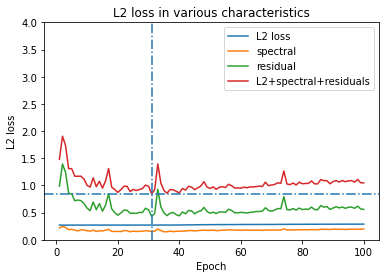

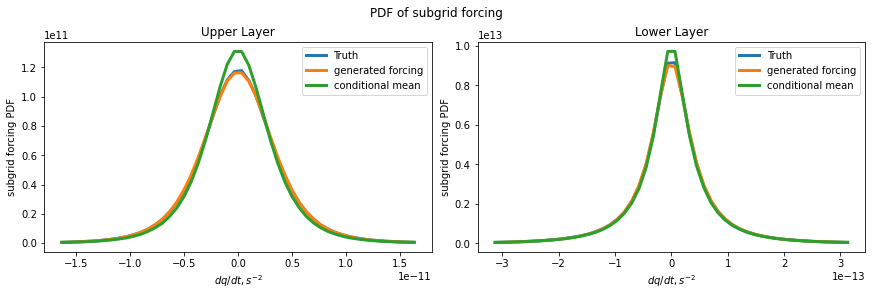

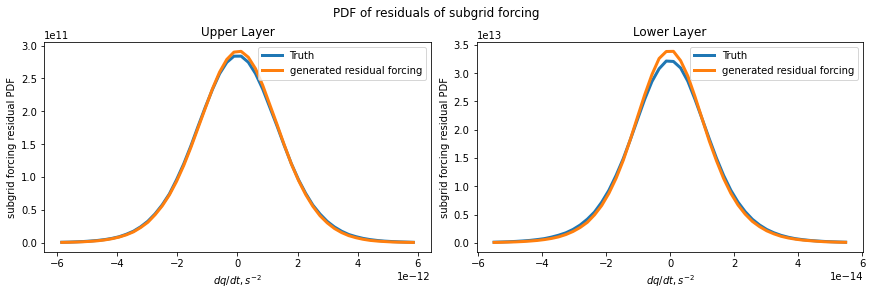

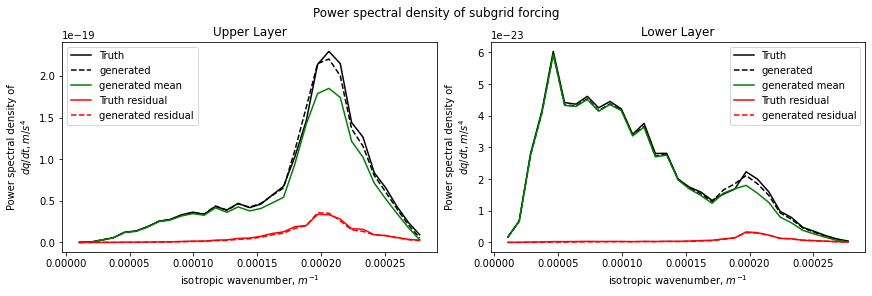

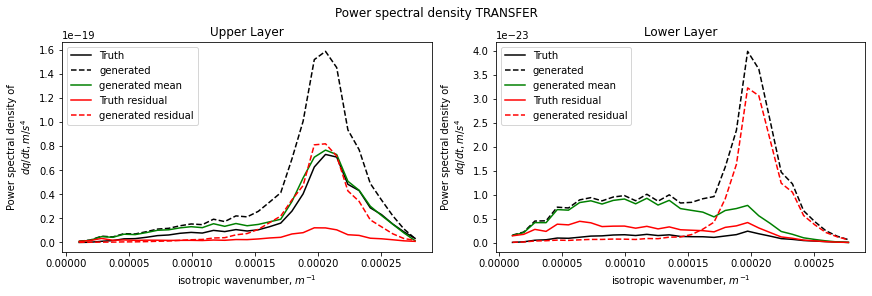

...

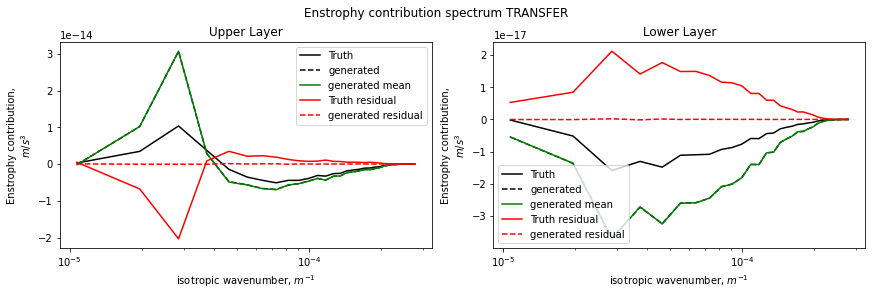

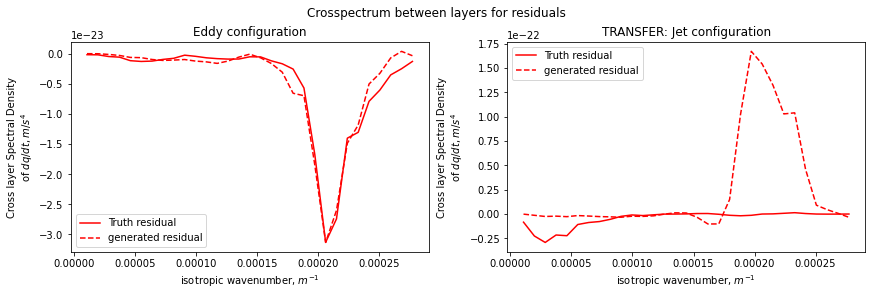

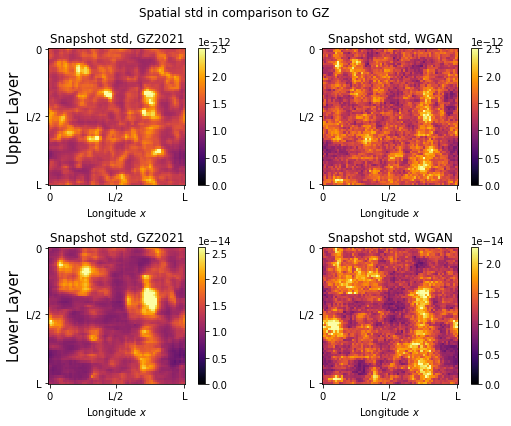

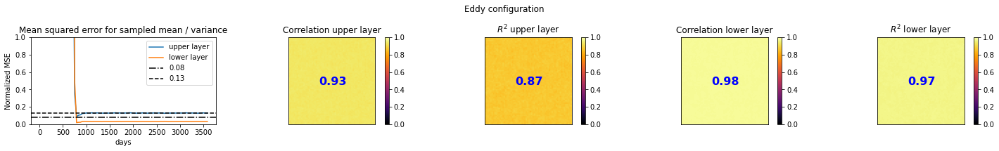

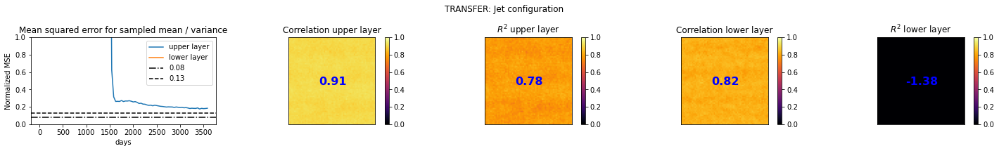

In [64]:
overview_experiment('EXP5', folder='/scratch/pp2681/pyqg_NN/CGAN_regression/')

Experiment parameters:
{'n_latent': 2, 'minibatch_discrimination': 1, 'deterministic': 0, 'loss_type': 'WGAN', 'lambda_MSE_mean': 0.0, 'lambda_MSE_sample': 0.0, 'ncritic': 5, 'training': 'DCGAN', 'generator': 'Andrew', 'discriminator': 'DCGAN', 'bn': 'None', 'GP_shuffle': 1, 'regression': 1, 'num_epochs': 100, 'ensemble_size': 50} 

               [valid,test ,trans]:
L2:            [0.270,0.265,0.954]
   L2_q:       [0.151,0.152,11.621]
        L2_dq: [0.433,0.440,4.877]
L2+L2_q+L2_dq: [0.854,0.857,17.451]


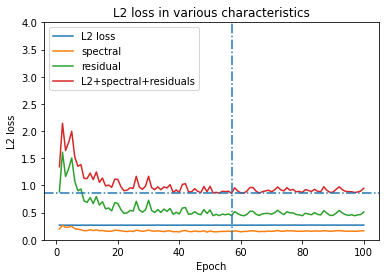

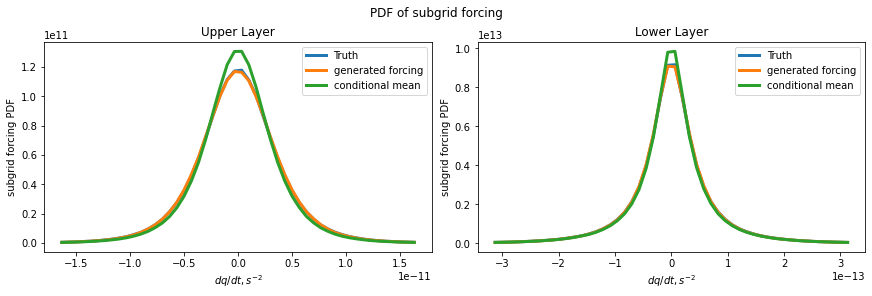

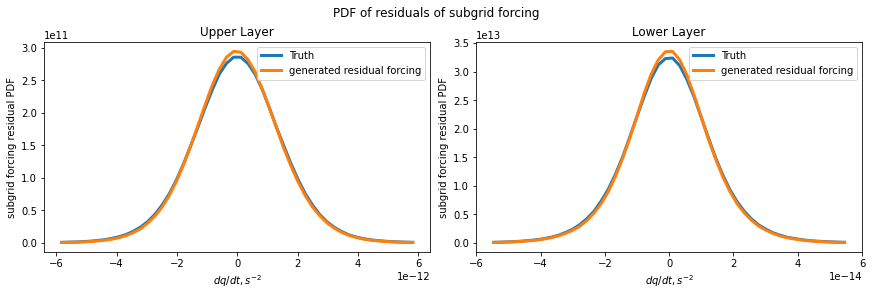

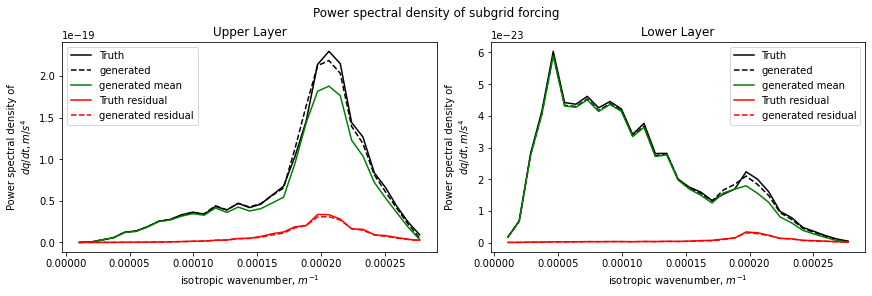

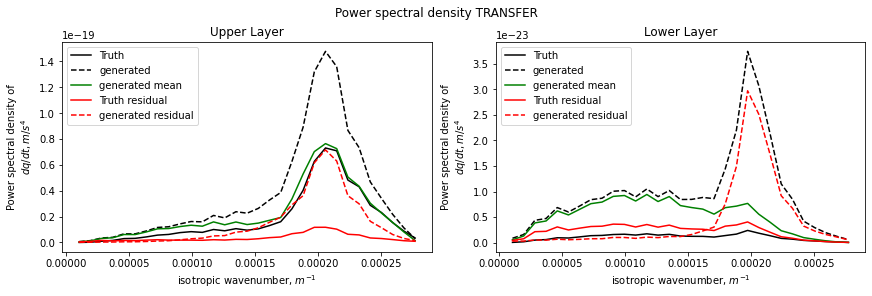

...

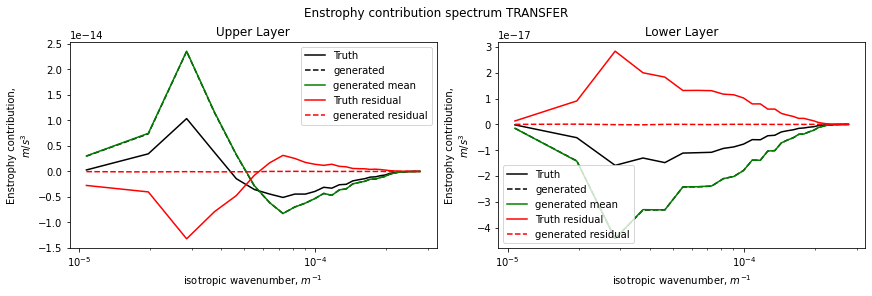

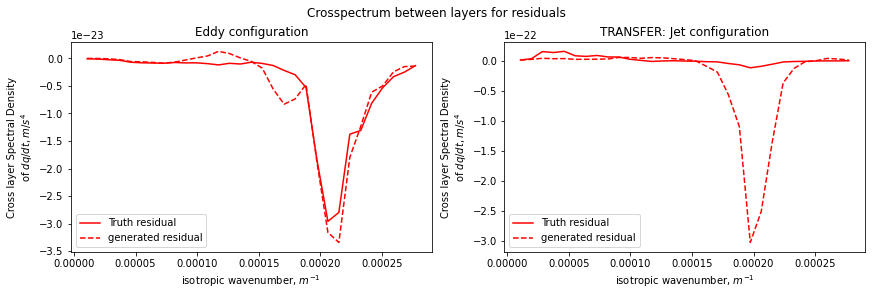

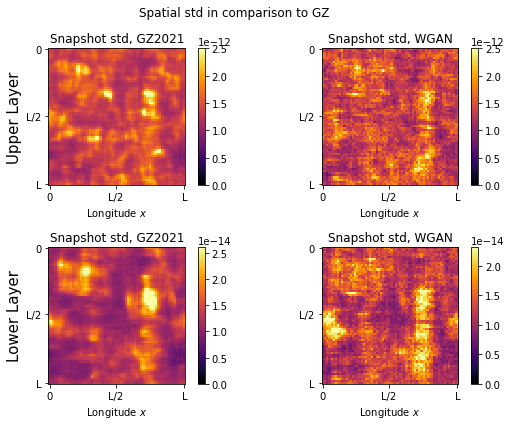

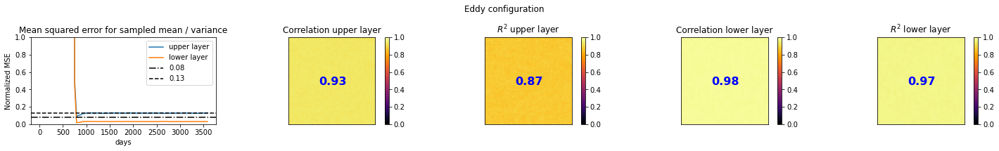

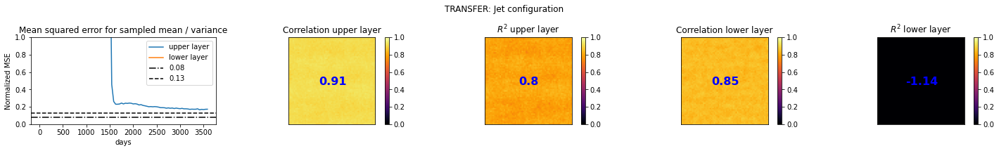

In [65]:
overview_experiment('EXP6', folder='/scratch/pp2681/pyqg_NN/CGAN_regression/')